In [1]:
##################################
### Import the usual libraries ###
##################################

### Other
import warnings
warnings.filterwarnings('ignore')

### Matplotlib
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.rcParams.update({'font.size': 20})

from tqdm import tqdm_notebook

import numpy as np
import astropy
from astropy.io import fits
from astropy.table import Table
from scipy.interpolate import InterpolatedUnivariateSpline
import extinction as extinction

def mad(dat): #median absolute deviation
    return np.median(np.absolute(dat - np.median(dat)))

In [2]:


# class WhatsMyAgeAgain():
#     '''
#     Class to calculate a star's age and extinction using PARSEC isochrones and extinction law
#     from Cardelli et al. 1989
#     '''
#     def __init__(self,feh,am,distance,isochrones):
        
#         '''
#         feh: [float] metallicity of star
#         am: [float] [$\alpha$/M] of star
#         distance: [float] distance to star in pc
#         isochrones: [astropy Table] PARSEC isochrone table
#         '''
        
#         # stellar parameters
#         self.salfeh = feh+np.log10(0.638*(10**am)+0.362) #Salaris et al. 1993
#         self.dist = distance
        
#         # PARSEC isochrones
#         self.jlabel = 'Jmag'
#         self.hlabel = 'Hmag'
#         self.klabel = 'Ksmag'
#         self.uniq_ages = 10**np.unique(isochrones['logAge'])/10**9
#         #where state on metallicity and keep on those point
# #         self.iso = isochrones
        
#         self.iso = isochrones[np.where(isochrones['MH']==self.closest(isochrones['MH'],self.salfeh))]
#         #here keep array of all unique ages and starting and ending isochrones idx for each age
        
        
#         # Effective Wavelengths of different passbands
#         self.leff = {'BP':0.5387,'G':0.6419,'RP':0.7667,'J':1.2345,'H':1.6393,'K':2.1757} # mircons
        
#     def closest(self,data,value):
#         '''
#         Find nearest value in array to given value
        
#         Inputs:
#         ------
#             data: data to search through 
#             value: value of interest
#         '''
        
#         data = np.asarray(data)
    
#         return data[(np.abs(np.subtract(data,value))).argmin()]
    
#     def neighbors(self,data,value):
#         '''
#         Find values of two elements closest to the given value
    
#         Inputs:
#         ------
#             data: data to search through 
#             value: value of interest
        
#         Output:
#         ------
#             close1: closest value under the given value
#             close2: closest value over the given value
#         '''
    
#         data = np.asarray(data)
#         close1 = data[(np.abs(np.subtract(data,value))).argmin()]
#         data = data[np.where(data!=close1)]
#         close2 = data[(np.abs(np.subtract(data,value))).argmin()]
    
#         return close1,close2
    
#     def cardelli_a(self,x):
#         '''
#         a(x) function from Cardelli et al. 1989
    
#         Input:
#         -----
#             x: effective wavelength in units of 1/micron
        
#         Output:
#         ------
#             a: a function value  
#         '''
#         if 0.3 <= x < 1.1:
#             a = 0.574*(x**1.61)
#             return a
    
#         elif 1.1 <= x < 3.3:
#             y = x - 1.82
#             a = (1.+0.17699*y-0.50477*(y**2)-0.02427*(y**3)+0.72085*(y**4)+
#                  0.01979*(y**5)-0.77530*(y**6)+0.32999*(y**7))
#             return a
    
#         elif 3.3 <= x < 8.0:
#             if x < 5.9:
#                 a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)
#                 return a
        
#             else:
#                 fa = -0.04473*((x-5.9)**2)+0.1207*((x-5.9)**3)
#                 a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)+fa
#                 return a       
    
#     def cardelli_b(self,x):
#         '''
#         b(x) function from Cardelli et al. 1989
    
#         Input:
#         -----
#             x: effective wavelength in units of 1/micron
        
#         Output:
#         ------
#             b: b function value 
#         '''
#         if 0.3 <= x < 1.1:
#             b = -0.527*(x**1.61)
#             return b
    
#         elif 1.1 <= x <= 3.3:
#             y = x - 1.82
#             b = (1.41338*y+2.28305*(y**2)+1.07233*(y**3)-5.38434*(y**4)-
#                  0.62251*(y**5)+5.30260*(y**6)-2.09002*(y**7))
#             return b
    
#         elif 3.3 <= x < 8.0:
#             if x < 5.9:
#                 b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)
#                 return b
        
#             else:
#                 fb = 0.2130*((x-5.9)**2)+0.1207*((x-5.9)**3)
#                 b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)+fb
#                 return b
    
#     def cardelli_alav(self,wave,rv):
#         '''
#         Calculate A\lambda/Av
    
#         Inputs:
#         ------
#             wave: effective wavelength in units of micron
#             rv: Rv value (=Av/E(B_V))
        
#         Output:
#         ------
#             alav: A\lambda/Av
#         '''
#         x=1/wave
#         alav = self.cardelli_a(x)+self.cardelli_b(x)/rv
#         return alav
        
#     def InitialAge(self,teff,kmag,ak):
#         '''
#         Calculate an initial guess for the age of a star
        
#         Inputs:
#         ------
#             teff: temperature of a star
#             kmag: K magnitude of a star
#             ak: the extinction in the 2MASS K band
        
#         Output:
#         ------
#             age_guess: initial guess for age
        
#         '''
        
#         iso_ = self.iso[np.where(self.iso['MH']==self.closest(self.iso['MH'],self.salfeh))]
        
#         euc_sq = (np.subtract(iso_['Ksmag'],kmag-ak-5*np.log10(self.dist)+5.)**2+
#                   np.subtract(10**iso_['logTe'],teff)**2)
        
#         age_guess = np.median(10**iso_['logAge'][euc_sq.argmin()]/10**9)
        
#         print(iso_['Ksmag'][euc_sq.argmin()])
#         print(10**iso_['logTe'][euc_sq.argmin()])
        
#         return age_guess    
        
#     def Teff2AppMags(self,teff,age,ak):
#         '''
#         Calculate the expected apparent magnitude of a star
        
#         Inputs:
#         ------
#             teff: temperature of star
#             age: age of star
#             ak: extinction in the 2MASS K band
            
#             # parameters defined in __init__
#             self.dist: distance to star
#             self.iso: set of PARSEC isochrones
        
#         Output:
#         ------
#             calc_mag: expected intrinsic magnitude for the given temperature
#         '''
        
#         lgteff = np.log10(teff)
        
#         ajak = self.cardelli_alav(self.leff['J'],3.1)/self.cardelli_alav(self.leff['K'],3.1)
#         ahak = self.cardelli_alav(self.leff['H'],3.1)/self.cardelli_alav(self.leff['K'],3.1)
        
#         # Figure out if age is actually in the ages given in the isochrone table
#         if age in self.uniq_ages:
            
# #             print('in: ',age)
            
#             # pick out a single isochrone 
#             iso_ = self.iso[np.where(self.iso['logAge']==self.closest(self.iso['logAge'],np.log10(age*10**9)))]
            
#             if lgteff < min(iso_['logTe']) or lgteff > max(iso_['logTe']):
#                 return 999999.0, 999999.0, 999999.0
            
#             # sort so temp is always increasing
#             sidx = np.argsort(iso_['logTe'])
#             slogTe = iso_['logTe'][sidx]
            
#             sj = iso_[self.jlabel][sidx]
#             sh = iso_[self.hlabel][sidx]
#             sk = iso_[self.klabel][sidx]
            
#             # splines for each apparent magnitude as function of teff
#             _, uidx = np.unique(slogTe,return_index=True)
            
#             j_spl = InterpolatedUnivariateSpline(slogTe[uidx],sj[uidx])
#             h_spl = InterpolatedUnivariateSpline(slogTe[uidx],sh[uidx])
#             k_spl = InterpolatedUnivariateSpline(slogTe[uidx],sk[uidx])
            
#             j_app = j_spl(lgteff)+5.0*np.log10(self.dist)-5.0+ak*ajak
#             h_app = h_spl(lgteff)+5.0*np.log10(self.dist)-5.0+ak*ahak
#             k_app = k_spl(lgteff)+5.0*np.log10(self.dist)-5.0+ak
            
# #             print('Calculated Apparent J: {:.3f} H: {:.3f} K: {:.3f}'.format(j_app,h_app,k_app))
# #             print('ak: {:.3f}'.format(ak))
# #             print('---')
            
#             return j_app,h_app,k_app
            
#         else:
#             age_lo,age_hi = self.neighbors(self.uniq_ages,age)
            
# #             print('age: ',age)
            
#             ### age_lo ###
#             # pick out a single isochrone 
#             iso_lo = self.iso[np.where(self.iso['logAge']==self.closest(self.iso['logAge'],
#                                                                         np.log10(age_lo*10**9)))]
            
#             if lgteff < min(iso_lo['logTe']) or lgteff > max(iso_lo['logTe']):
#                 return 999999.0, 999999.0, 999999.0
            
#             # sort so temp is always increasing
#             sidx_lo = np.argsort(iso_lo['logTe'])
#             slogTe_lo = iso_lo['logTe'][sidx_lo]
            
#             sj_lo = iso_lo[self.jlabel][sidx_lo]
#             sh_lo = iso_lo[self.hlabel][sidx_lo]
#             sk_lo = iso_lo[self.klabel][sidx_lo]
            
#             # splines for each magnitude
#             _, uidx_lo = np.unique(slogTe_lo,return_index=True)
            
#             j_spl_lo = InterpolatedUnivariateSpline(slogTe_lo[uidx_lo],sj_lo[uidx_lo])
#             h_spl_lo = InterpolatedUnivariateSpline(slogTe_lo[uidx_lo],sh_lo[uidx_lo])
#             k_spl_lo = InterpolatedUnivariateSpline(slogTe_lo[uidx_lo],sk_lo[uidx_lo])
            
#             ### age_hi ####
#             # pick out a single isochrone 
#             iso_hi = self.iso[np.where(self.iso['logAge']==self.closest(self.iso['logAge'],
#                                                                          np.log10(age_hi*10**9)))]
            
#             if lgteff < min(iso_hi['logTe']) or lgteff > max(iso_hi['logTe']):
#                 return 999999.0, 999999.0, 999999.0
            
#             # sort so temp is always increasing
#             sidx_hi = np.argsort(iso_hi['logTe'])
#             slogTe_hi = iso_hi['logTe'][sidx_hi]
            
#             sj_hi = iso_hi[self.jlabel][sidx_hi]
#             sh_hi = iso_hi[self.hlabel][sidx_hi]
#             sk_hi = iso_hi[self.klabel][sidx_hi]
            
#             # splines for each magnitude as function of log(teff)
#             _, uidx_hi = np.unique(slogTe_hi,return_index=True)
            
#             j_spl_hi = InterpolatedUnivariateSpline(slogTe_hi[uidx_hi],sj_hi[uidx_hi])
#             h_spl_hi = InterpolatedUnivariateSpline(slogTe_hi[uidx_hi],sh_hi[uidx_hi])
#             k_spl_hi = InterpolatedUnivariateSpline(slogTe_hi[uidx_hi],sk_hi[uidx_hi])
            
#             ### Interpolate Between hi and lo ###
#             j_spl_interp = np.poly1d(np.polyfit([age_lo,age_hi],[j_spl_lo(lgteff),j_spl_hi(lgteff)],1))
#             h_spl_interp = np.poly1d(np.polyfit([age_lo,age_hi],[h_spl_lo(lgteff),h_spl_hi(lgteff)],1))
#             k_spl_interp = np.poly1d(np.polyfit([age_lo,age_hi],[k_spl_lo(lgteff),k_spl_hi(lgteff)],1))
            
#             # Calculate the theoretical apparent magnitude
#             j_app = j_spl_interp(age)+5.0*np.log10(self.dist)-5.0+ak*ajak
#             h_app = h_spl_interp(age)+5.0*np.log10(self.dist)-5.0+ak*ahak
#             k_app = k_spl_interp(age)+5.0*np.log10(self.dist)-5.0+ak
            
# #             print('Calculated Apparent J: {:.3f} H: {:.3f} K: {:.3f}'.format(j_app,h_app,k_app))
# #             print('ak: {:.3f}'.format(ak))
# #             print('---')
            
#             return j_app,h_app,k_app

In [2]:
leff = {'BP':0.5387,'G':0.6419,'RP':0.7667,'J':1.2345,'H':1.6393,'K':2.1757}
def cardelli_a(x):
    '''
    a(x) function from Cardelli et al. 1989
    
    Input:
    -----
        x: effective wavelength in units of 1/micron
        
    Output:
    ------
        a: a function value  
    '''
    if 0.3 <= x < 1.1:
        a = 0.574*(x**1.61)
        return a
    
    elif 1.1 <= x < 3.3:
        y = x - 1.82
        a = (1.+0.17699*y-0.50477*(y**2)-0.02427*(y**3)+0.72085*(y**4)+
                0.01979*(y**5)-0.77530*(y**6)+0.32999*(y**7))
        return a
    
    elif 3.3 <= x < 8.0:
        if x < 5.9:
            a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)
            return a
        
        else:
            fa = -0.04473*((x-5.9)**2)+0.1207*((x-5.9)**3)
            a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)+fa
            return a       
    
def cardelli_b(x):
    '''
    b(x) function from Cardelli et al. 1989
    
    Input:
    -----
        x: effective wavelength in units of 1/micron
        
    Output:
    ------
        b: b function value 
    '''
    if 0.3 <= x < 1.1:
        b = -0.527*(x**1.61)
        return b
    
    elif 1.1 <= x <= 3.3:
        y = x - 1.82
        b = (1.41338*y+2.28305*(y**2)+1.07233*(y**3)-5.38434*(y**4)-
                0.62251*(y**5)+5.30260*(y**6)-2.09002*(y**7))
        return b
    
    elif 3.3 <= x < 8.0:
        if x < 5.9:
            b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)
            return b
        
        else:
            fb = 0.2130*((x-5.9)**2)+0.1207*((x-5.9)**3)
            b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)+fb
            return b
    
def cardelli_alav(wave,rv):
    '''
    Calculate A\lambda/Av
    
    Inputs:
    ------
        wave: effective wavelength in units of micron
        rv: Rv value (=Av/E(B_V))
        
    Output:
    ------
        alav: A\lambda/Av
    '''
    x=1/wave
    alav = cardelli_a(x)+cardelli_b(x)/rv
    return alav

ejk_ak = (cardelli_alav(leff['J'],3.1)-cardelli_alav(leff['K'],3.1))/cardelli_alav(leff['K'],3.1)
egk_ak = (cardelli_alav(leff['G'],3.1)-cardelli_alav(leff['K'],3.1))/cardelli_alav(leff['K'],3.1)

In [3]:
print('aj_ak',cardelli_alav(leff['J'],3.1)/cardelli_alav(leff['K'],3.1))
print('ah_ak',cardelli_alav(leff['H'],3.1)/cardelli_alav(leff['K'],3.1))

aj_ak 2.490197238236482
ah_ak 1.5773727079807909


# Parsec

In [4]:
# massive
massive = fits.getdata('/Users/joshuapovick/Desktop/Research/parsec/parsec_massive.fits.gz',0)
massive = massive[np.where(massive['label']==3.0)]
massive = massive[np.argsort(massive['logAge'])]
massive = Table(massive)['MH','logAge','logTe','logg','Gmag','G_BPmag','G_RPmag','Jmag','Hmag','Ksmag']

# Globular Clusters

In [36]:
### GCS Data
gcs = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStar-r13-l33-58932beta_apa_dist_galvel_gc.fits.gz')
cln = np.where((gcs['FE_H']>-9999.0)&(gcs['AK_TARG']>-9999.0)&(gcs['LOGG']>0.0)&(gcs['M_H_ERR']>-90.0)&
                (gcs['C_FE']>-9999.0)&(gcs['N_FE']>-9999.0))
gcs = Table(gcs[cln])

### Find Cluster with more than one star

idx = []
for i in range(len(np.unique(gcs['CLUSTER']))):
    idx.append(np.squeeze(np.where(gcs['CLUSTER']==np.unique(gcs['CLUSTER'])[i])))

for i in range(len(idx)):
    try:
        len(idx[i])
    except:
        print('bad: ',i)
        
good_names = []
for i in np.asarray(idx)[np.delete(np.asarray(list(range(len(idx)))),[24,27,37])]:
    if len(i)>10:
        good_names.append(gcs['CLUSTER'][i][0])

print(good_names)

good_clus = np.where((gcs['CLUSTER']=='47Tuc')|(gcs['CLUSTER']=='M10')|(gcs['CLUSTER']=='M107')|
                     (gcs['CLUSTER']=='M12')|(gcs['CLUSTER']=='M13')|(gcs['CLUSTER']=='M19')|
                     (gcs['CLUSTER']=='M2')|(gcs['CLUSTER']=='M22')|(gcs['CLUSTER']=='M3')|
                     (gcs['CLUSTER']=='M4')|(gcs['CLUSTER']=='M5')|(gcs['CLUSTER']=='M53')|
                     (gcs['CLUSTER']=='M54')|(gcs['CLUSTER']=='M55')|(gcs['CLUSTER']=='M71')|
                     (gcs['CLUSTER']=='M79')|(gcs['CLUSTER']=='NGC1851')|(gcs['CLUSTER']=='NGC2808')|
                     (gcs['CLUSTER']=='NGC288')|(gcs['CLUSTER']=='NGC3201')|(gcs['CLUSTER']=='NGC362')|
                     (gcs['CLUSTER']=='NGGC6388')|(gcs['CLUSTER']=='NGC6397')|(gcs['CLUSTER']=='NGC6752')|
                     (gcs['CLUSTER']=='omegaCen'))

gcs = gcs[good_clus]
gcs_clus = np.unique(gcs['CLUSTER'])

harris = np.array([4.5,4.4,6.4,4.8,7.1,8.8,11.5,3.2,10.2,2.2,7.5,17.9,26.5,5.4,4.0,12.9,12.1,9.6,8.9,4.9,8.6,2.3,
                   4.0,5.2])

bad:  24
bad:  27
bad:  37
['47Tuc', 'M10', 'M107', 'M12', 'M13', 'M19', 'M2', 'M22', 'M3', 'M4', 'M5', 'M53', 'M54', 'M55', 'M71', 'M79', 'NGC1851', 'NGC2808', 'NGC288', 'NGC3201', 'NGC362', 'NGC6388', 'NGC6397', 'NGC6752', 'omegaCen']


In [50]:
len(np.unique(gcs['APOGEE_ID']))/len(gcs['APOGEE_ID'])

0.9060370009737099

In [6]:
def closest(data,value):
    '''
    Find nearest value in array to given value
        
    Inputs:
    ------
        data: data to search through 
        value: value of interest
    '''
        
    data = np.asarray(data)
    return data[(np.abs(np.subtract(data,value))).argmin()]

# 2MASS CMDs

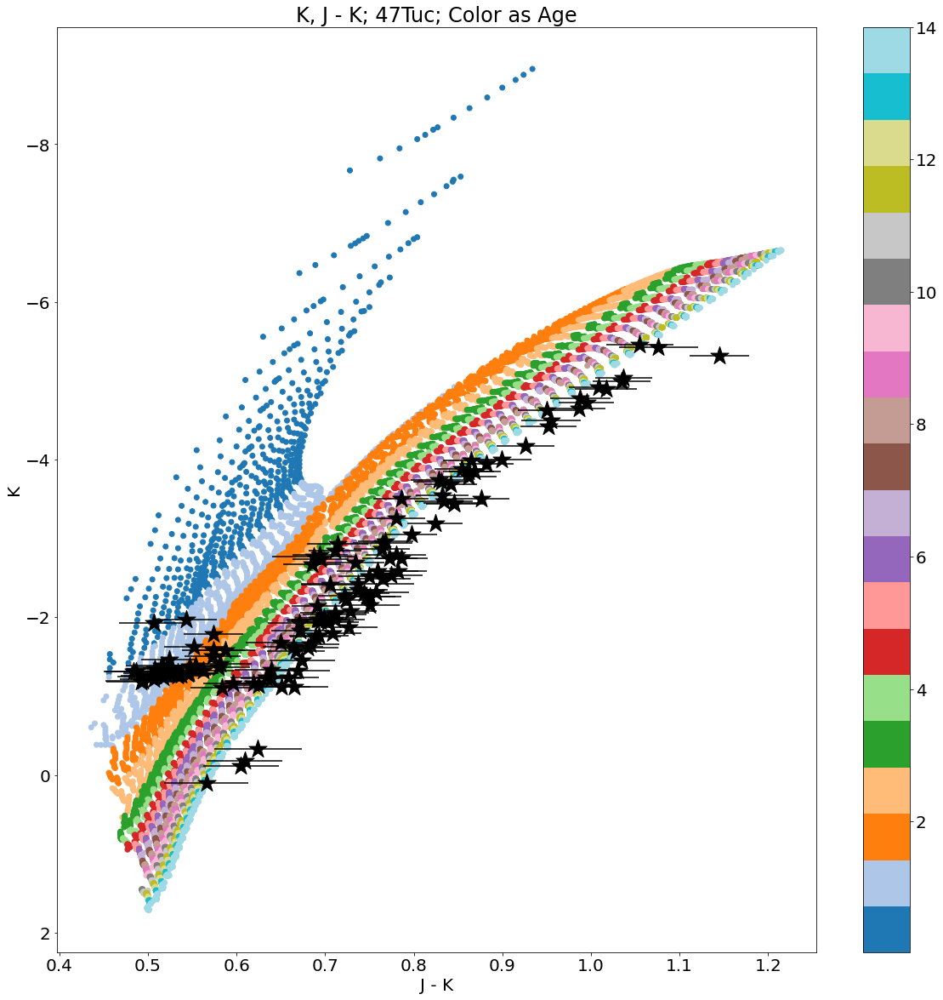

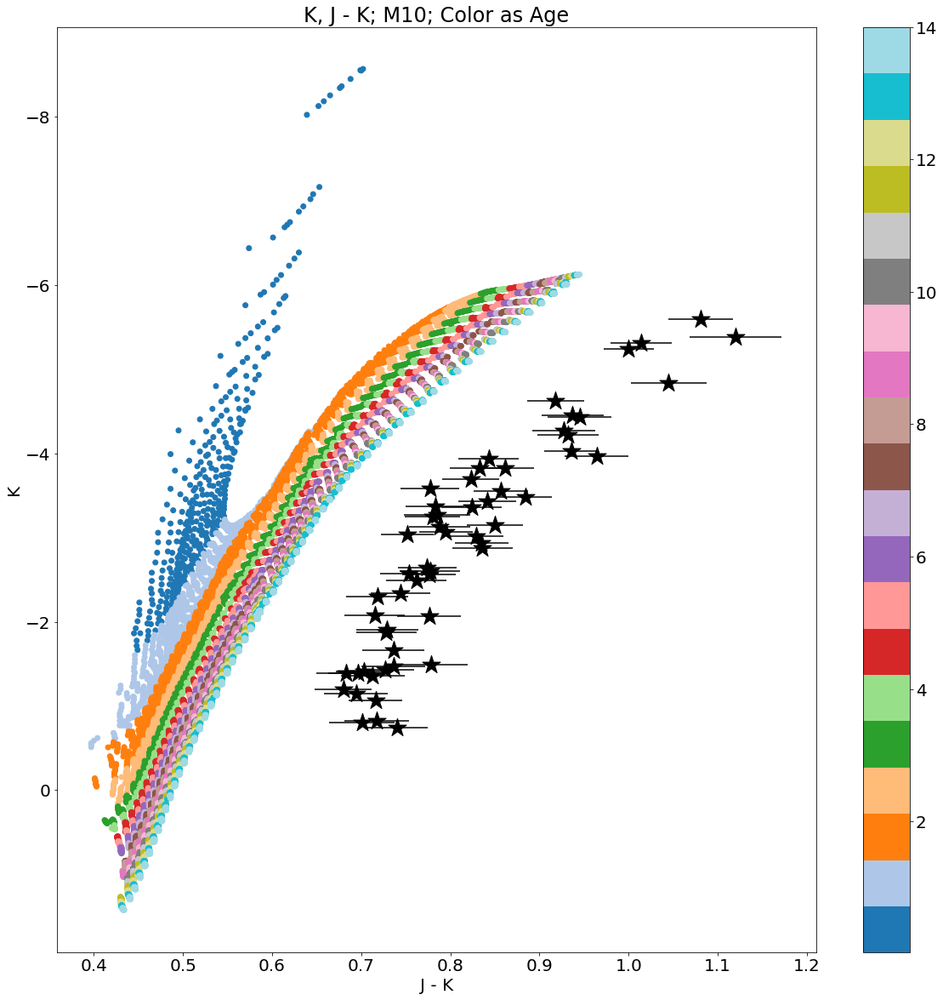

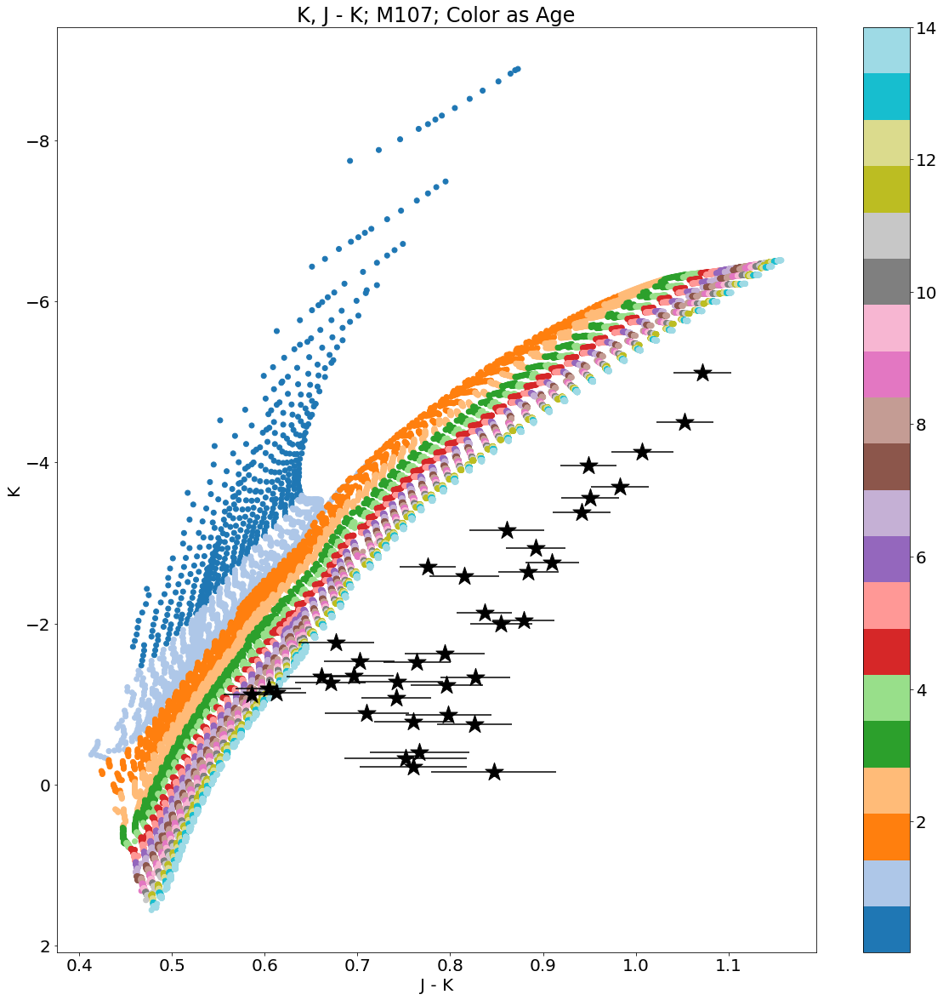

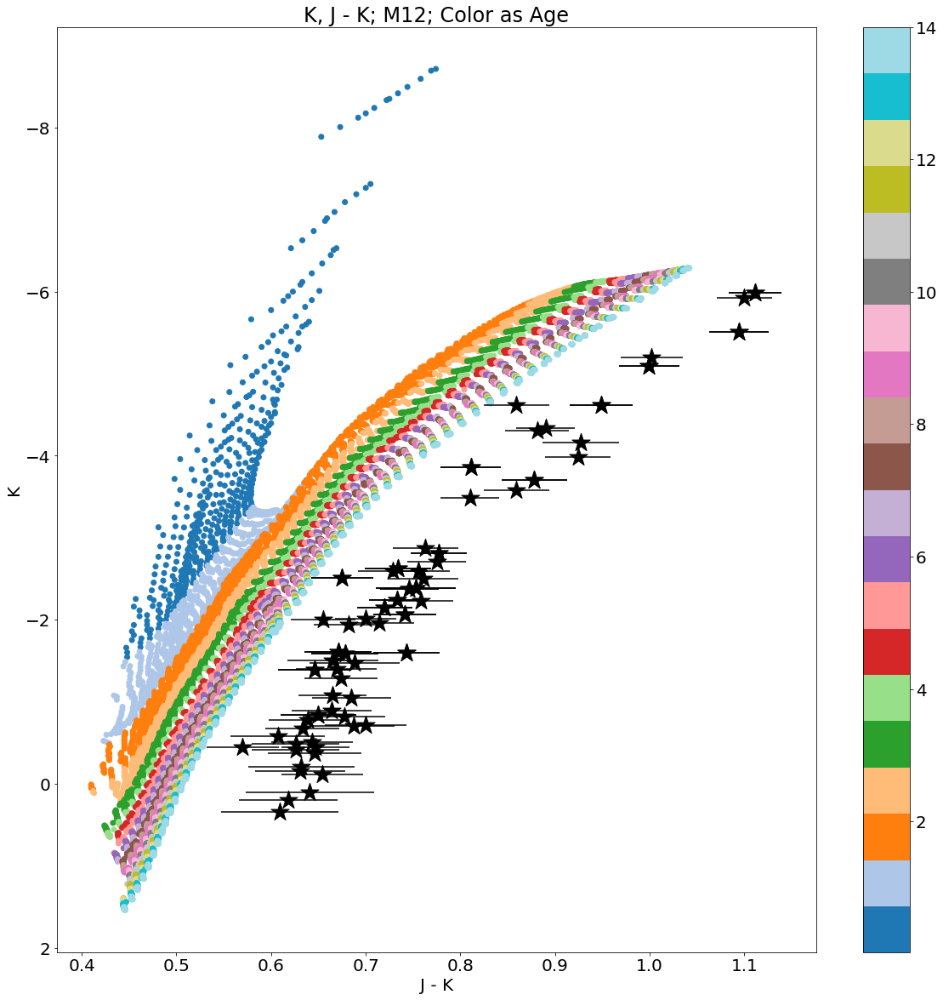

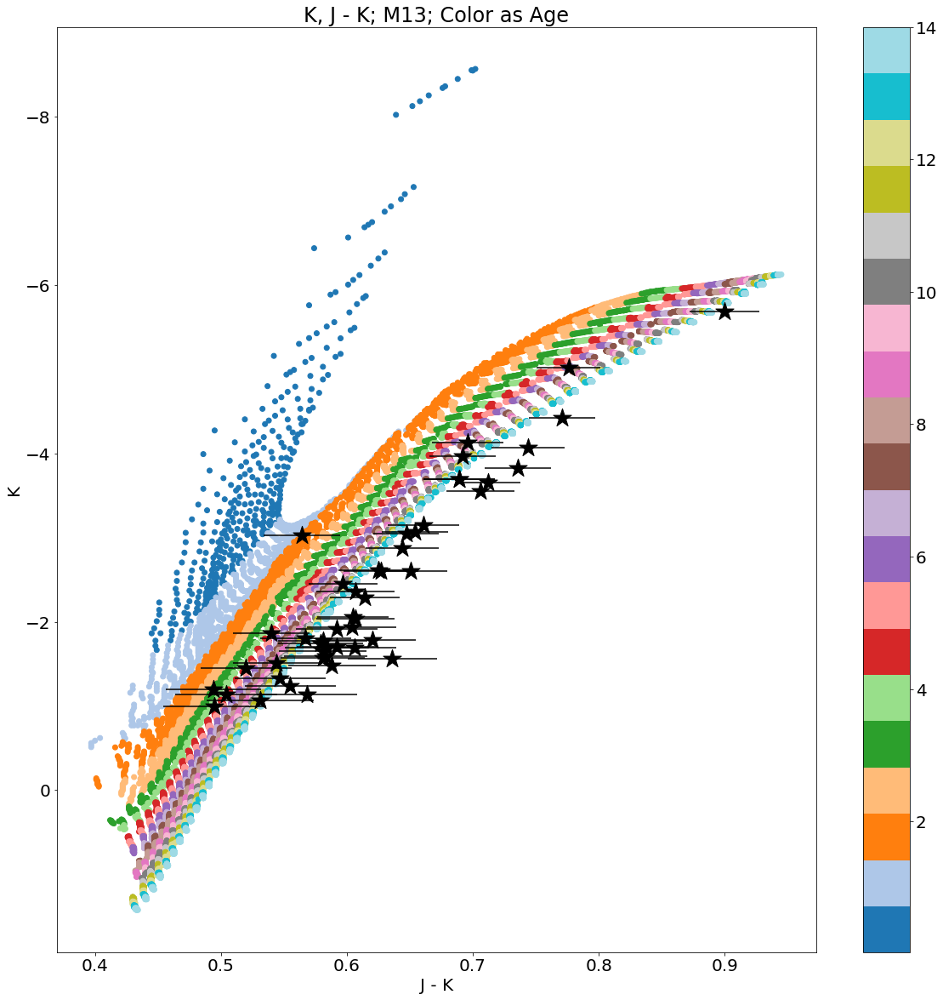

...

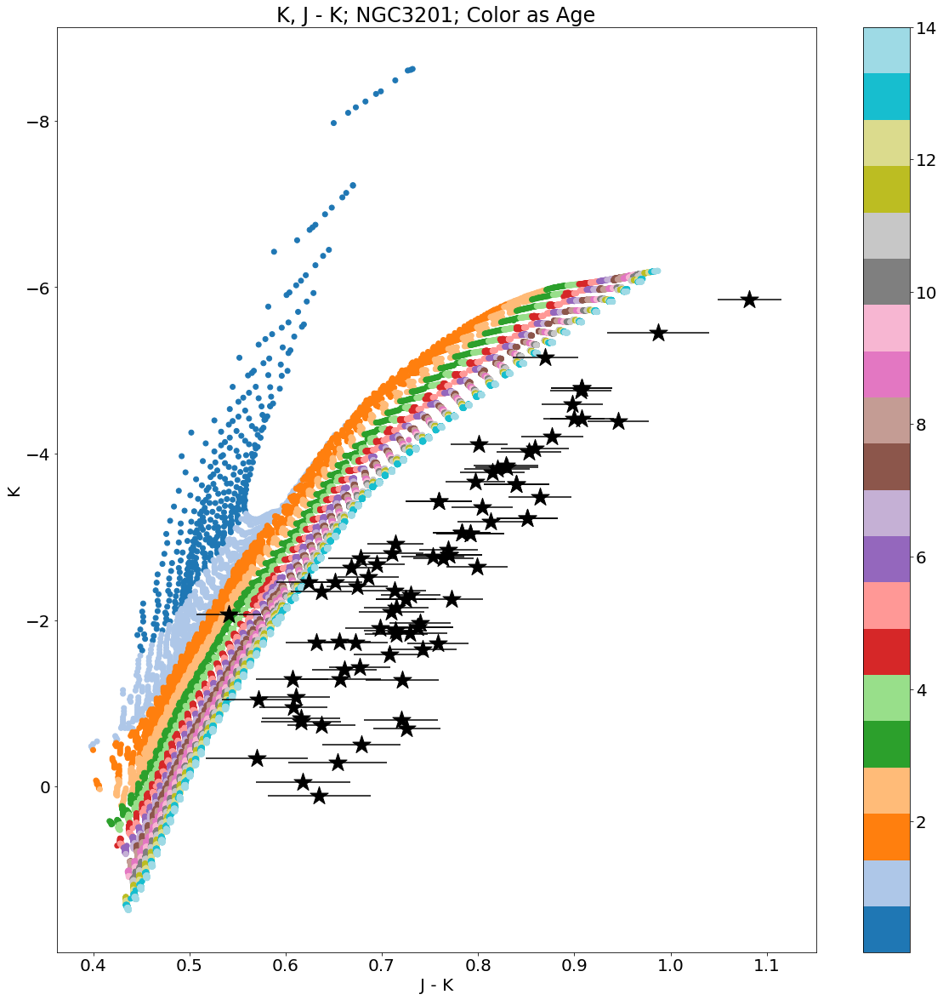

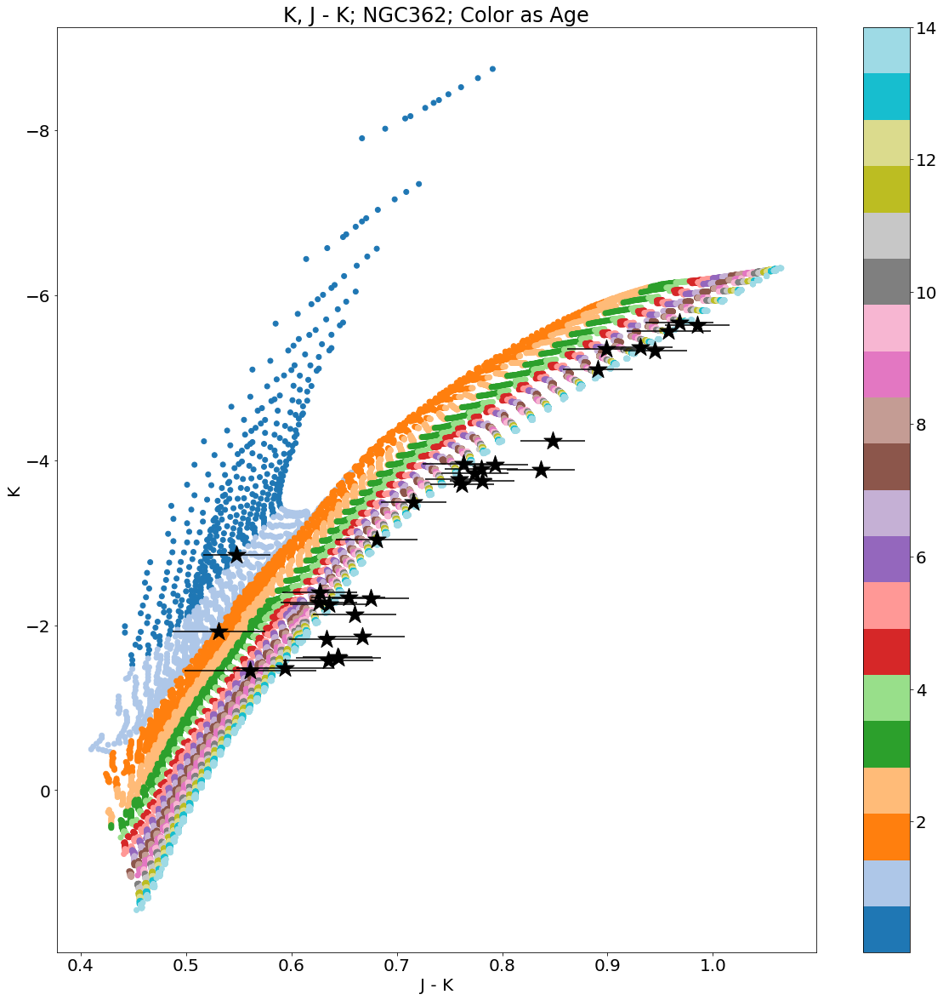

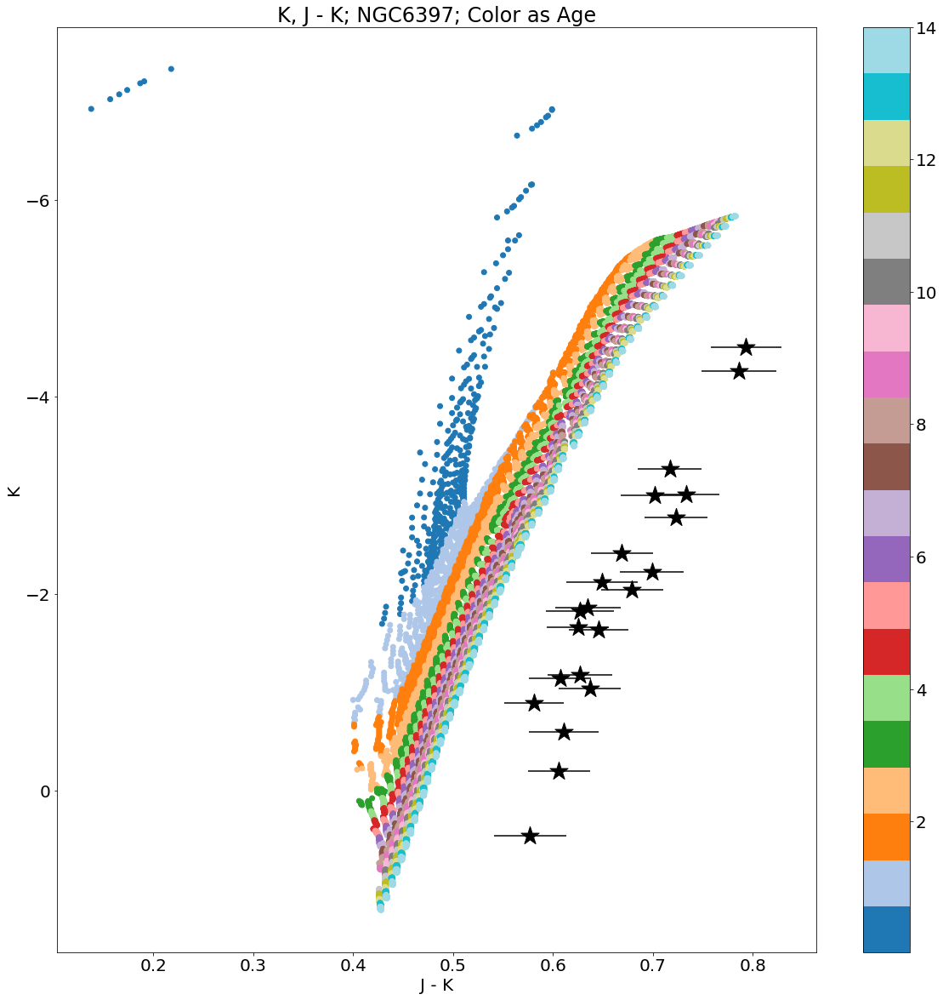

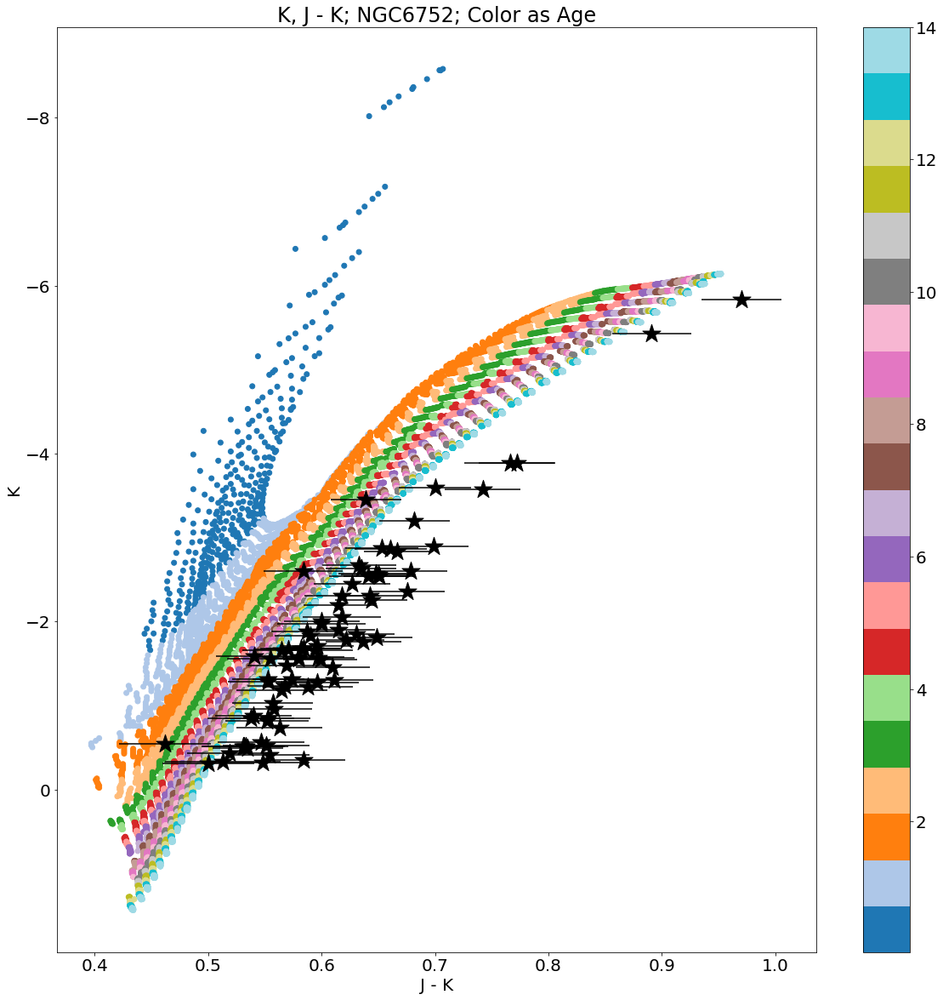

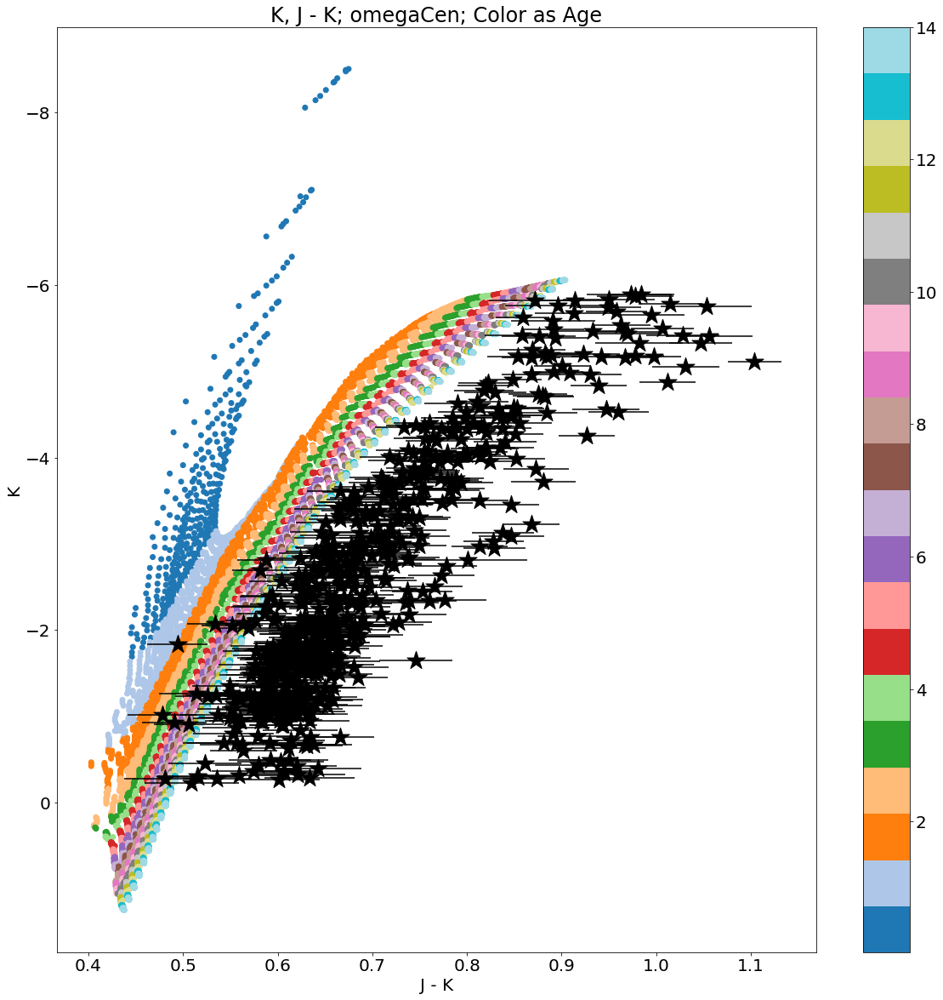

In [49]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['Jmag']-massive['Ksmag'])[isopick],massive['Ksmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    
    plt.errorbar((gcs['J']-gcs['K'])[clus],(gcs['K']-5*np.log10(harris[i]*1000)+5)[clus],
                 xerr=np.sqrt(gcs['J_ERR']**2+gcs['K_ERR']**2)[clus],
                 yerr=np.sqrt(gcs['K_ERR']**2)[clus],
                 c='k',ls='none')
    
    plt.scatter((gcs['J']-gcs['K'])[clus],#-gcs['AK_TARG']*ejk_ak
                (gcs['K']-5*np.log10(harris[i]*1000)+5)[clus],c='k',marker='*',s=500,#-gcs['AK_TARG']
                 zorder=1)
    
    plt.gca().invert_yaxis()
    plt.xlabel(r'J - K')
    plt.ylabel(r'K')
    plt.title(r'K, J - K; {}; Color as Age'.format(gcs_clus[i]))
    plt.show()
    
#+(2.17*(500/(harris[i]*1000)))**2

# GAIA Photometry

# Deal with Bad Extinction and Reddening

In [18]:
Ag = 999999.0*np.ones(len(gcs))
Ebprp = 999999.0*np.ones(len(gcs))
not_bad_ag = gcs[np.where(gcs['GAIA_A_G_VAL']!=-9999.0)]['RA','DEC','GAIA_A_G_VAL','GAIA_E_BP_MIN_RP_VAL']
for i in tqdm_notebook(range(len(gcs))):
    if gcs['GAIA_A_G_VAL'][i]==-9999.0:
        
        euclid_sq=(np.subtract(gcs['RA'][i],not_bad_ag['RA'])**2+np.subtract(gcs['DEC'][i],not_bad_ag['DEC'])**2)
        Ag[i]=not_bad_ag['GAIA_A_G_VAL'][euclid_sq.argmin()]
        Ebprp[i]=not_bad_ag['GAIA_E_BP_MIN_RP_VAL'][euclid_sq.argmin()]
        
    else:
        Ag[i]=gcs['GAIA_A_G_VAL'][i]
        Ebprp[i]=gcs['GAIA_E_BP_MIN_RP_VAL'][i]

cutbad, = np.where(gcs['GAIA_A_G_VAL']!=-9999.0)

 
0.5041 x - 0.000639


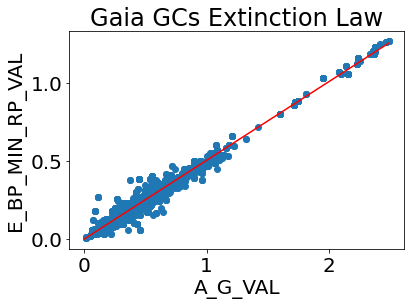

In [19]:
z = np.polyfit(Ag, Ebprp, 1)
p = np.poly1d(z)
print(p)

plt.scatter(Ag,Ebprp)
plt.plot([0,max(Ag)],[p(0),p(max(Ag))],c='r')
plt.xlabel(r'A_G_VAL')
plt.ylabel(r'E_BP_MIN_RP_VAL')
plt.title(r'Gaia GCs Extinction Law')
plt.show()

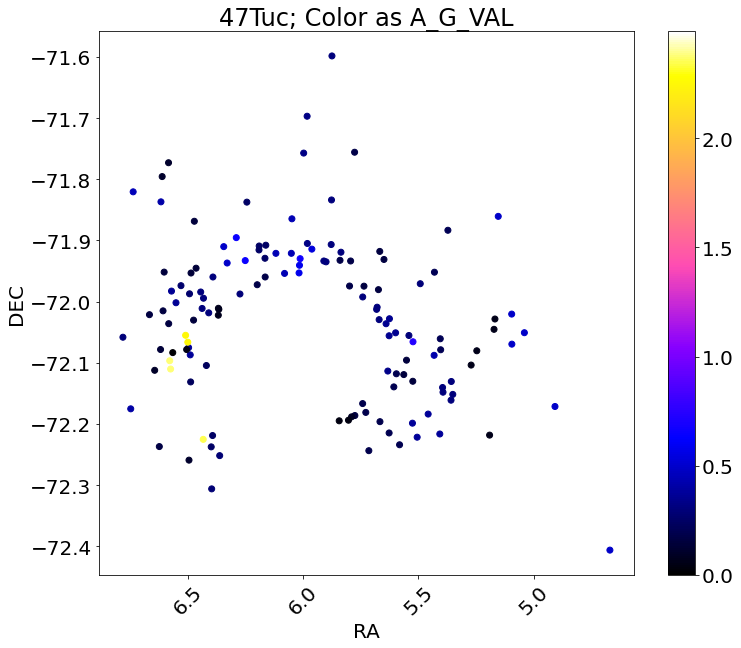

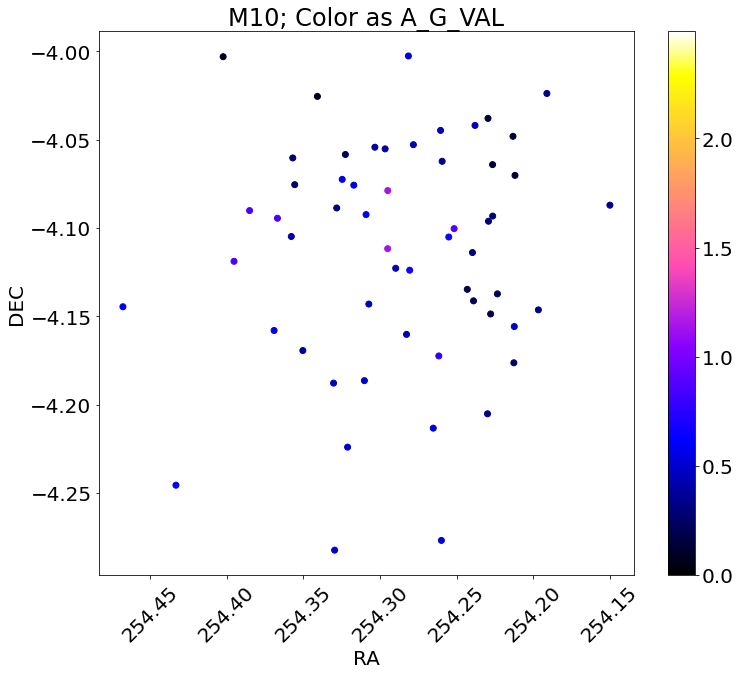

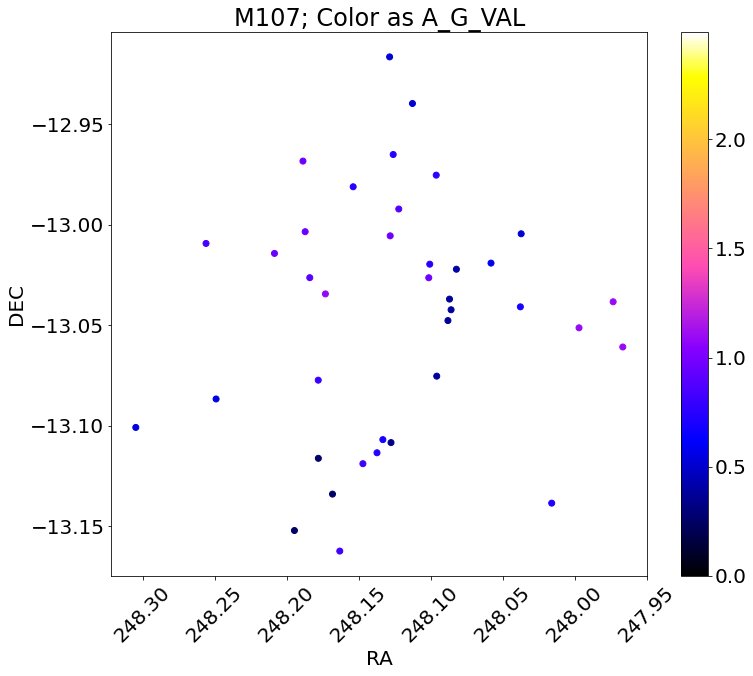

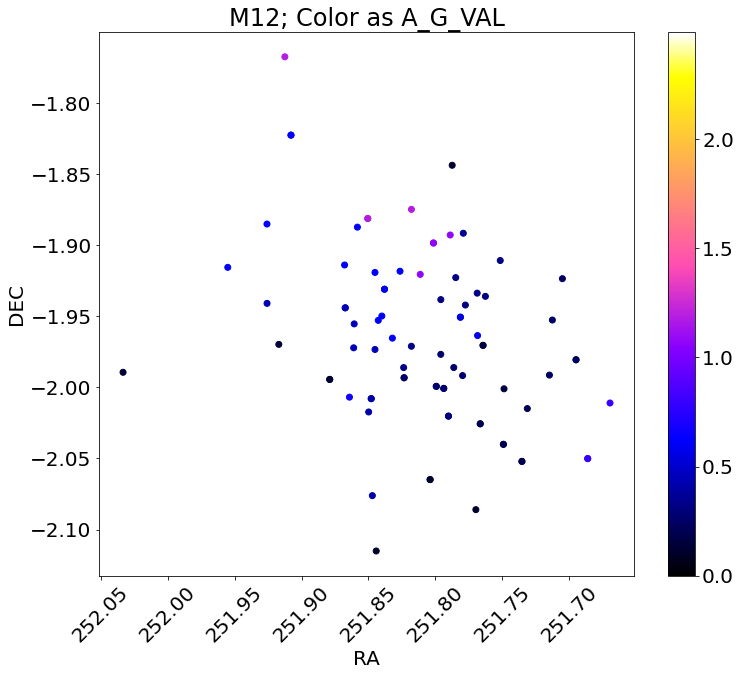

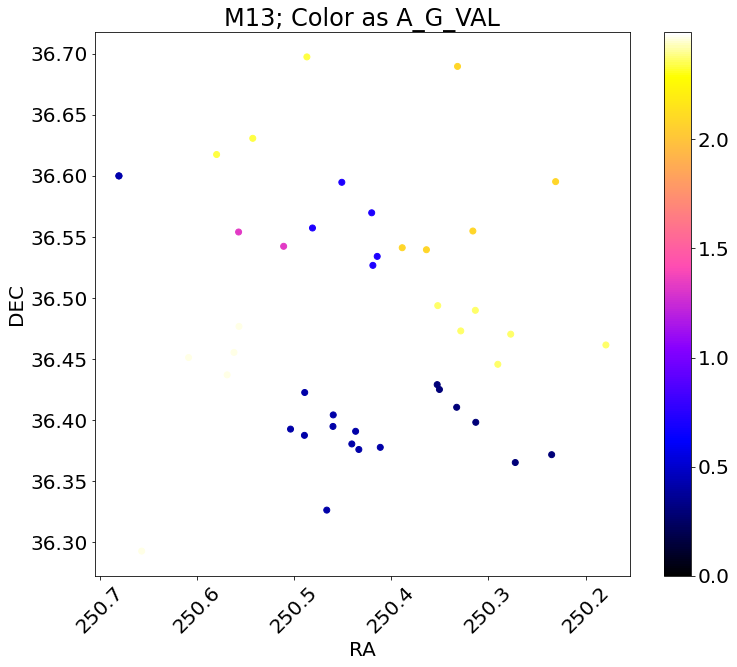

...

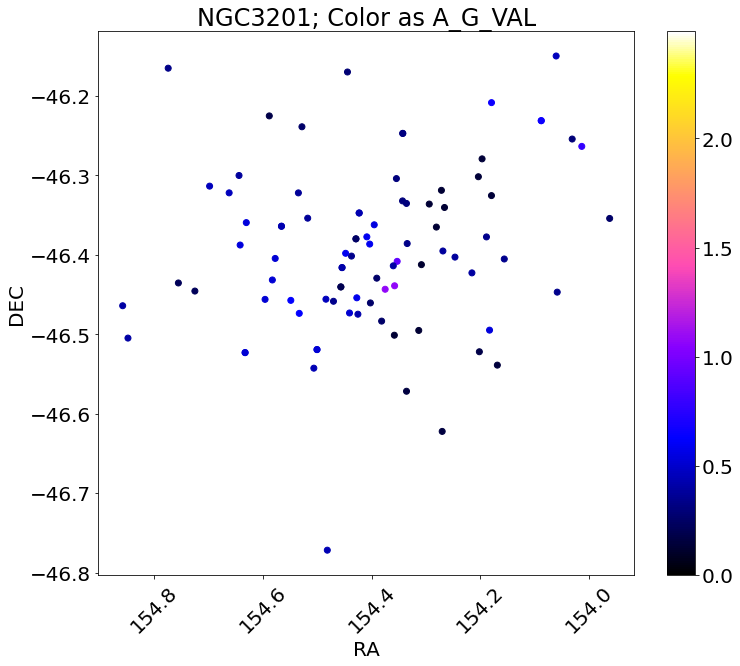

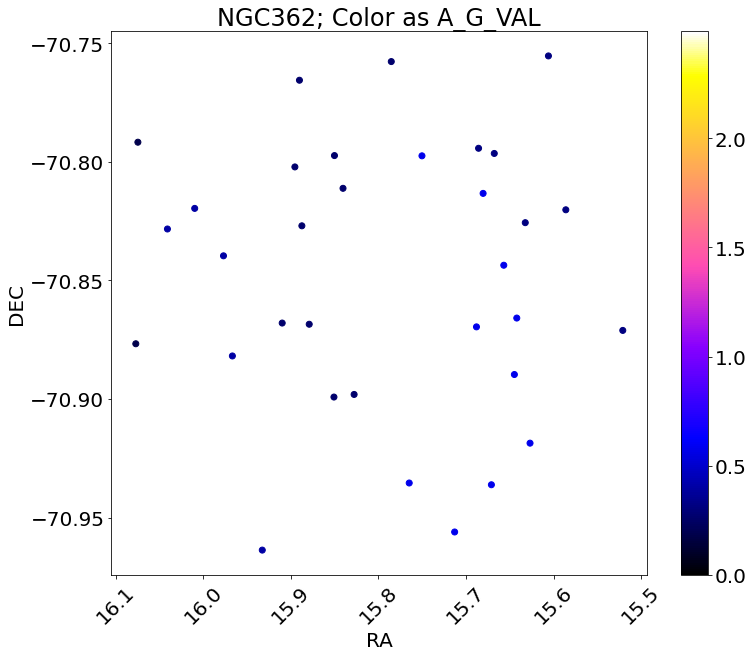

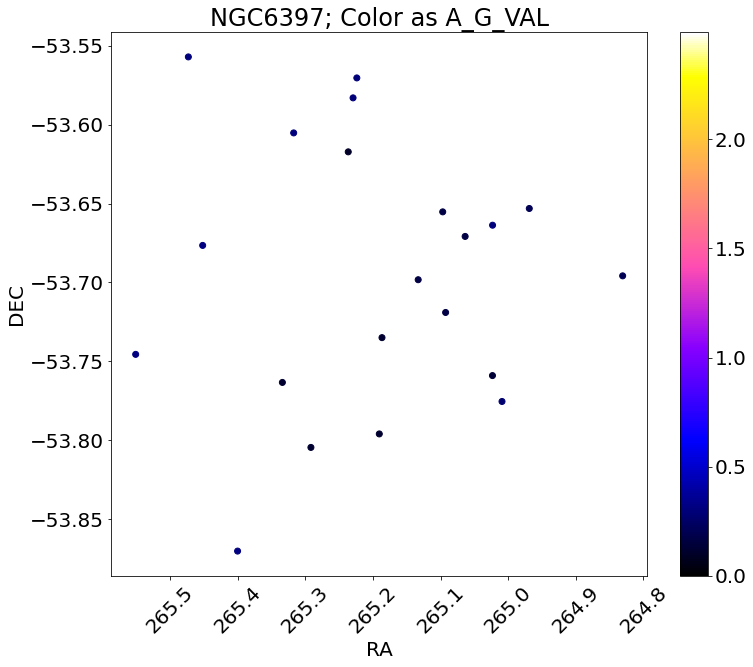

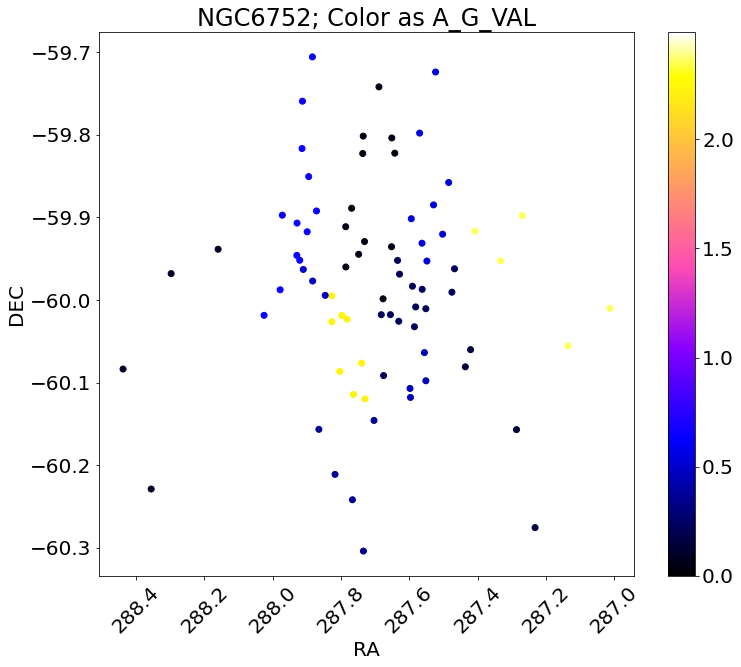

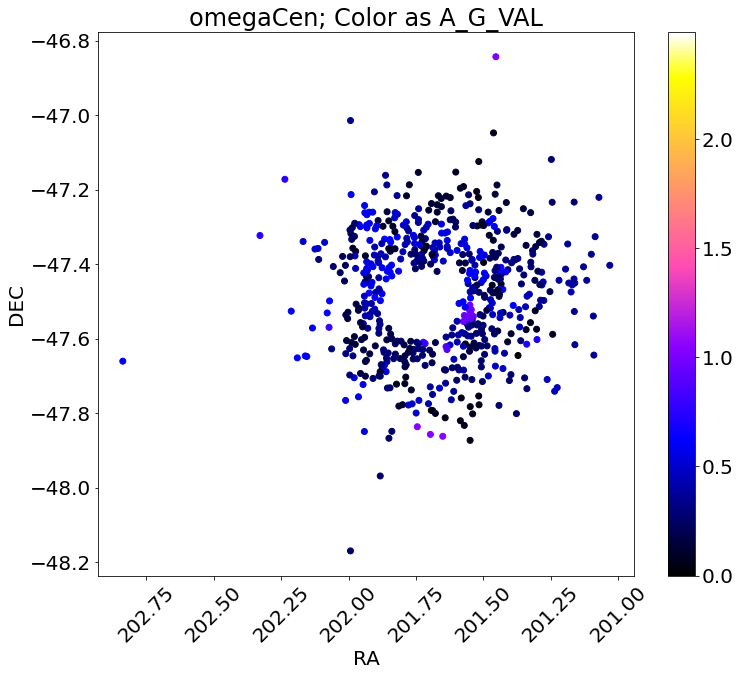

In [20]:
for i in range(len(gcs_clus)):
    clus, = np.where(gcs['CLUSTER']==gcs_clus[i])
    plt.figure(figsize=[12,10])
    plt.scatter(gcs[clus]['RA'],gcs[clus]['DEC'],c=Ag[clus],vmax=max(gcs['GAIA_A_G_VAL']),vmin=0.,cmap='gnuplot2')
    plt.colorbar()
    plt.gca().invert_xaxis()
    plt.xticks(rotation=45)
    plt.title(r'{}; Color as A_G_VAL'.format(gcs_clus[i]))
    plt.xlabel(r'RA')
    plt.ylabel(r'DEC')
    plt.show()

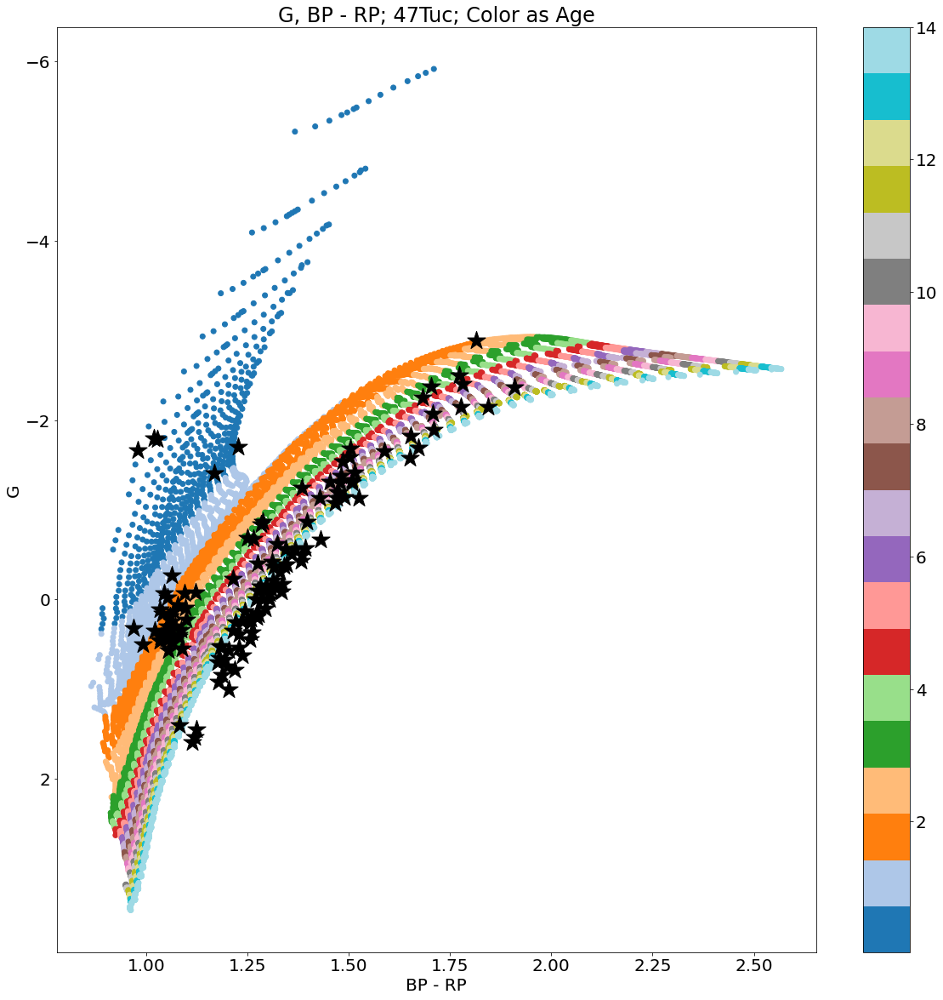

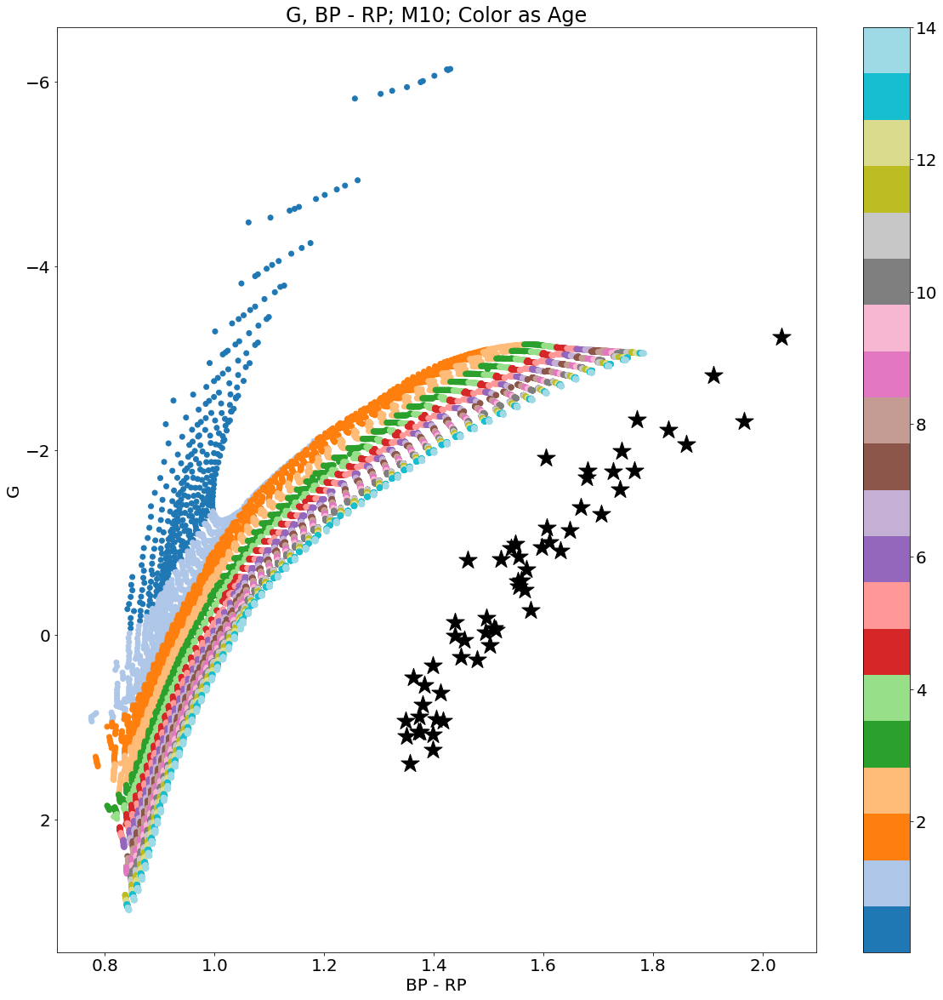

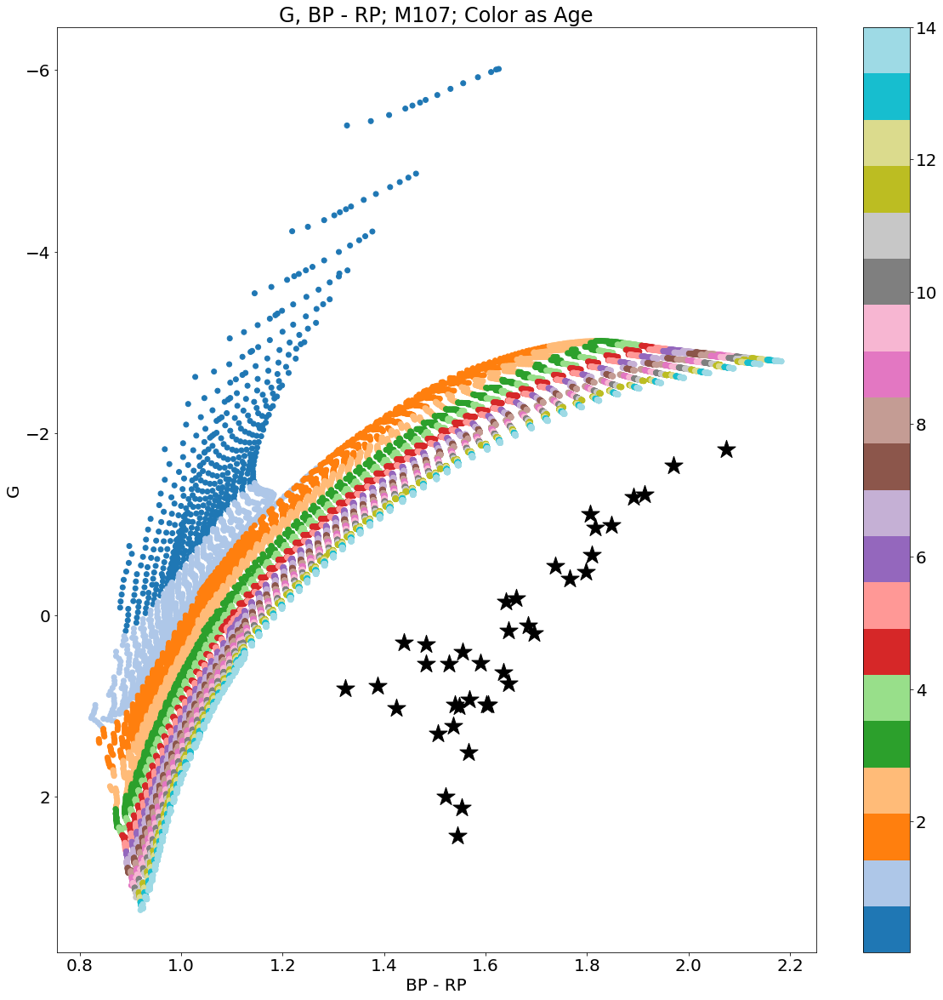

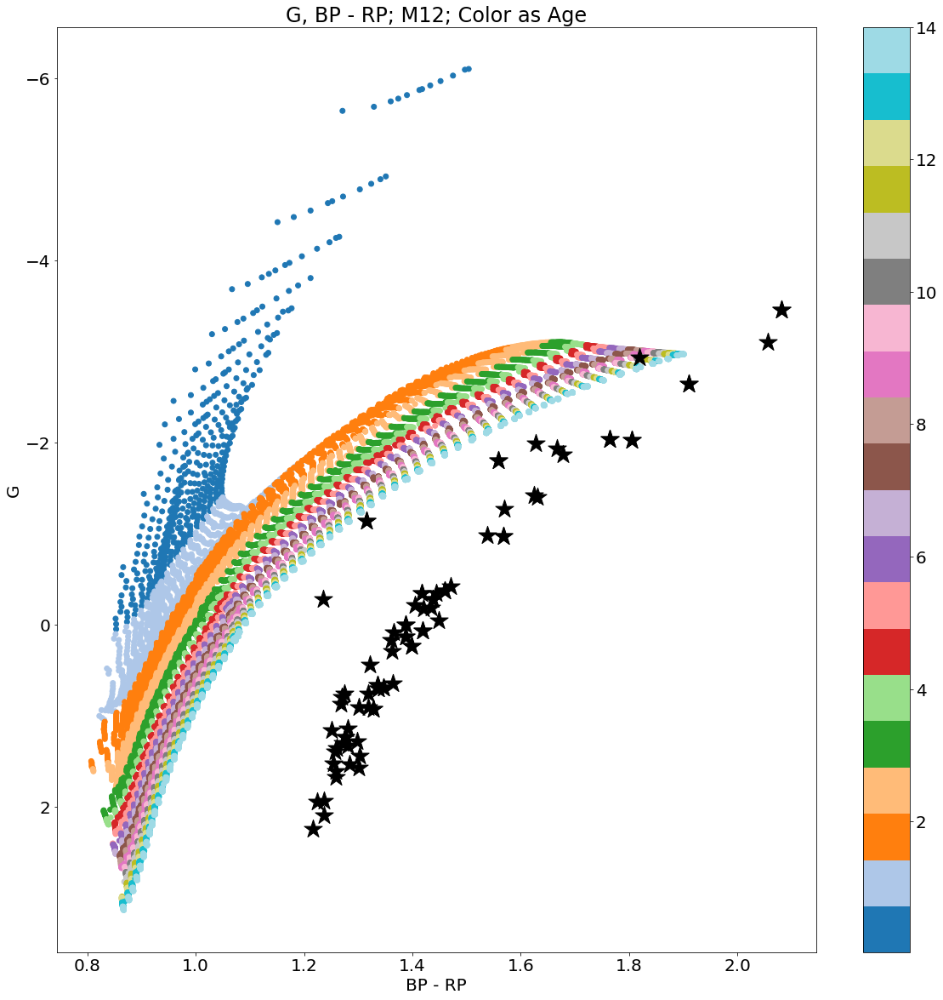

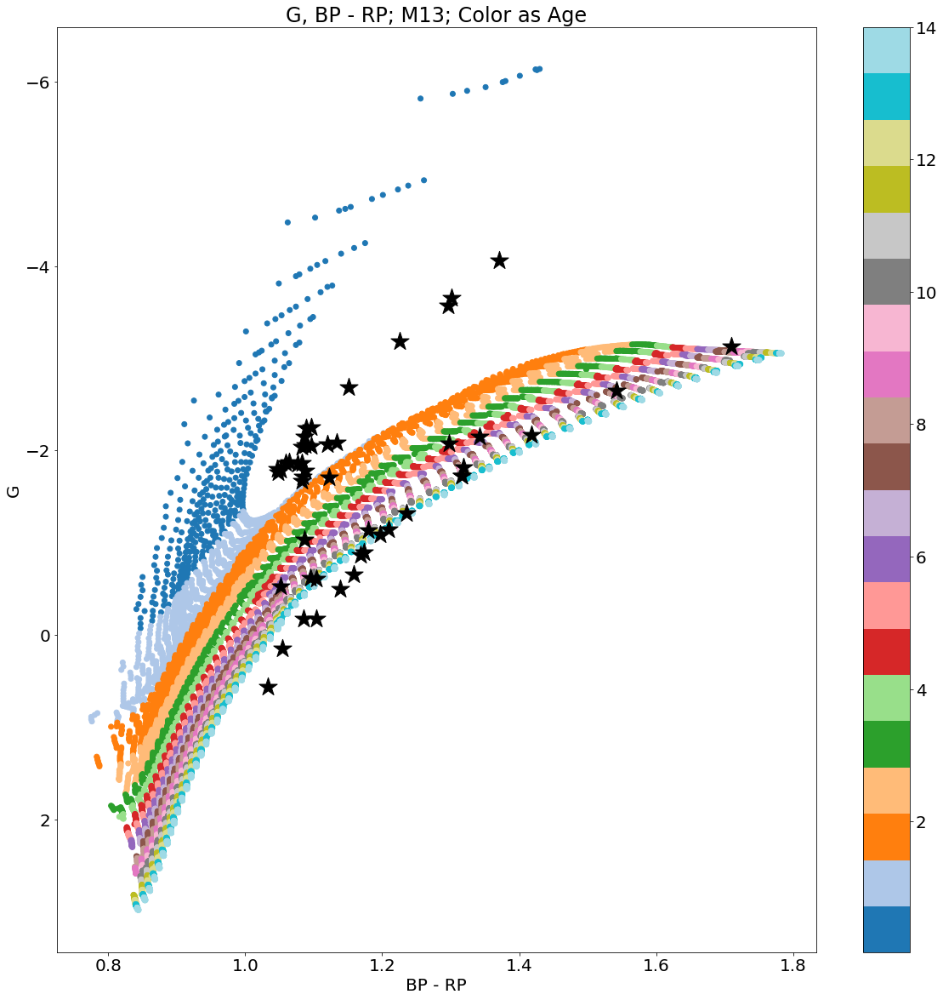

...

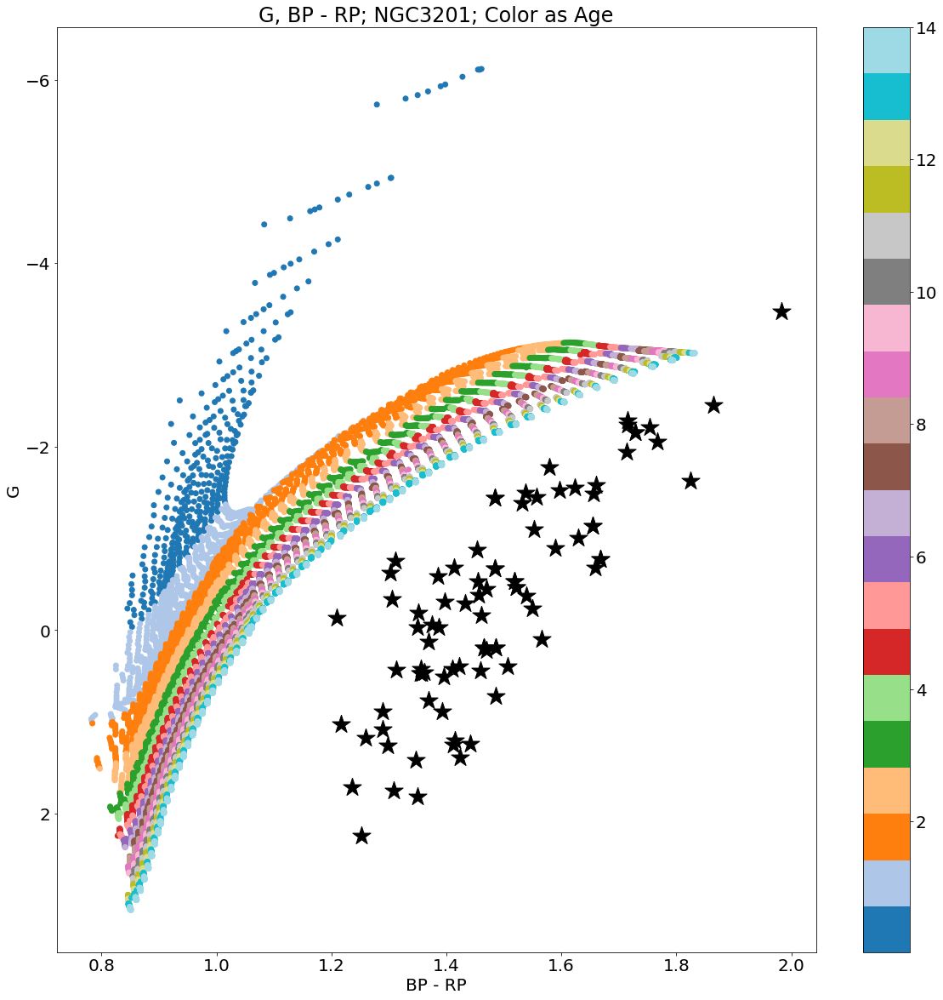

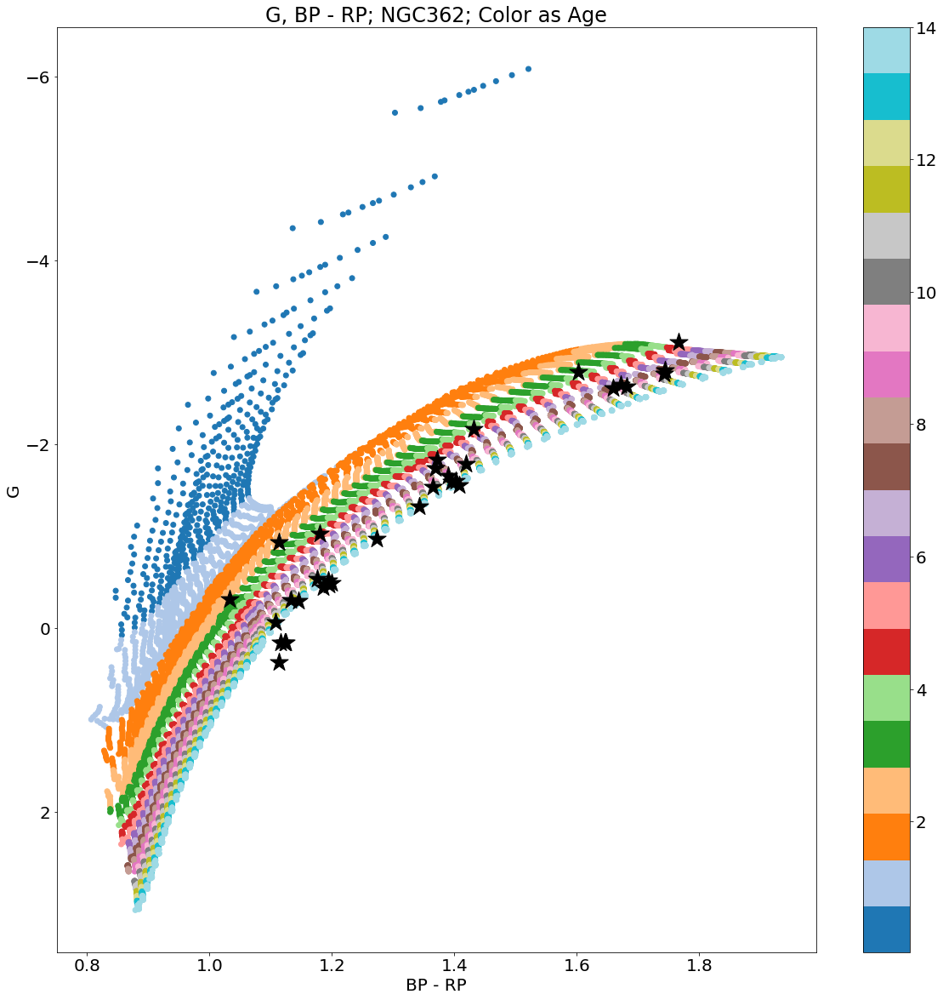

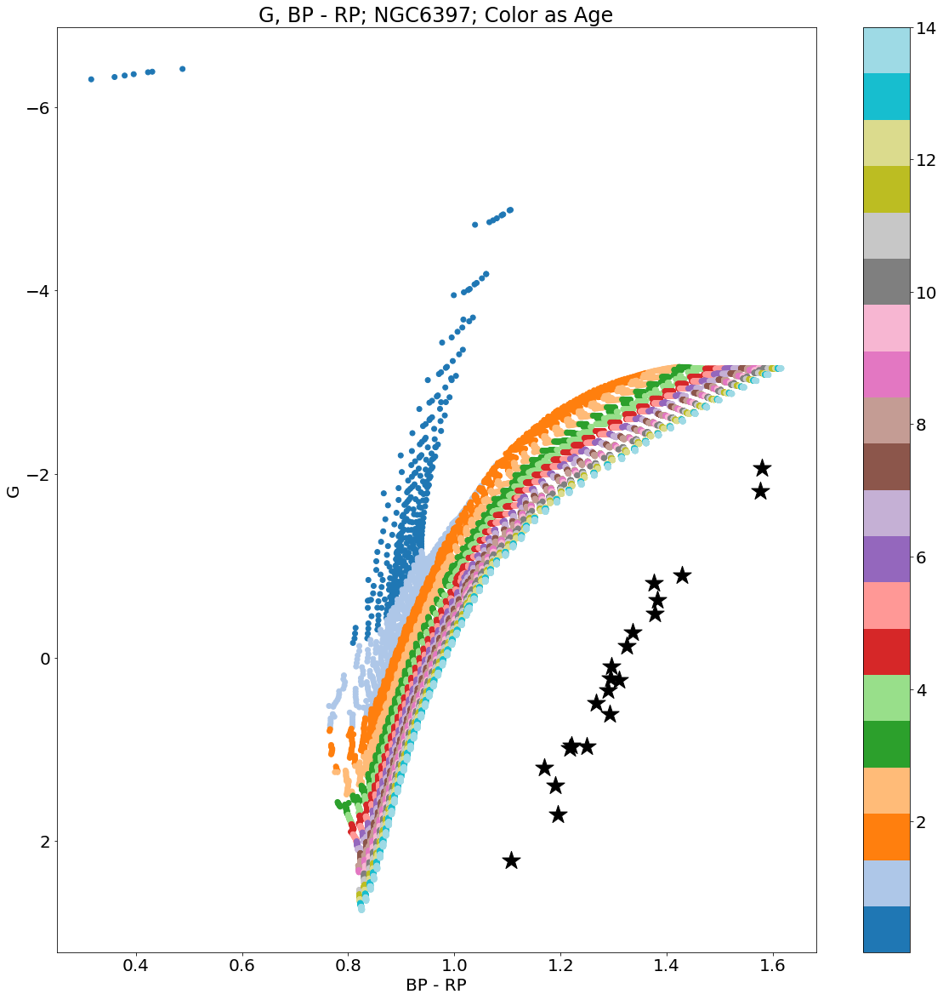

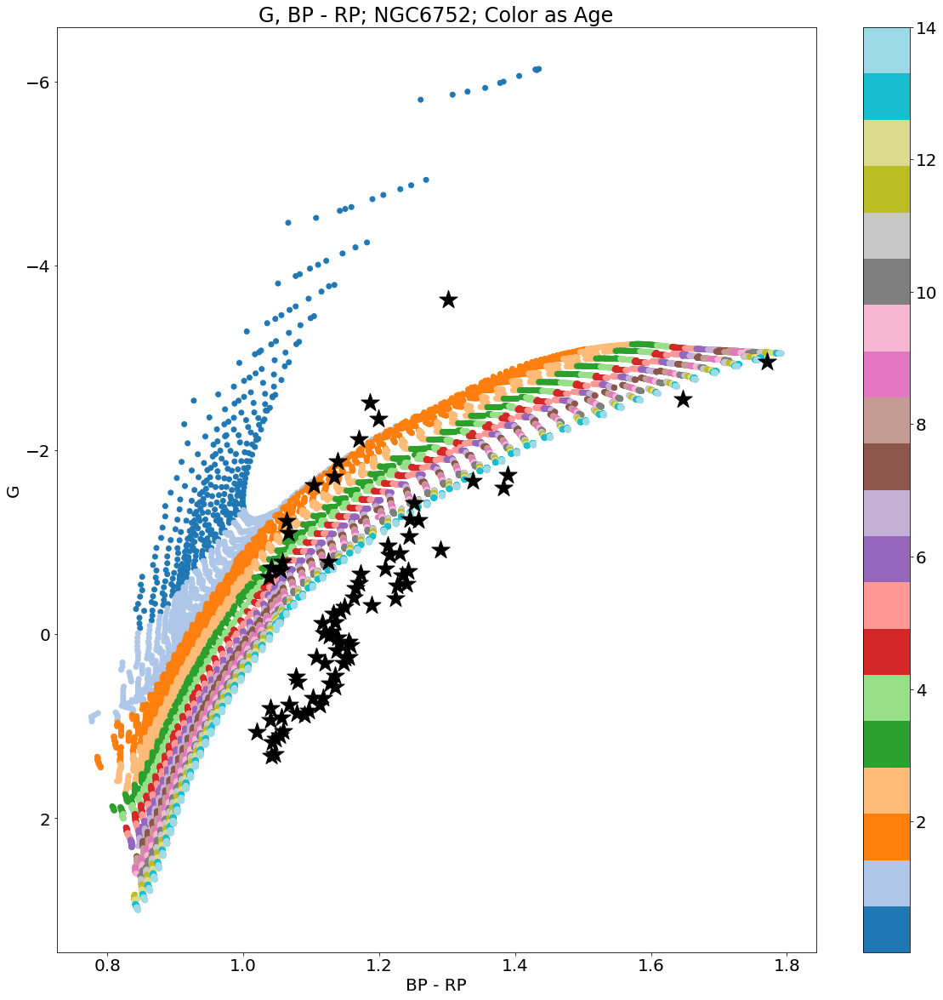

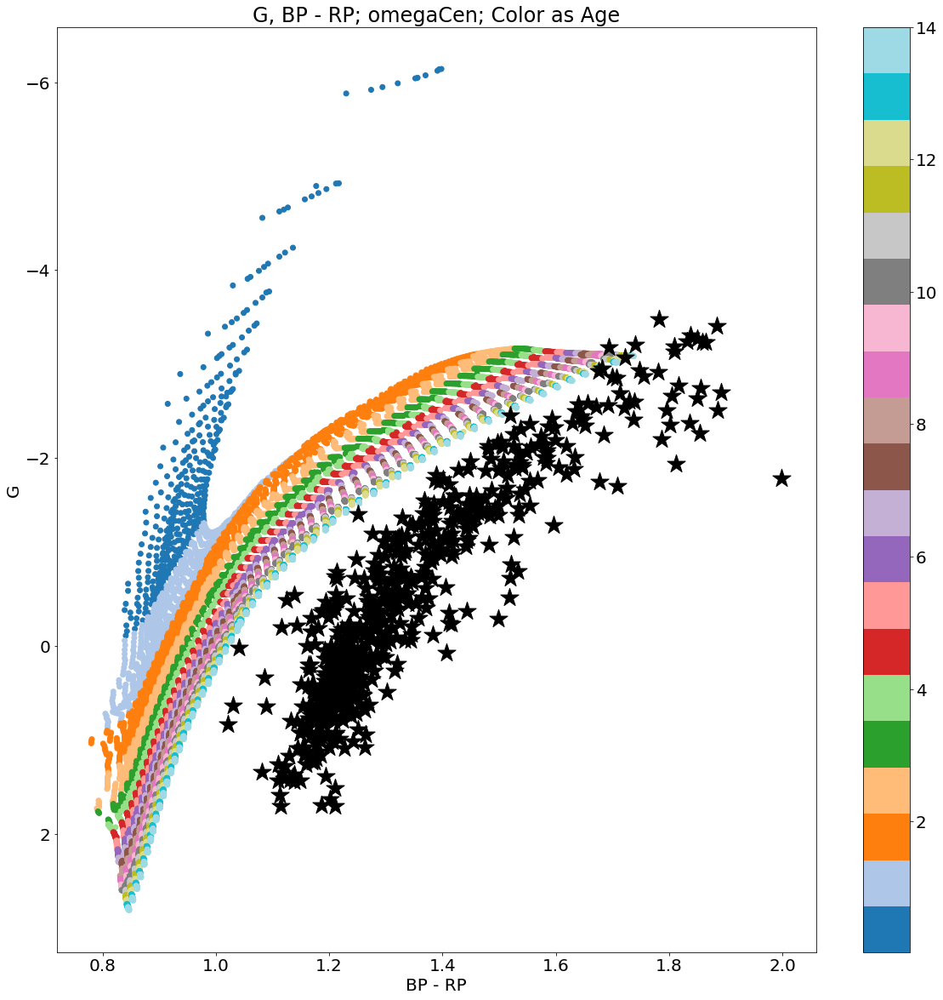

In [41]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['G_BPmag']-massive['G_RPmag'])[isopick],massive['Gmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    plt.scatter((gcs['GAIA_PHOT_BP_MEAN_MAG']-gcs['GAIA_PHOT_RP_MEAN_MAG'])[clus],
                (gcs['GAIA_PHOT_G_MEAN_MAG']-Ag-5*np.log10(harris[i]*1000)+5)[clus],c='k',marker='*',
                s=500,zorder=2)
    plt.gca().invert_yaxis()
    plt.xlabel(r'BP - RP')
    plt.ylabel(r'G')
    plt.title(r'G, BP - RP; {}; Color as Age'.format(gcs_clus[i]))
    plt.show()

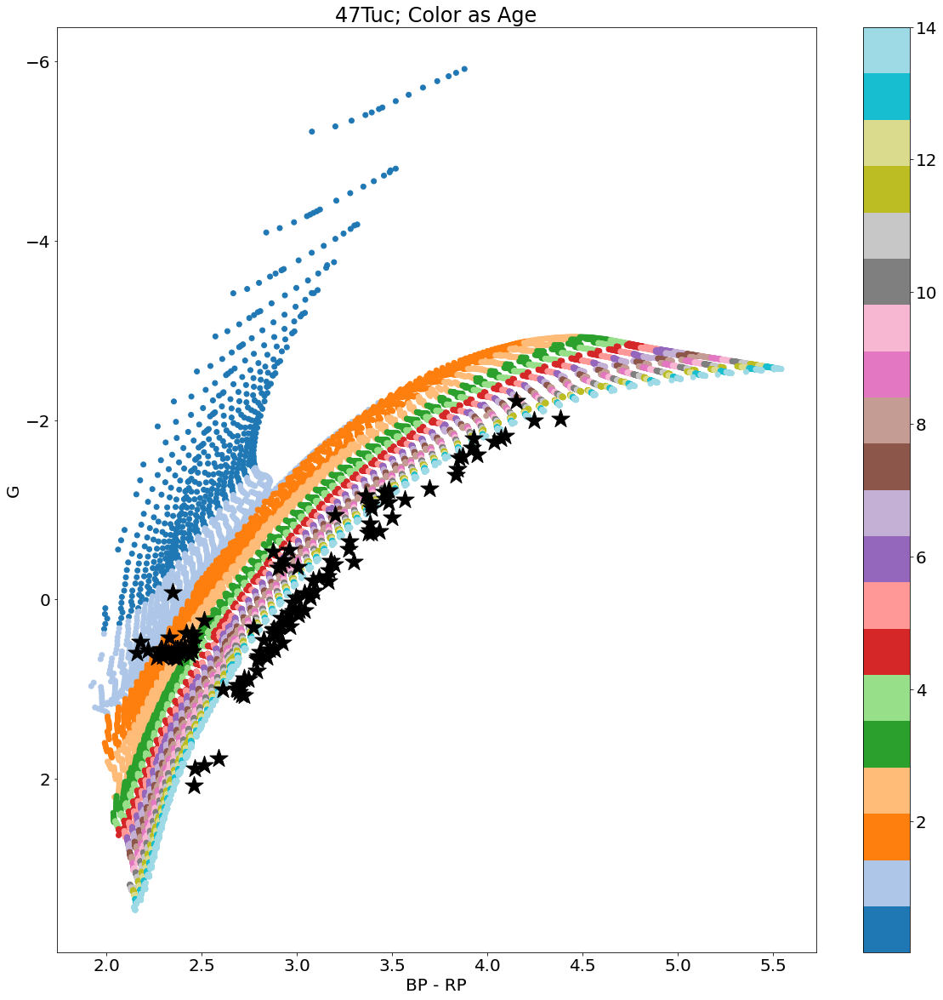

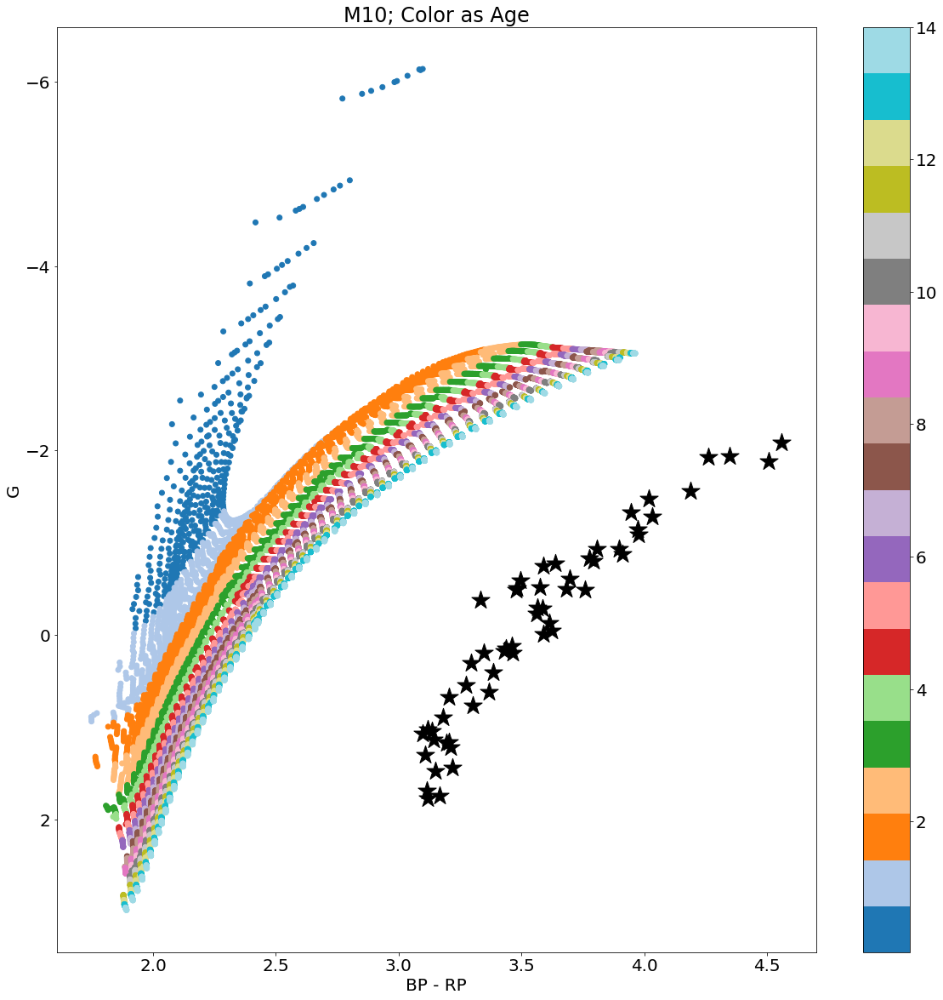

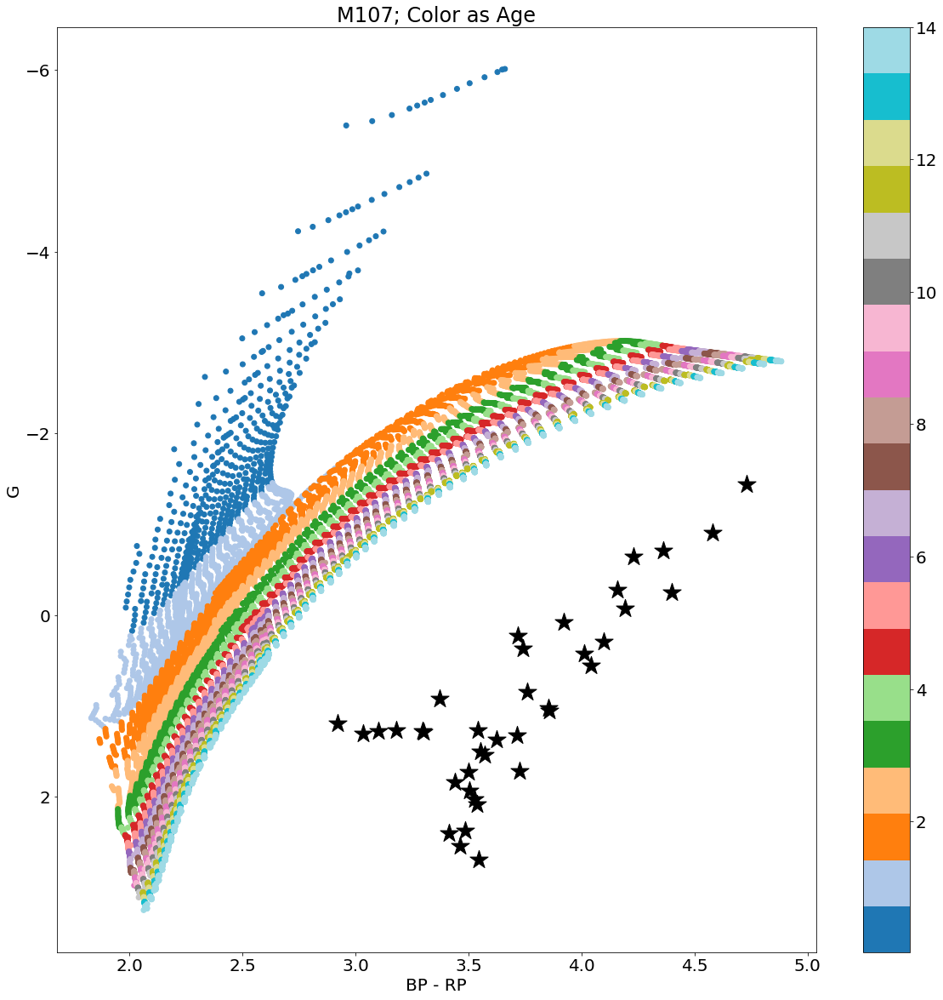

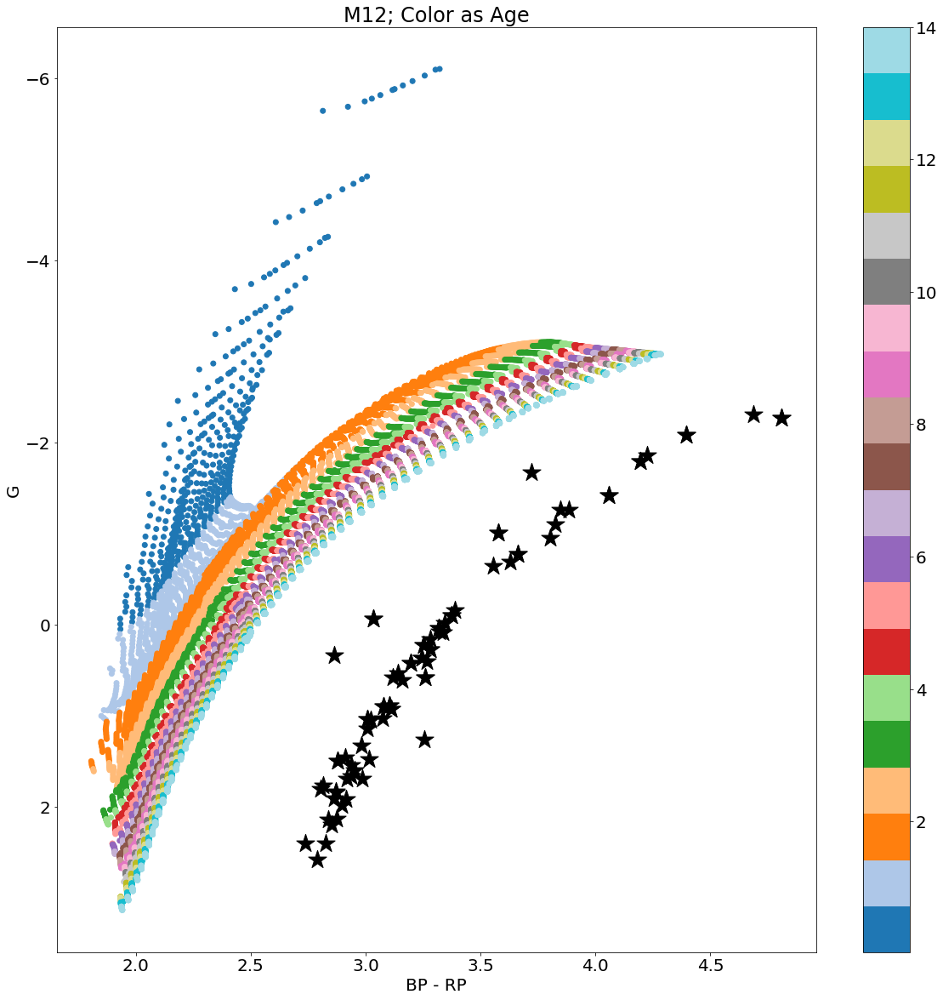

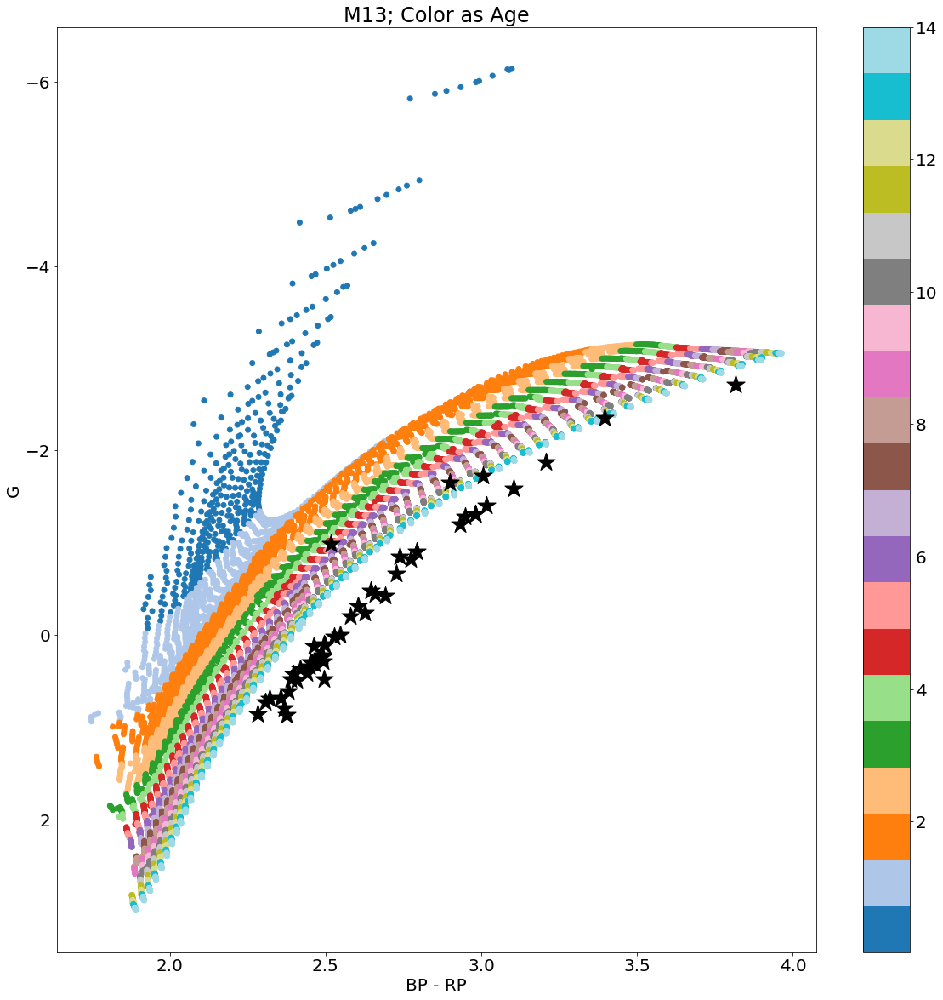

...

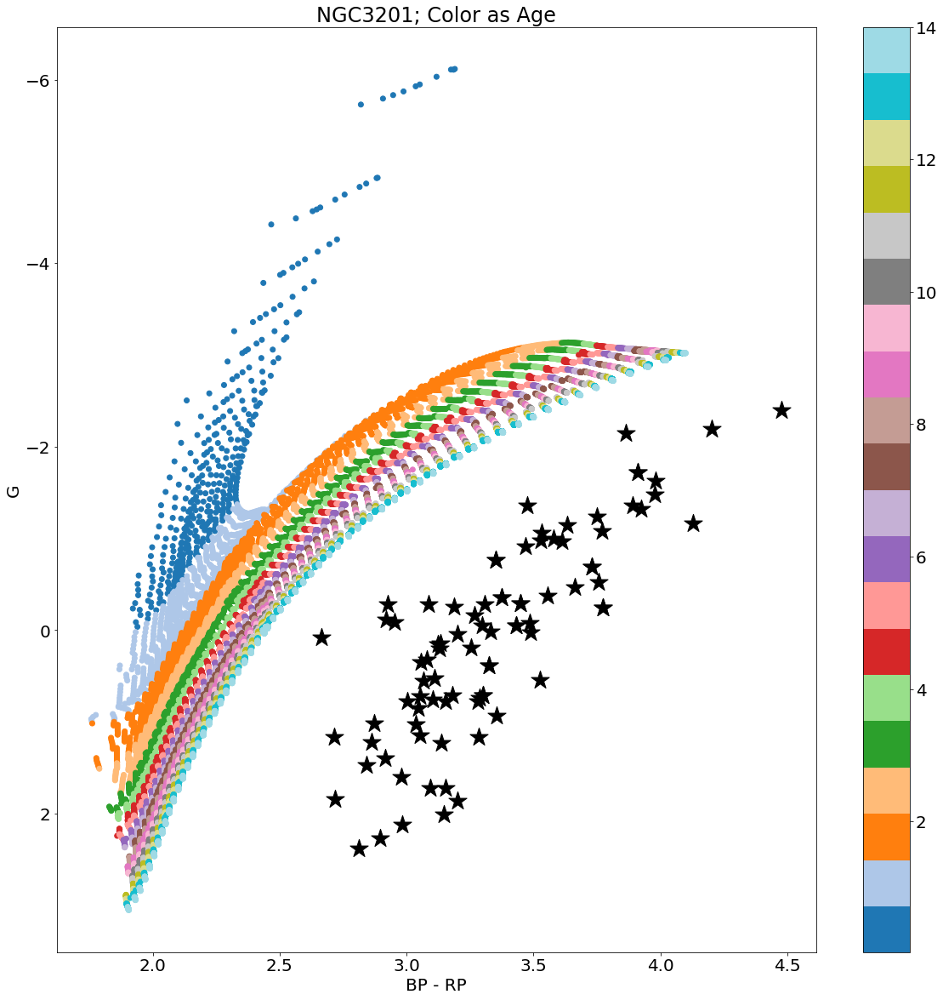

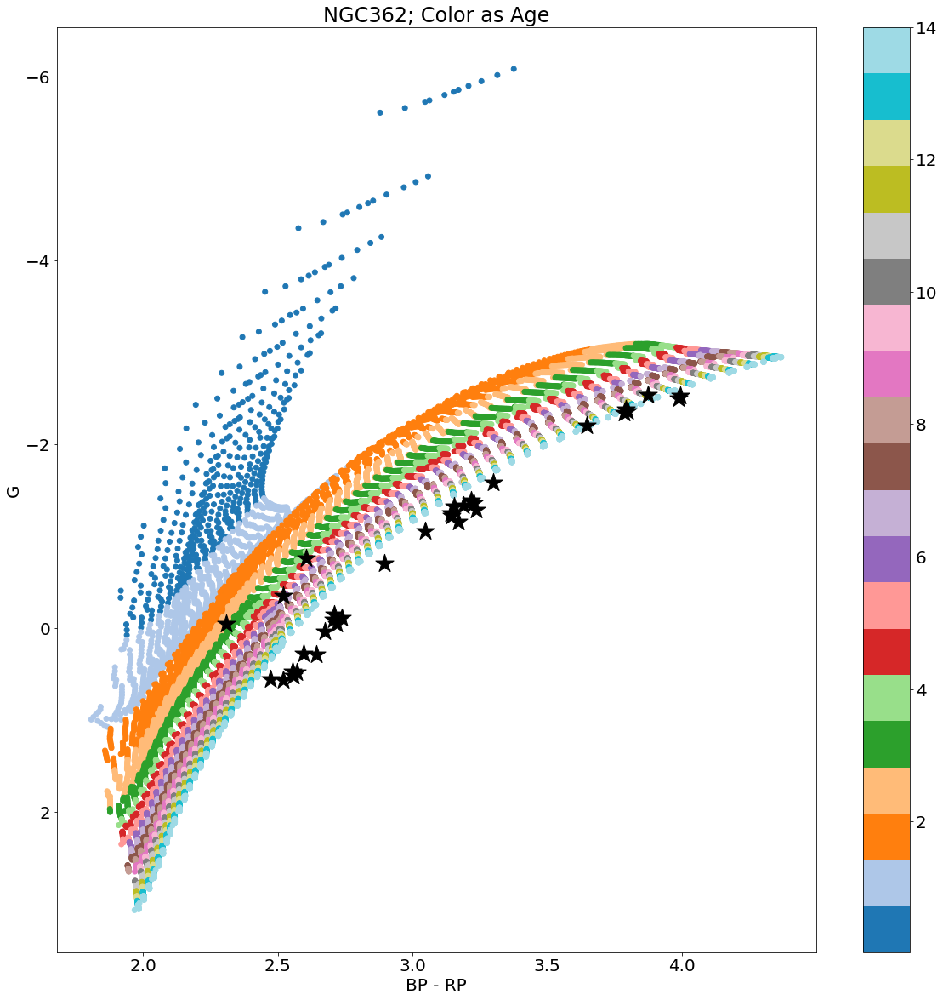

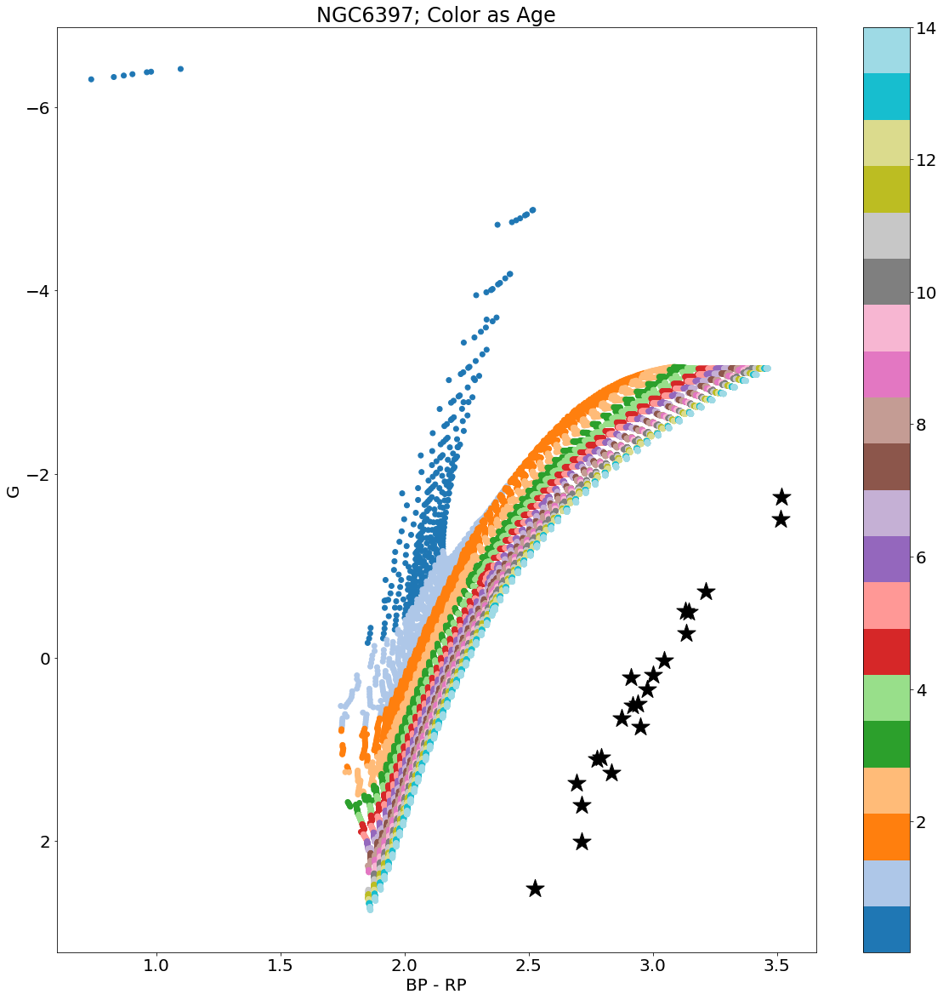

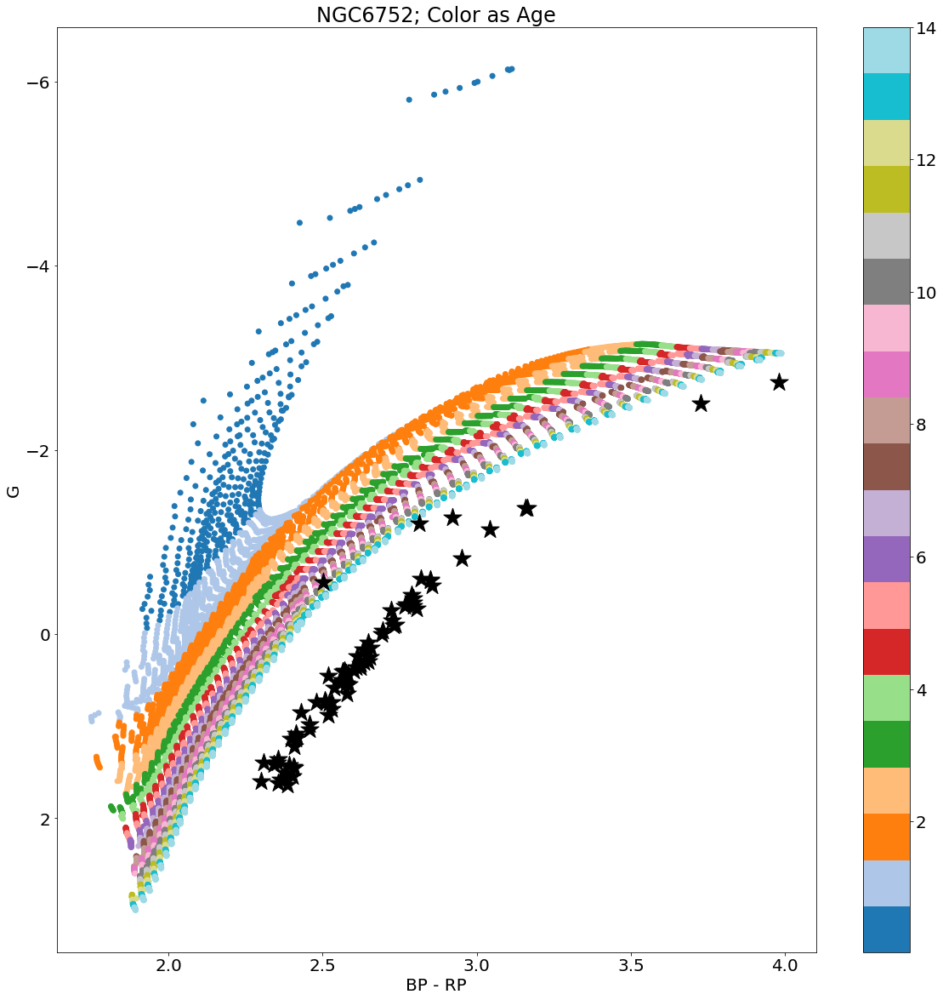

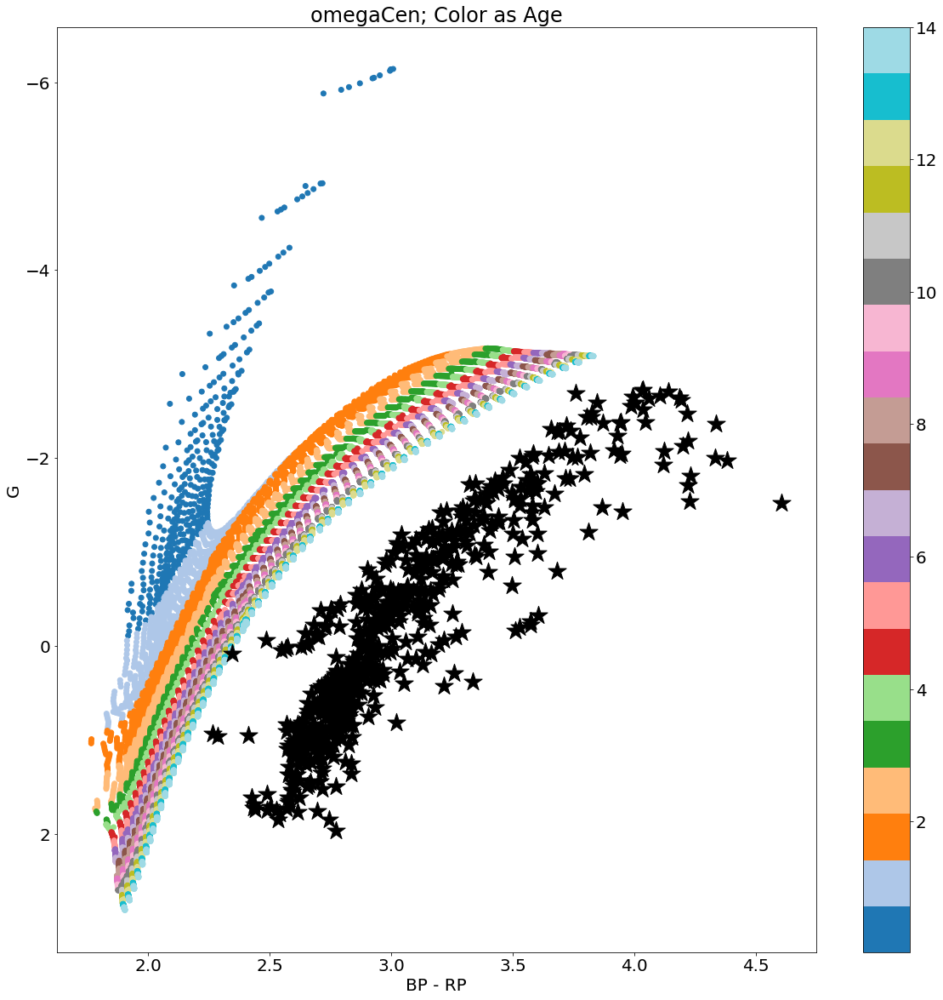

In [42]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['G_BPmag']-massive['Ksmag'])[isopick],massive['Gmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    plt.scatter((gcs['GAIA_PHOT_BP_MEAN_MAG']-gcs['K'])[clus],
                (gcs['GAIA_PHOT_G_MEAN_MAG']-5*np.log10(harris[i]*1000)+5)[clus],c='k',marker='*',
                s=500,zorder=2)
    plt.gca().invert_yaxis()
    plt.xlabel(r'BP - RP')
    plt.ylabel(r'G')
    plt.title(r'{}; Color as Age'.format(gcs_clus[i]))
    plt.show()

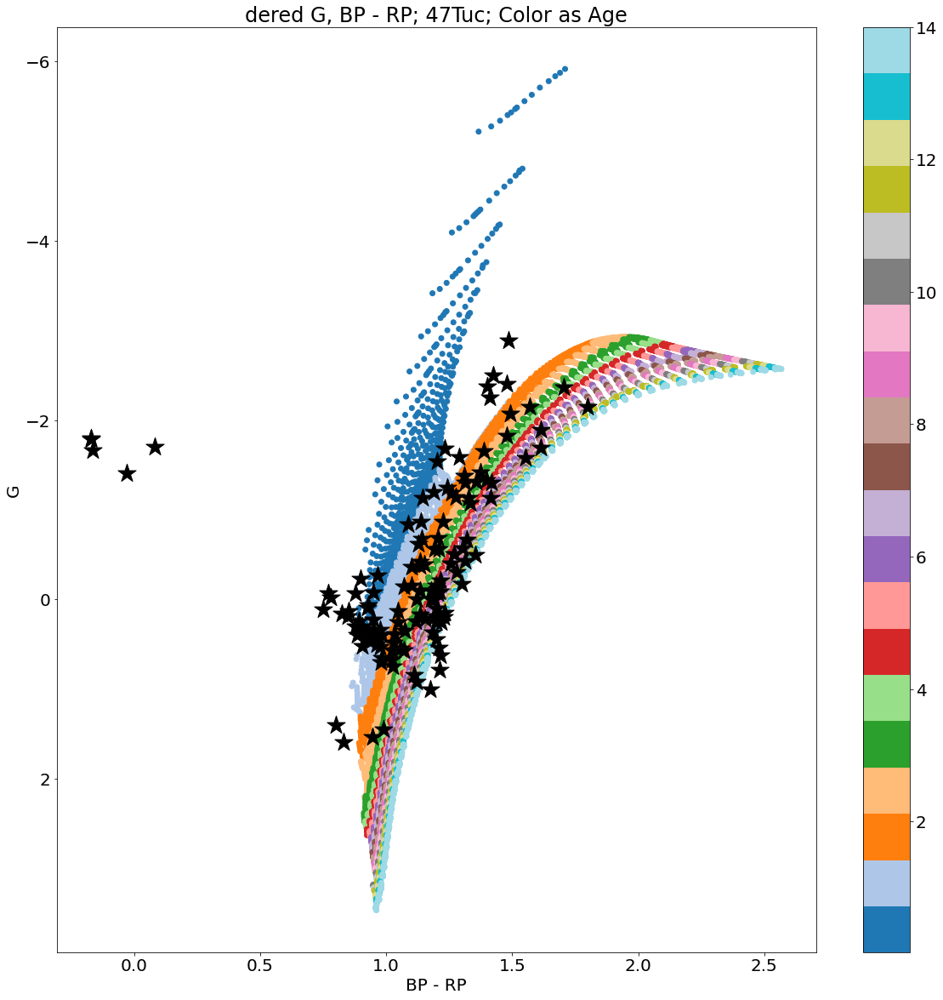

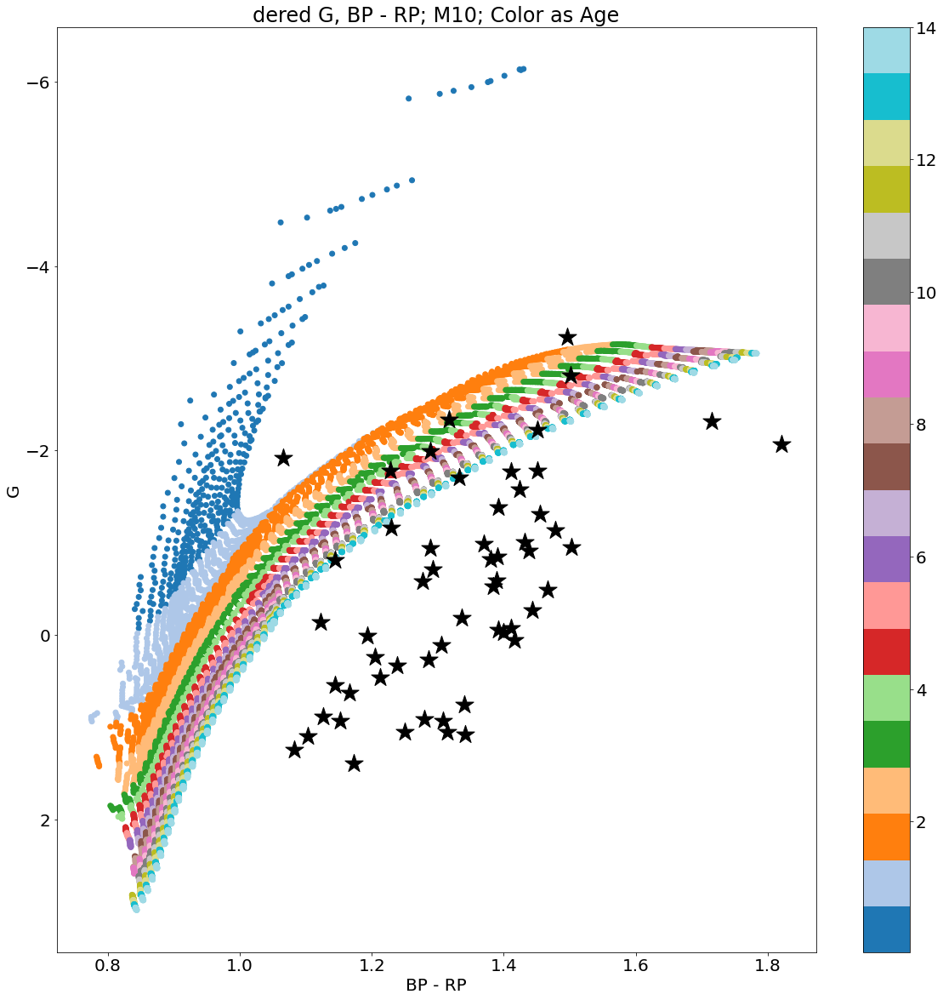

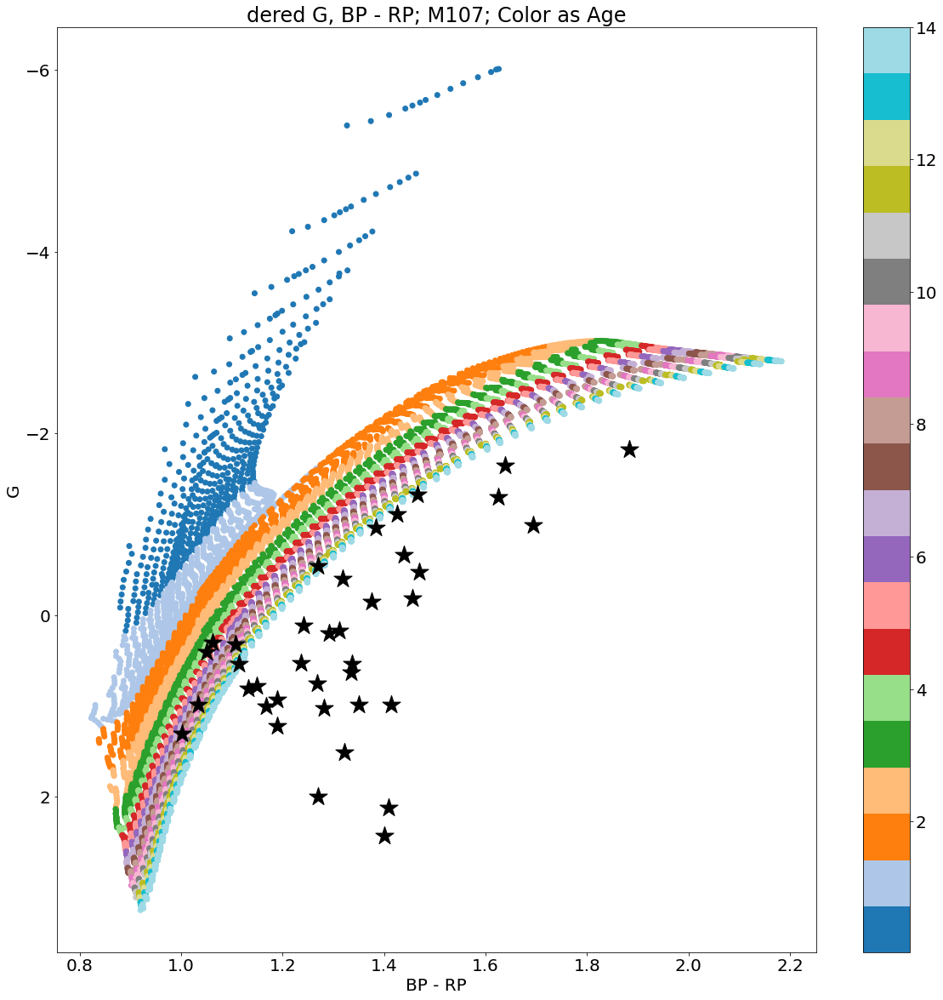

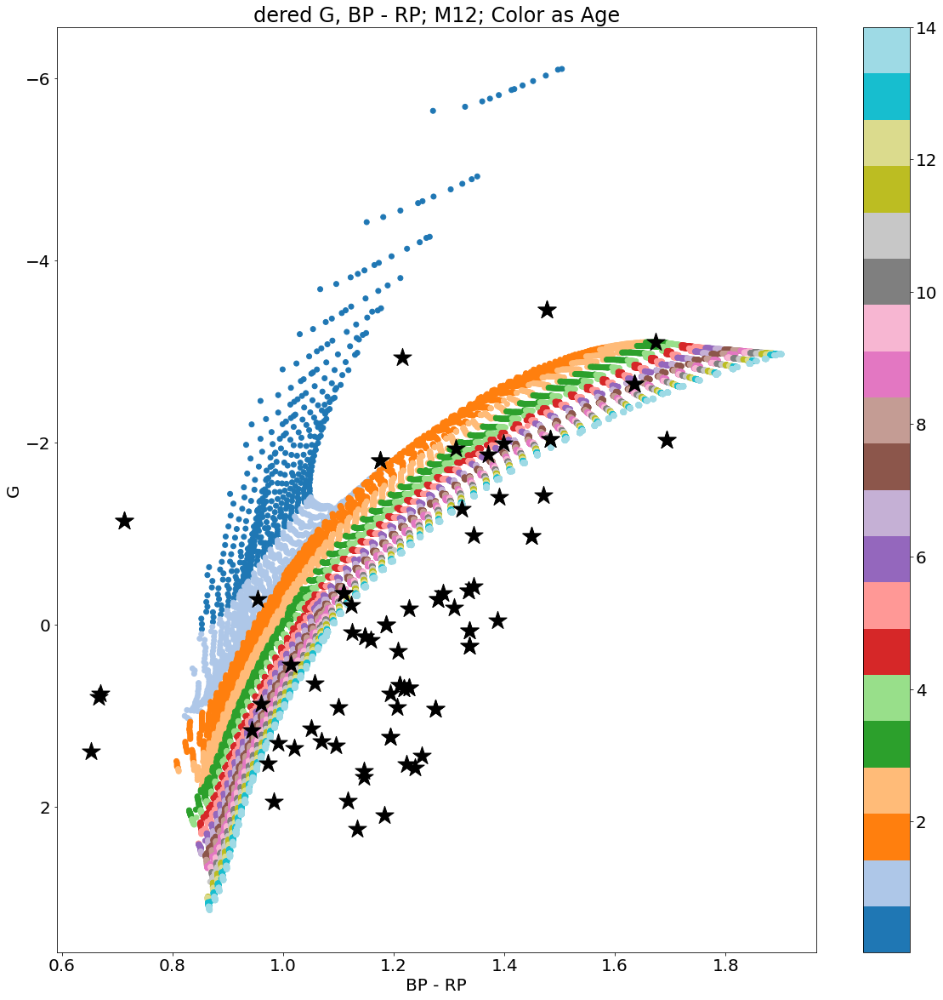

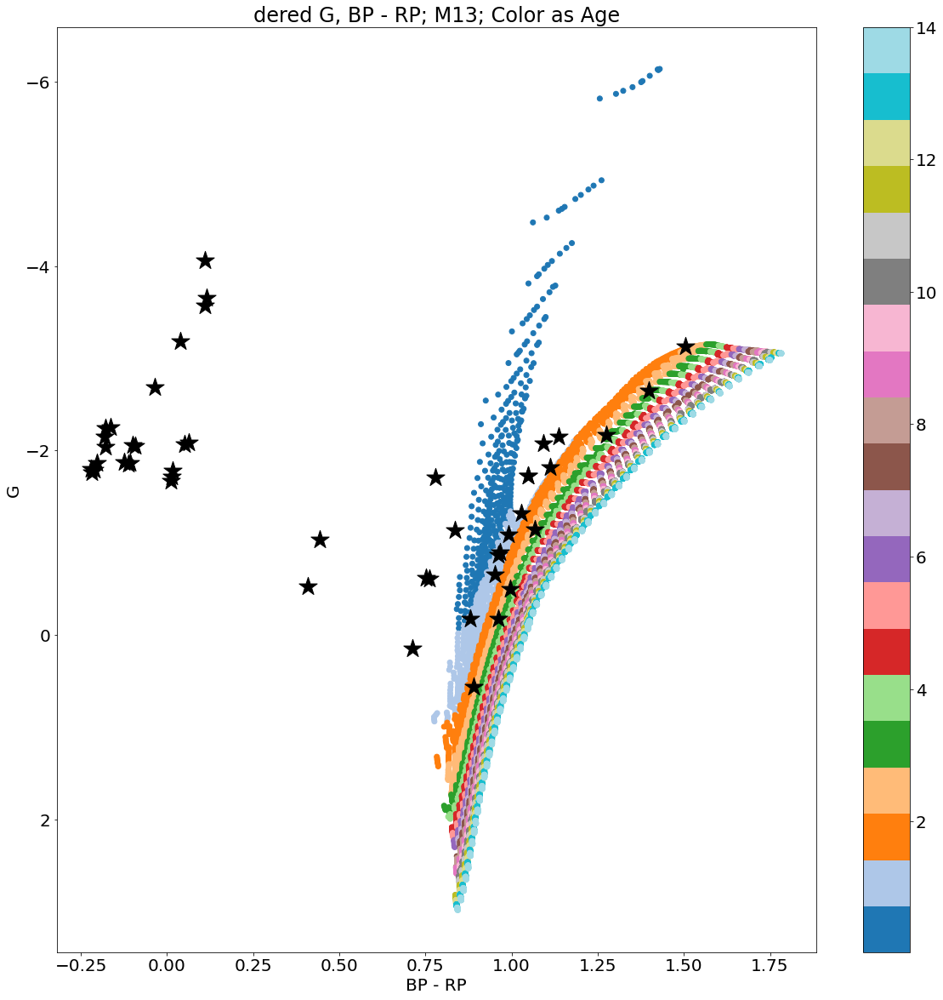

...

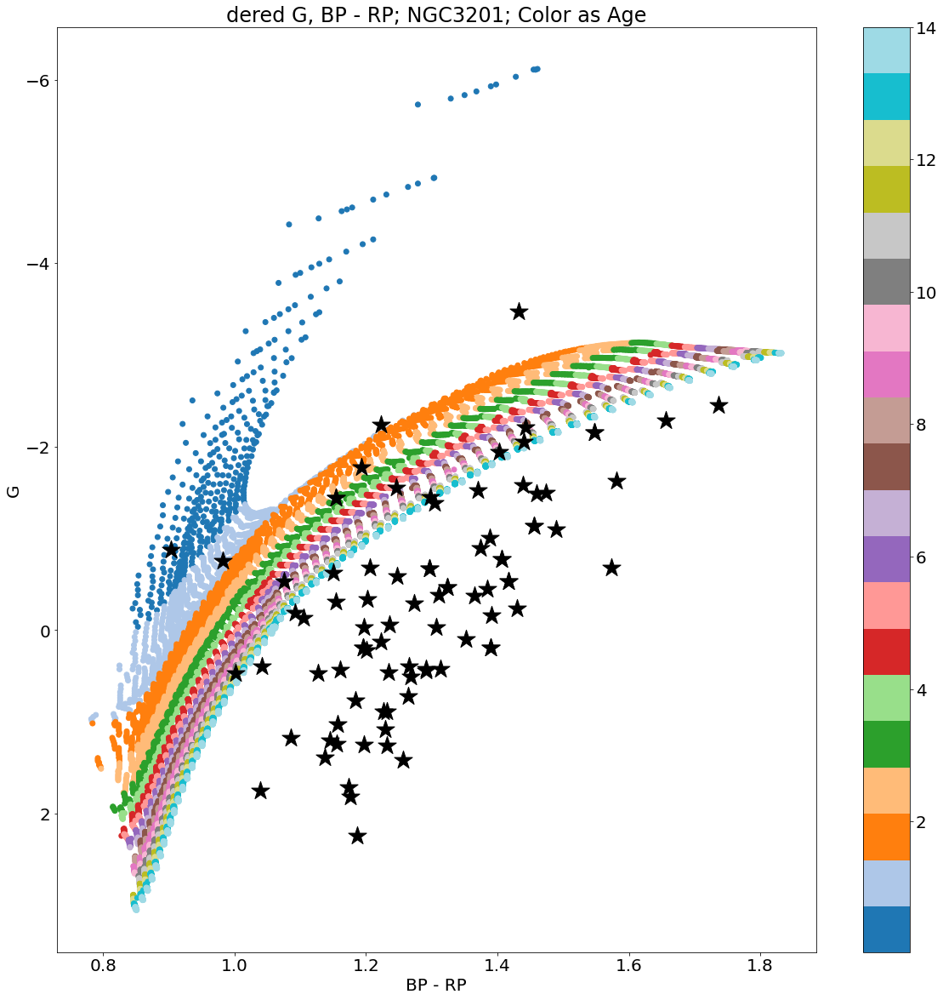

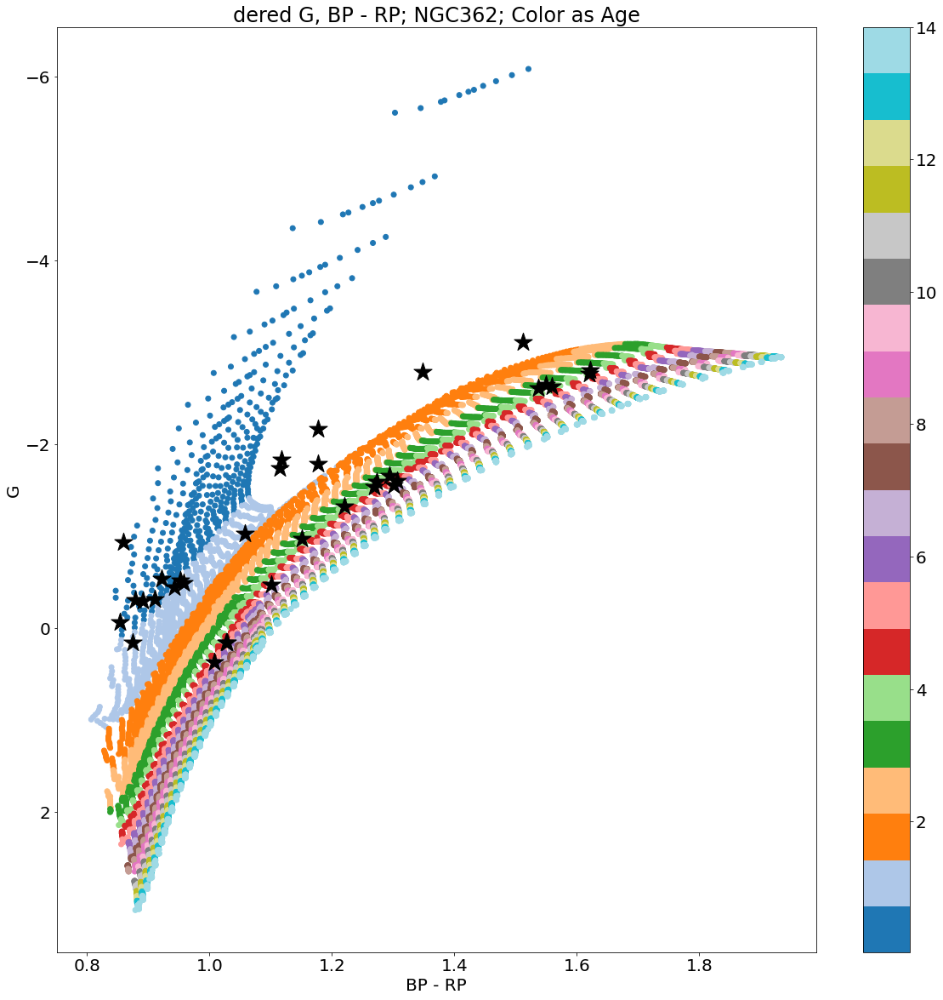

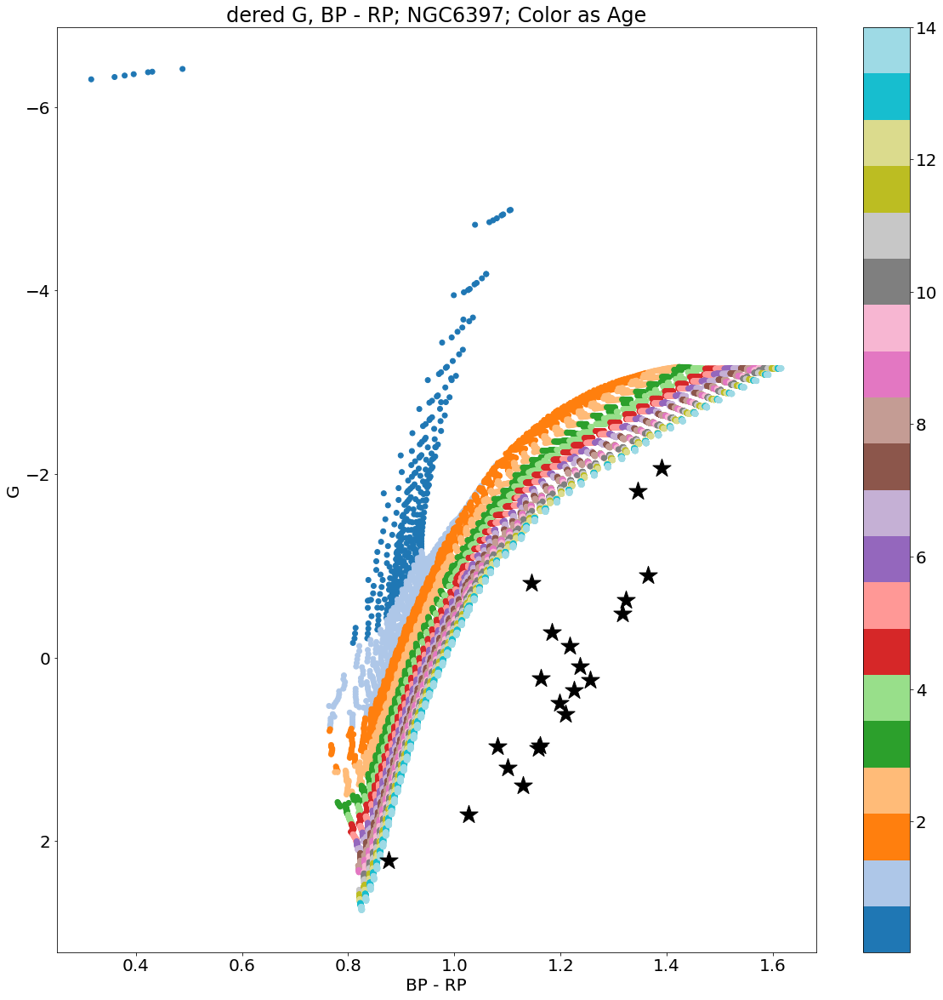

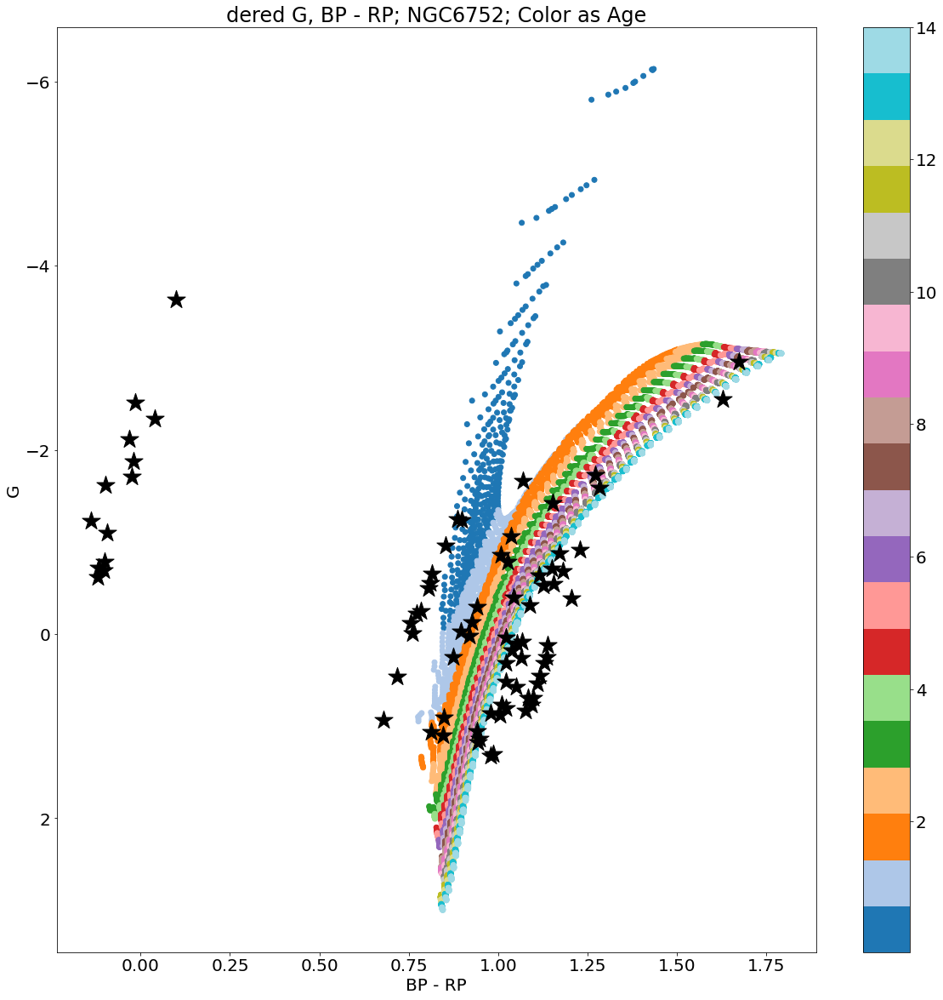

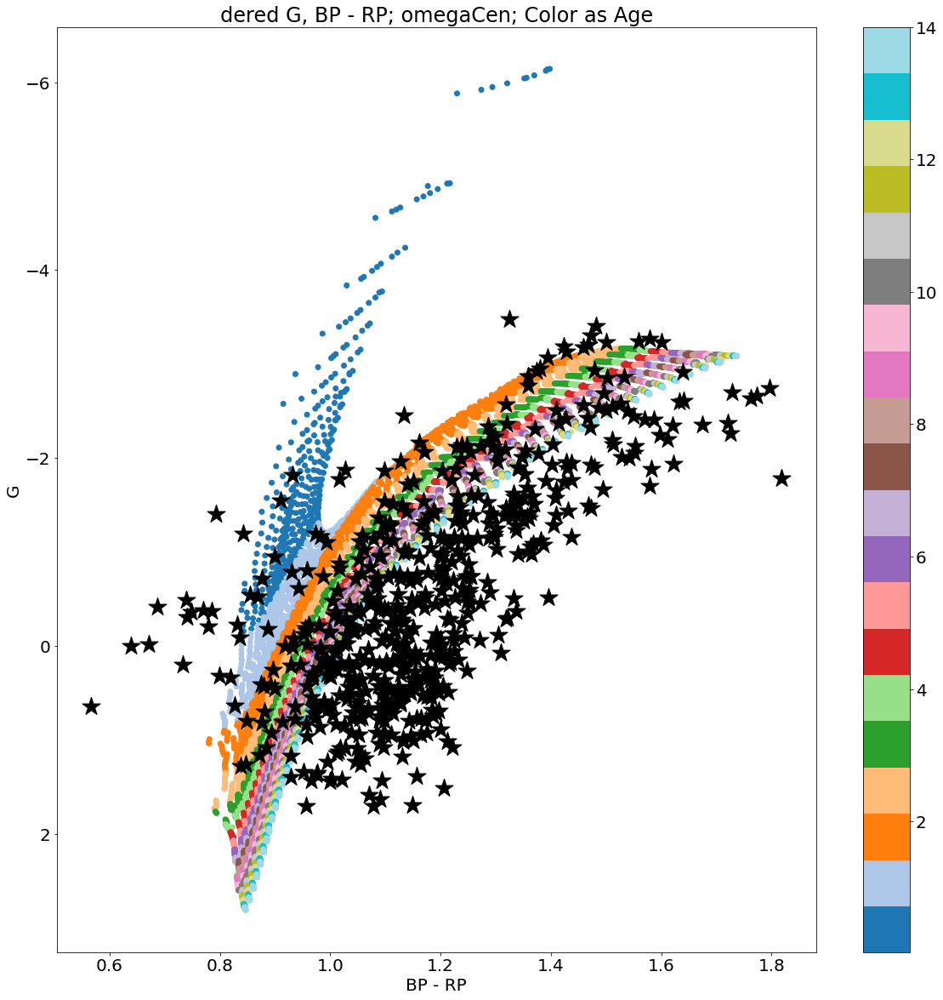

In [43]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['G_BPmag']-massive['G_RPmag'])[isopick],massive['Gmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    plt.scatter((gcs['GAIA_PHOT_BP_MEAN_MAG']-gcs['GAIA_PHOT_RP_MEAN_MAG']-Ebprp)[clus],
                (gcs['GAIA_PHOT_G_MEAN_MAG']-Ag-5*np.log10(harris[i]*1000)+5)[clus],c='k',marker='*',
                s=500,zorder=2)
    plt.gca().invert_yaxis()
    plt.xlabel(r'BP - RP')
    plt.ylabel(r'G')
    plt.title(r'dered G, BP - RP; {}; Color as Age'.format(gcs_clus[i]))
    plt.show()
    

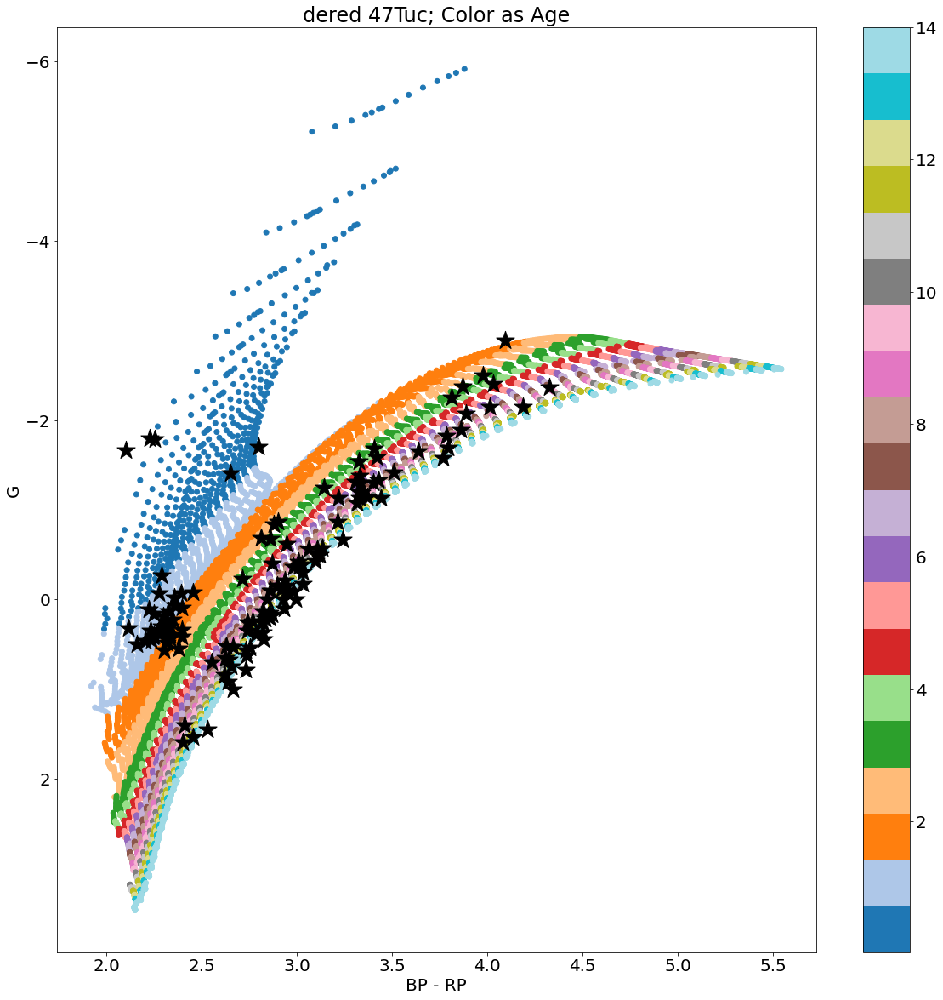

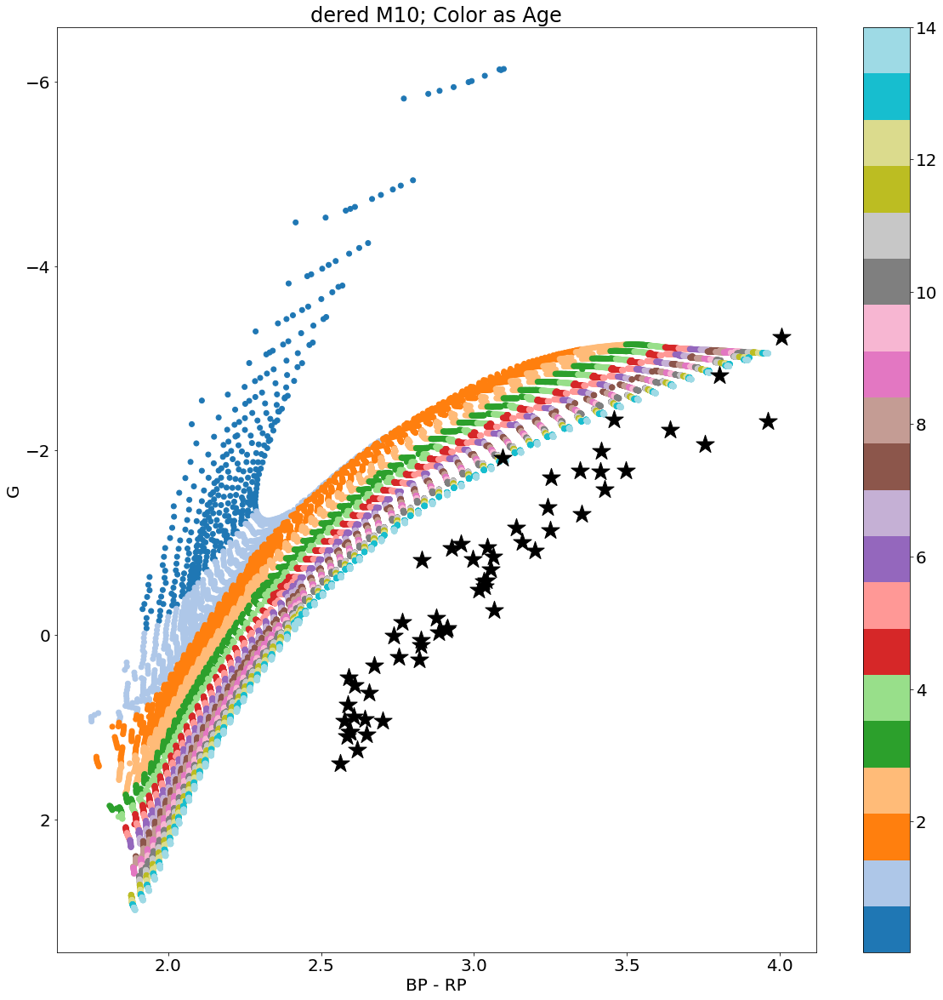

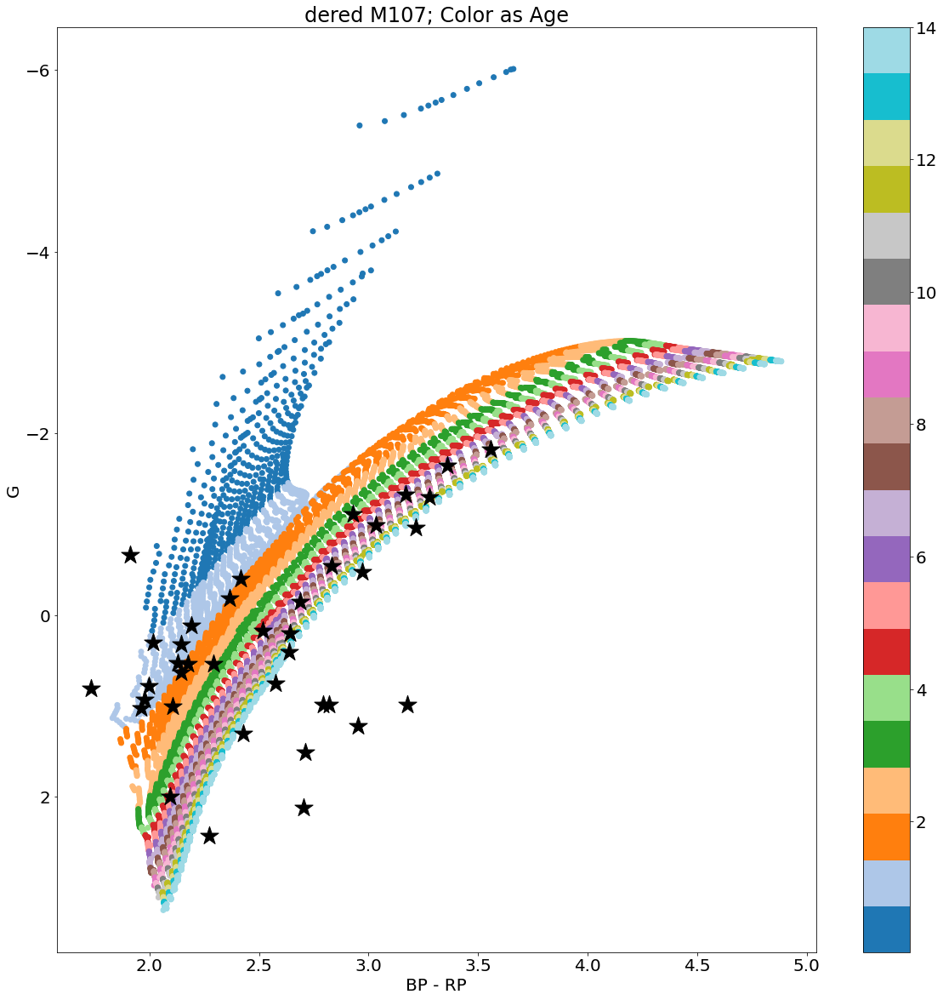

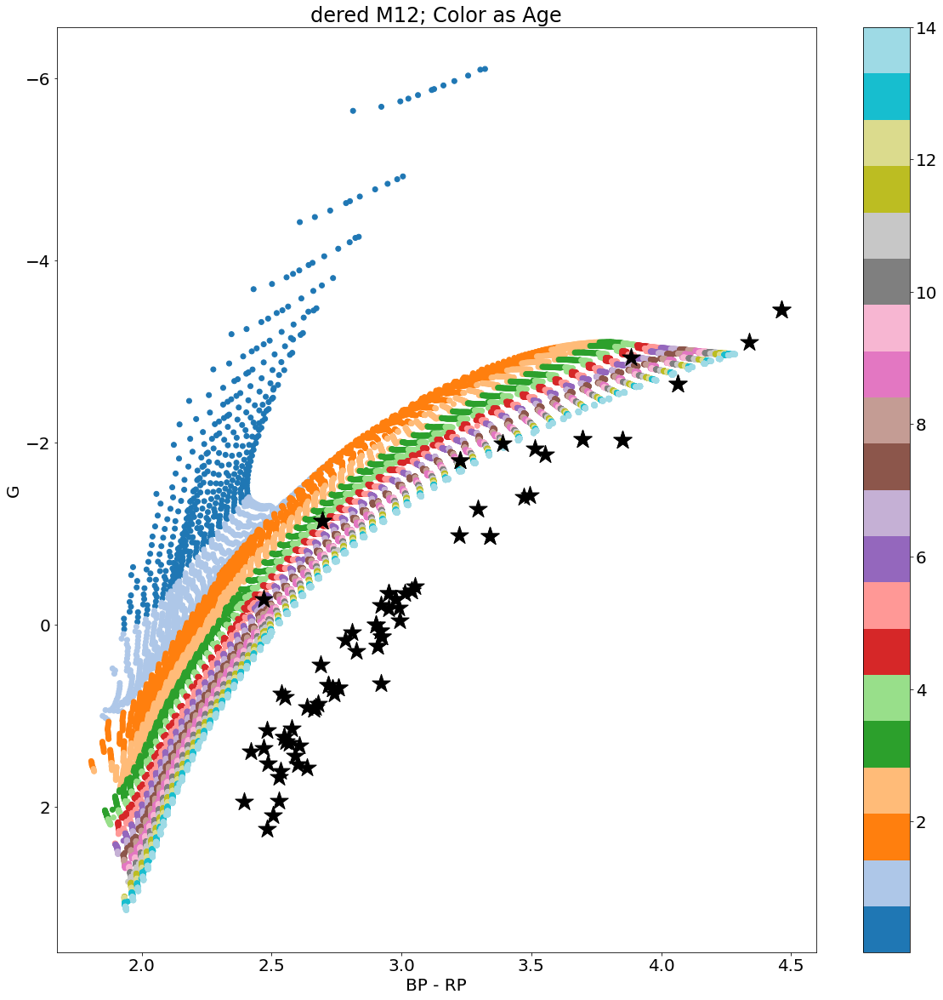

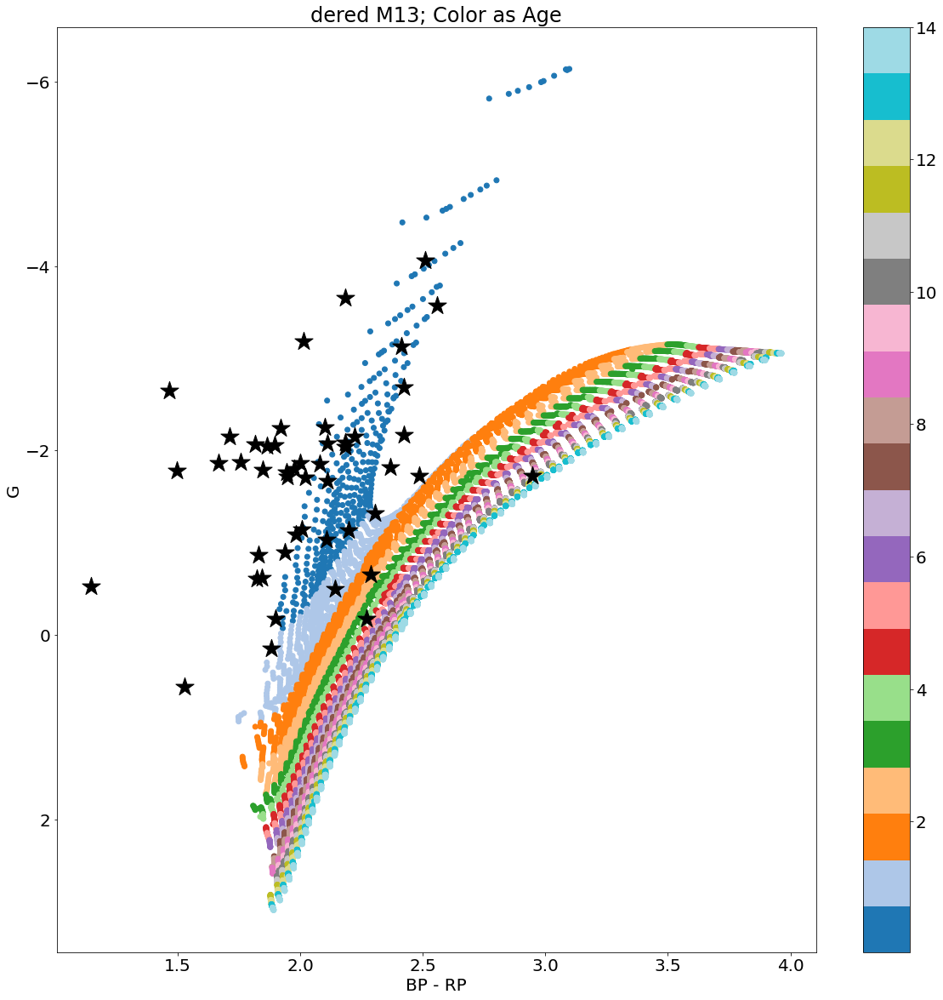

...

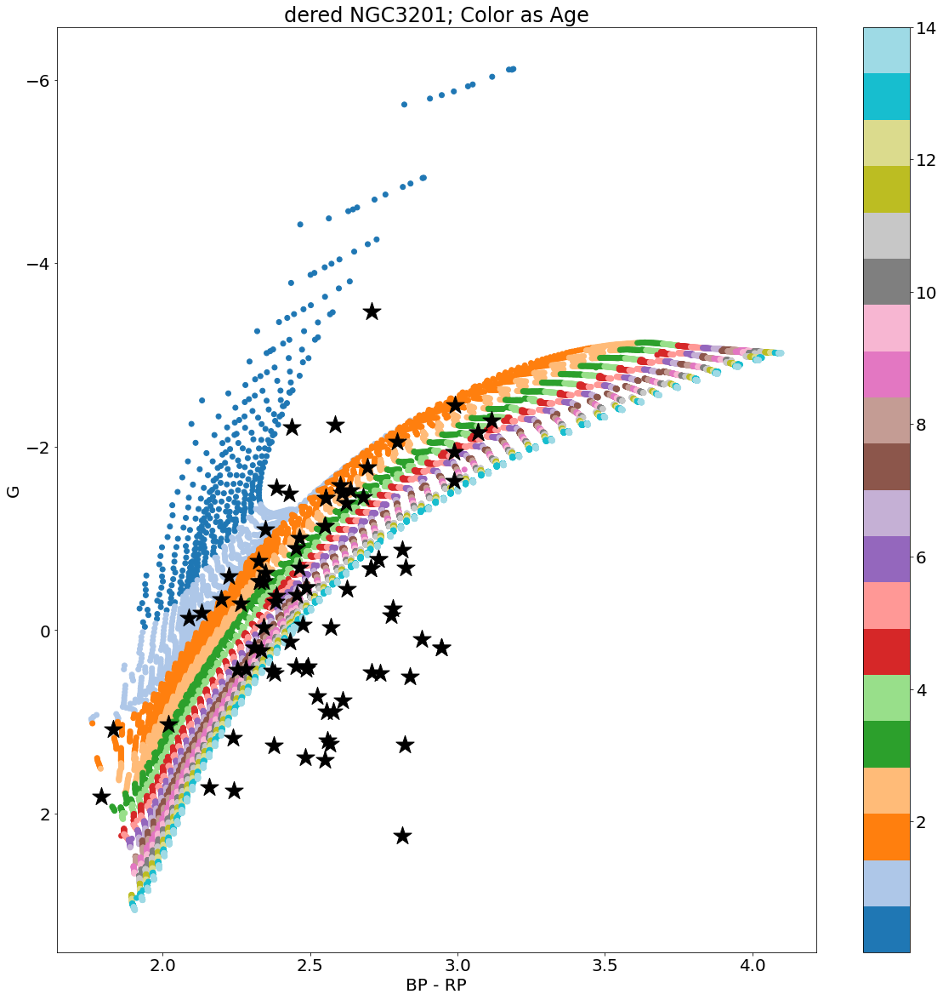

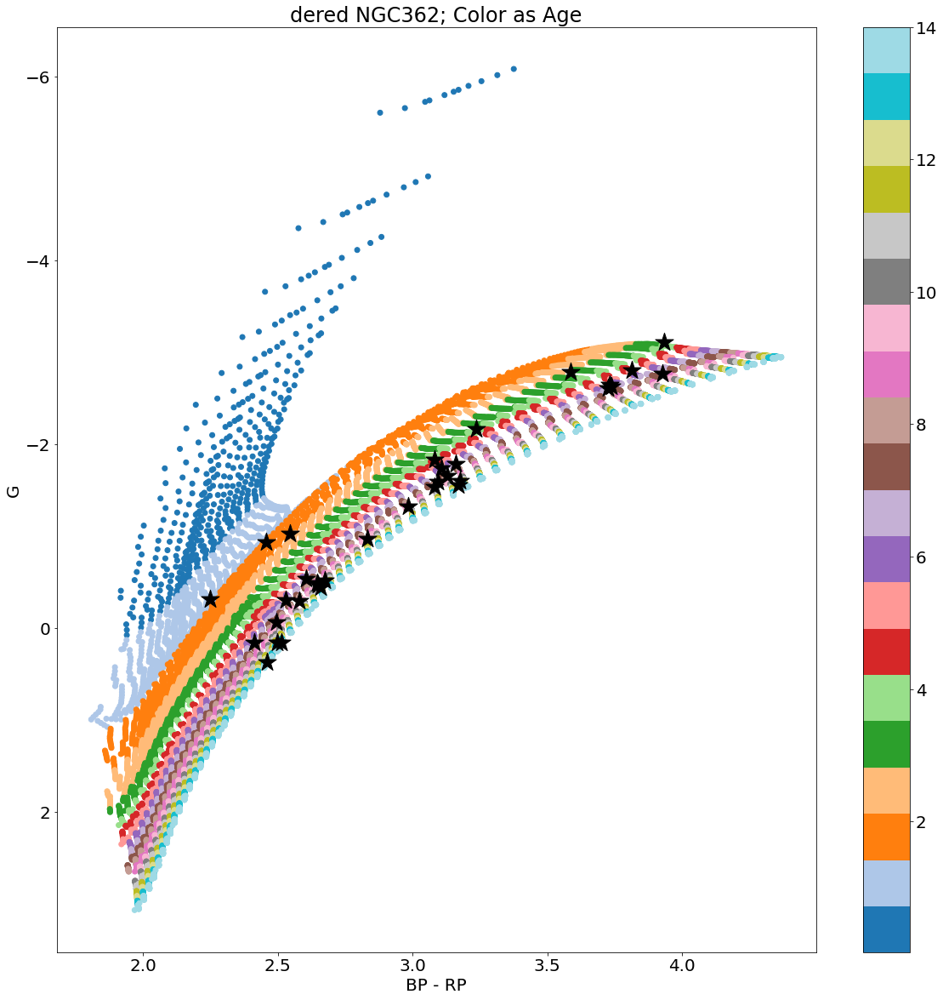

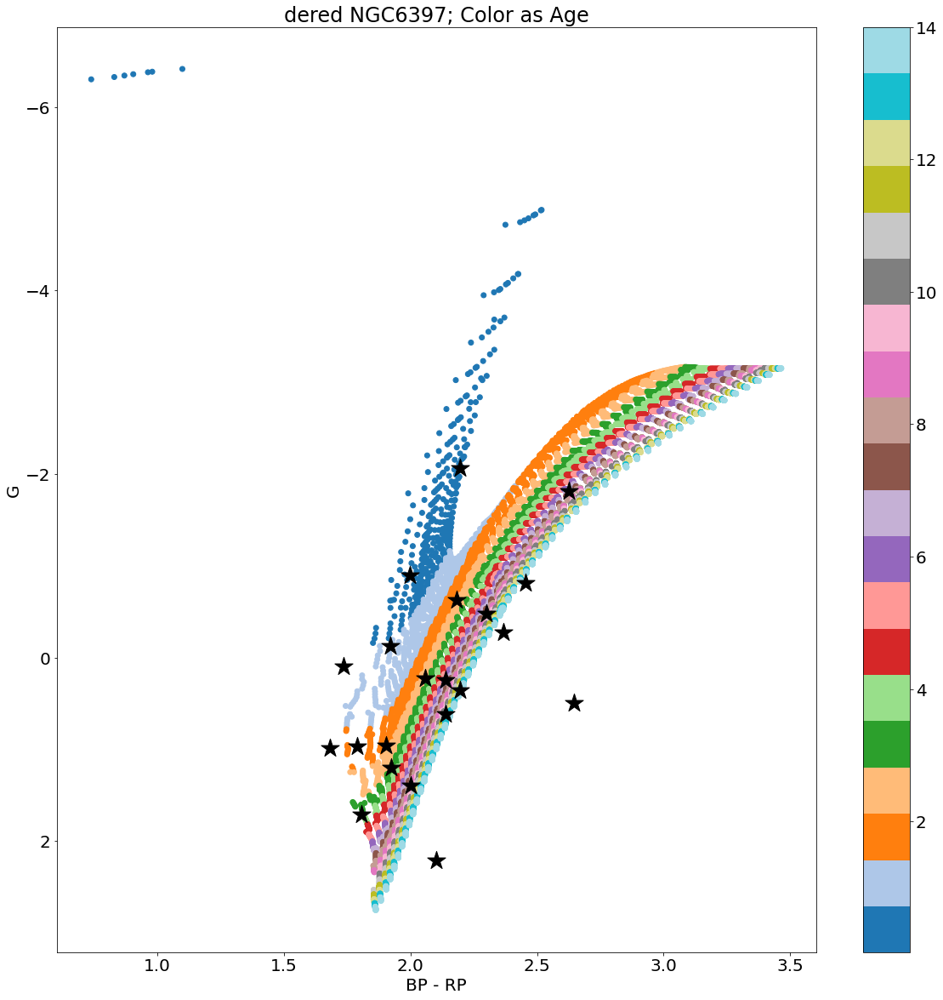

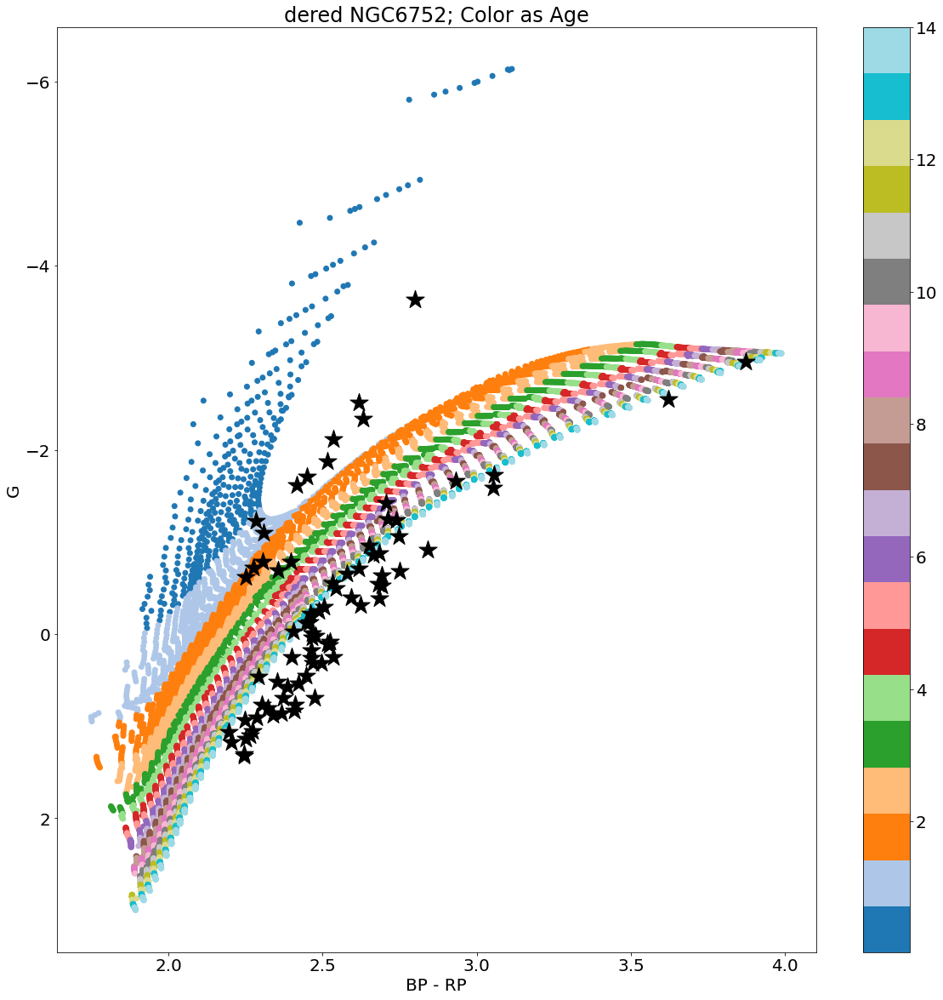

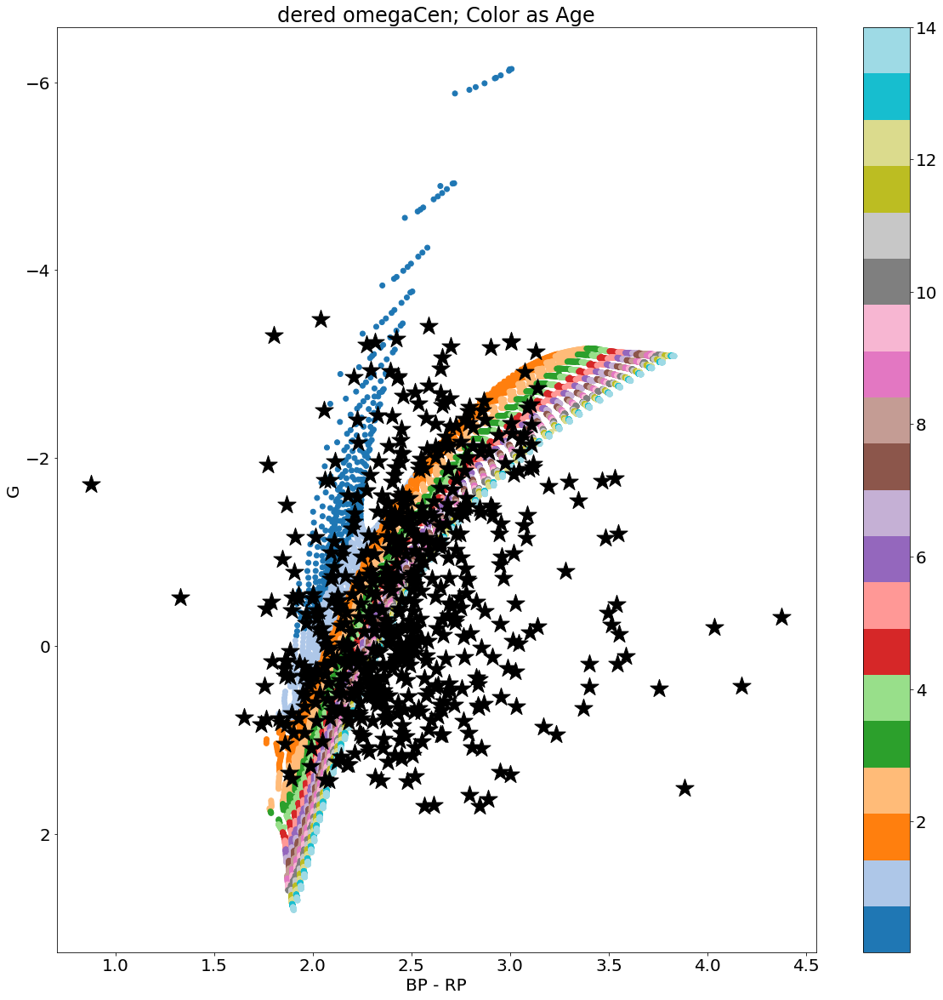

In [44]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['G_BPmag']-massive['Ksmag'])[isopick],massive['Gmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    plt.scatter((gcs['GAIA_PHOT_BP_MEAN_MAG']-gcs['K']-egk_ak*gcs['AK_TARG'])[clus],
                (gcs['GAIA_PHOT_G_MEAN_MAG']-Ag-5*np.log10(harris[i]*1000)+5)[clus],c='k',marker='*',
                s=500,zorder=2)
    plt.gca().invert_yaxis()
    plt.xlabel(r'BP - RP')
    plt.ylabel(r'G')
    plt.title(r'dered {}; Color as Age'.format(gcs_clus[i]))
    plt.show()

# Cut all Gaia stars with no extinction or reddening

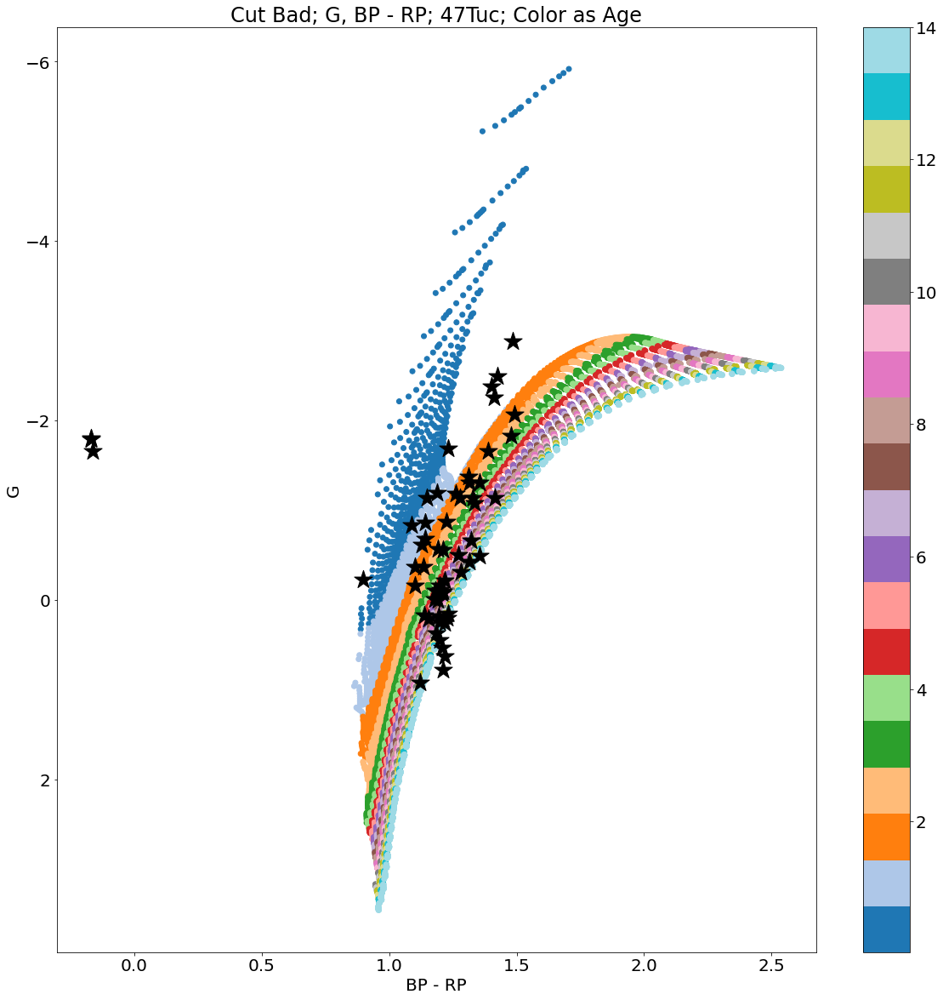

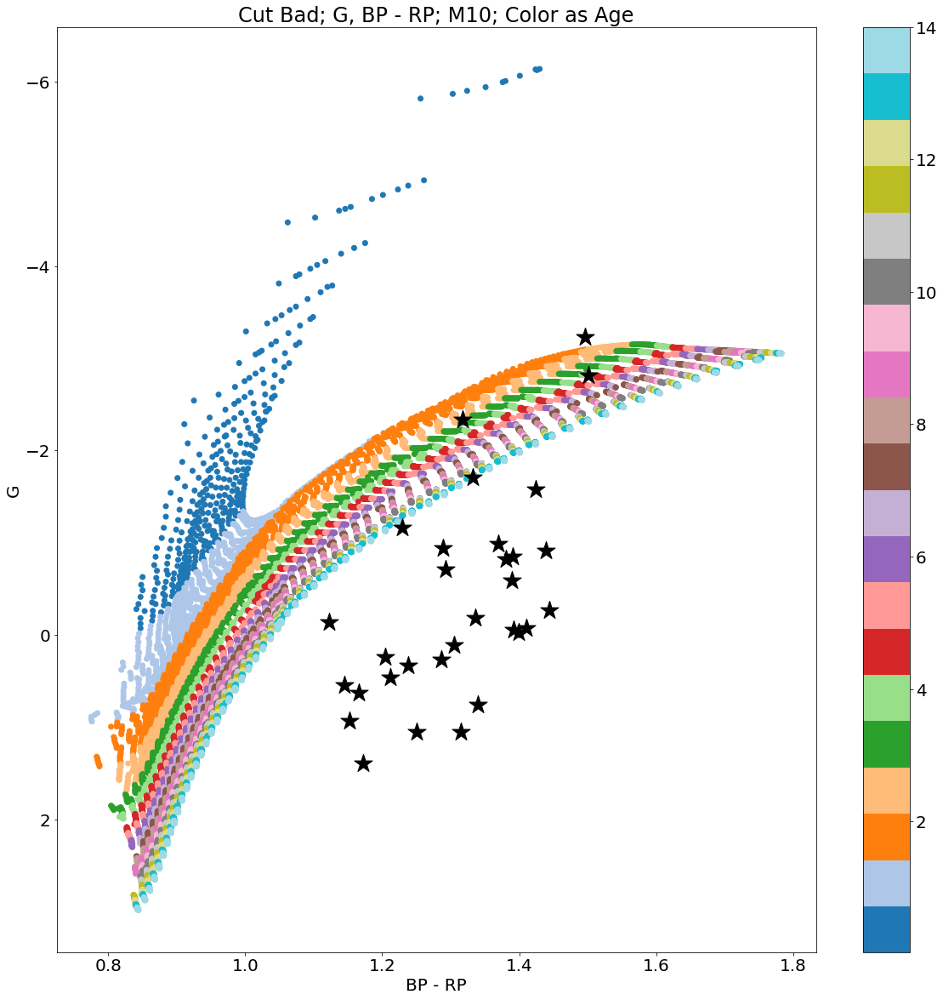

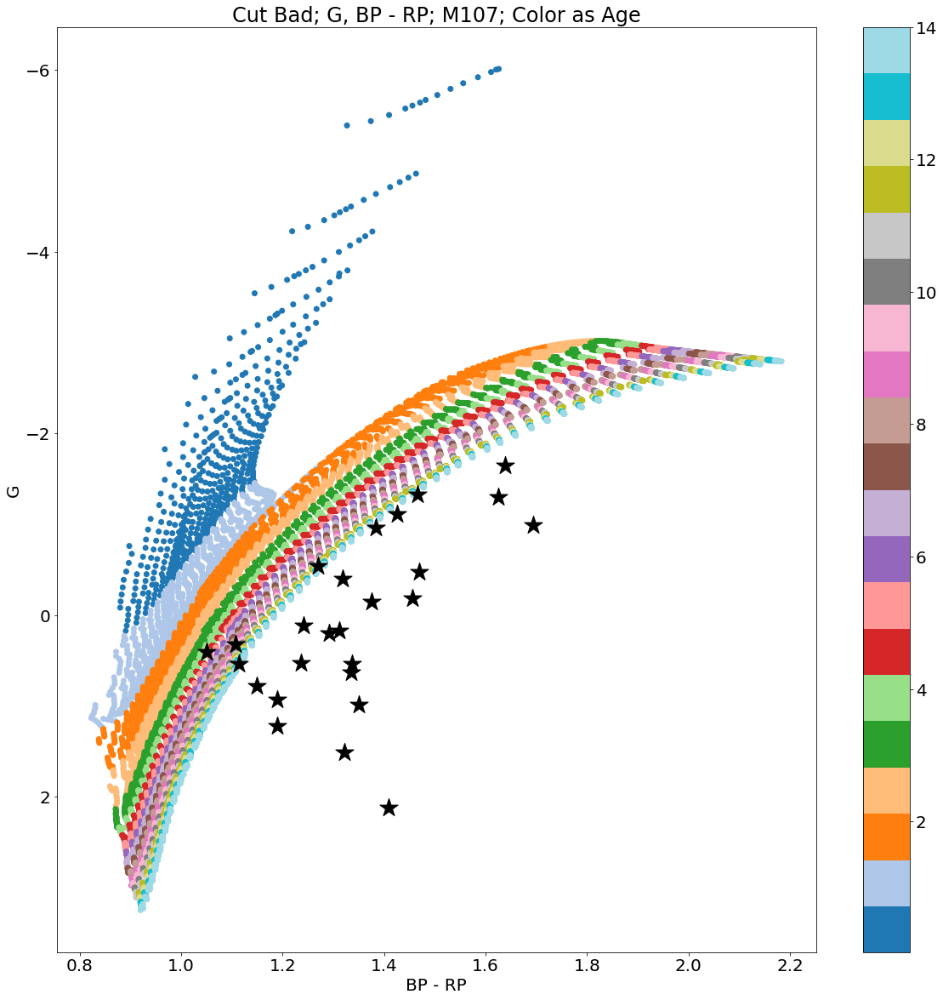

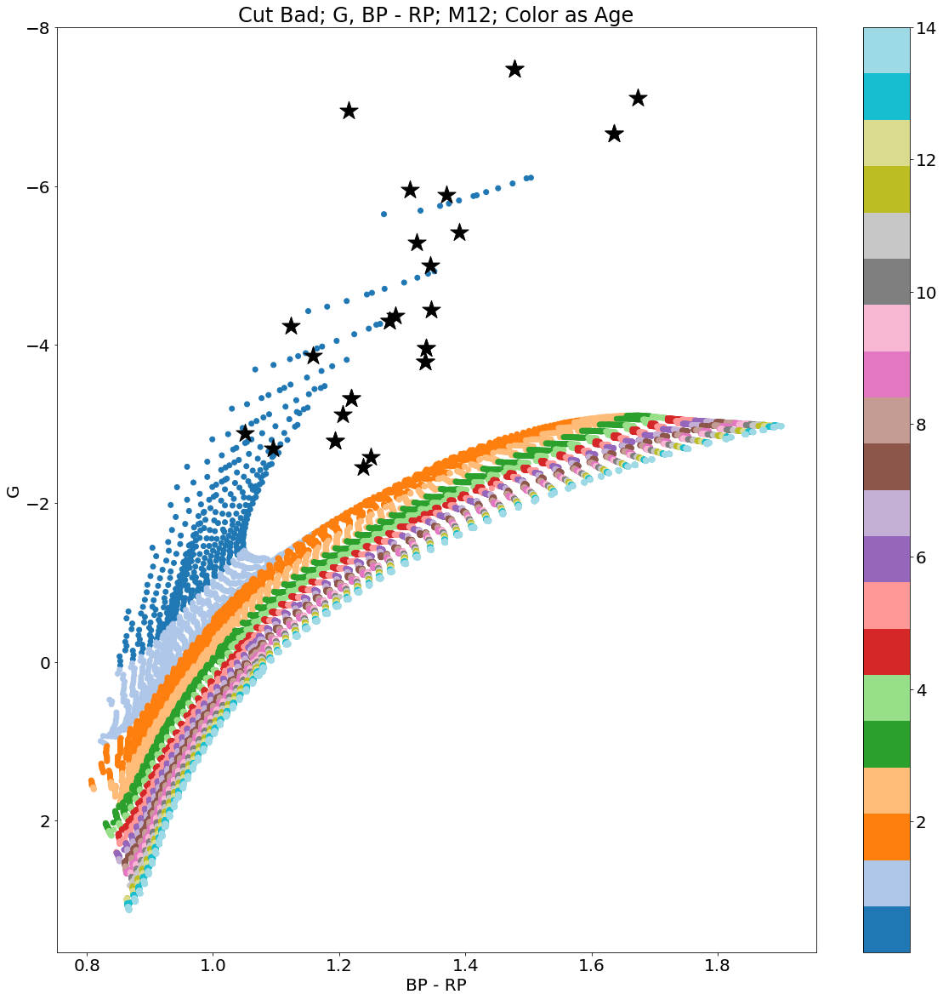

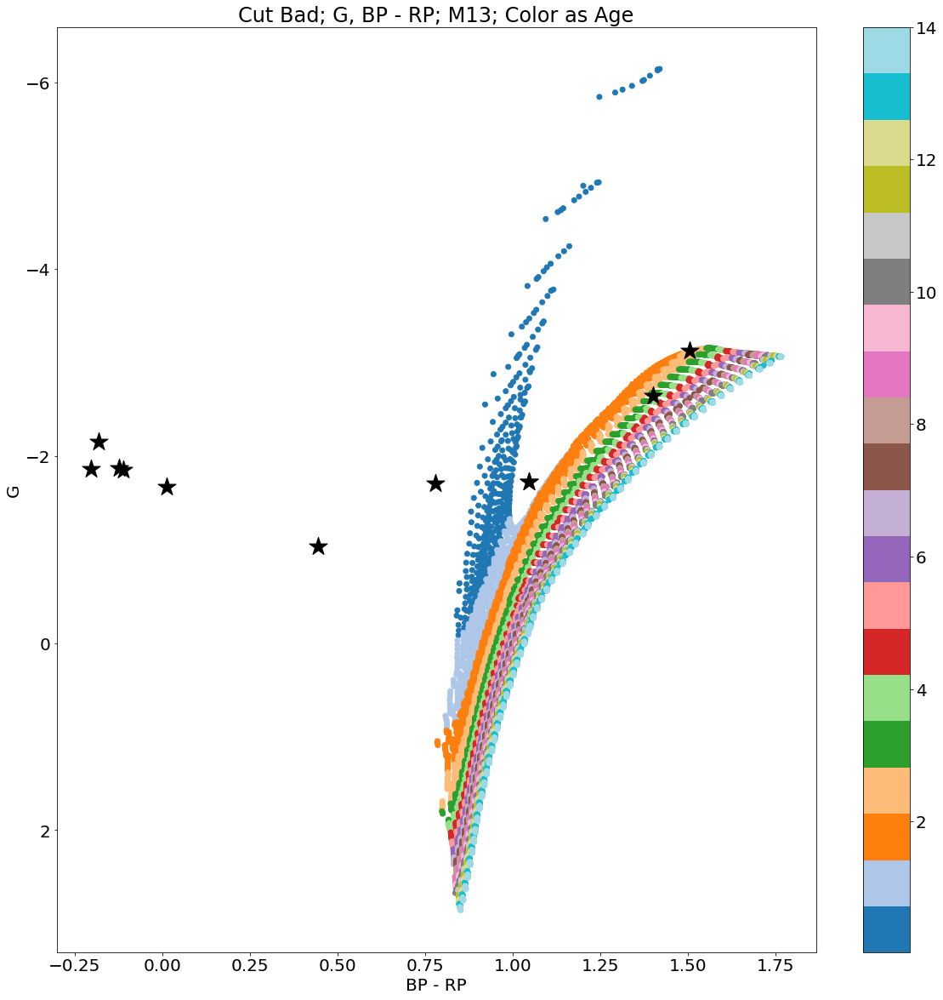

...

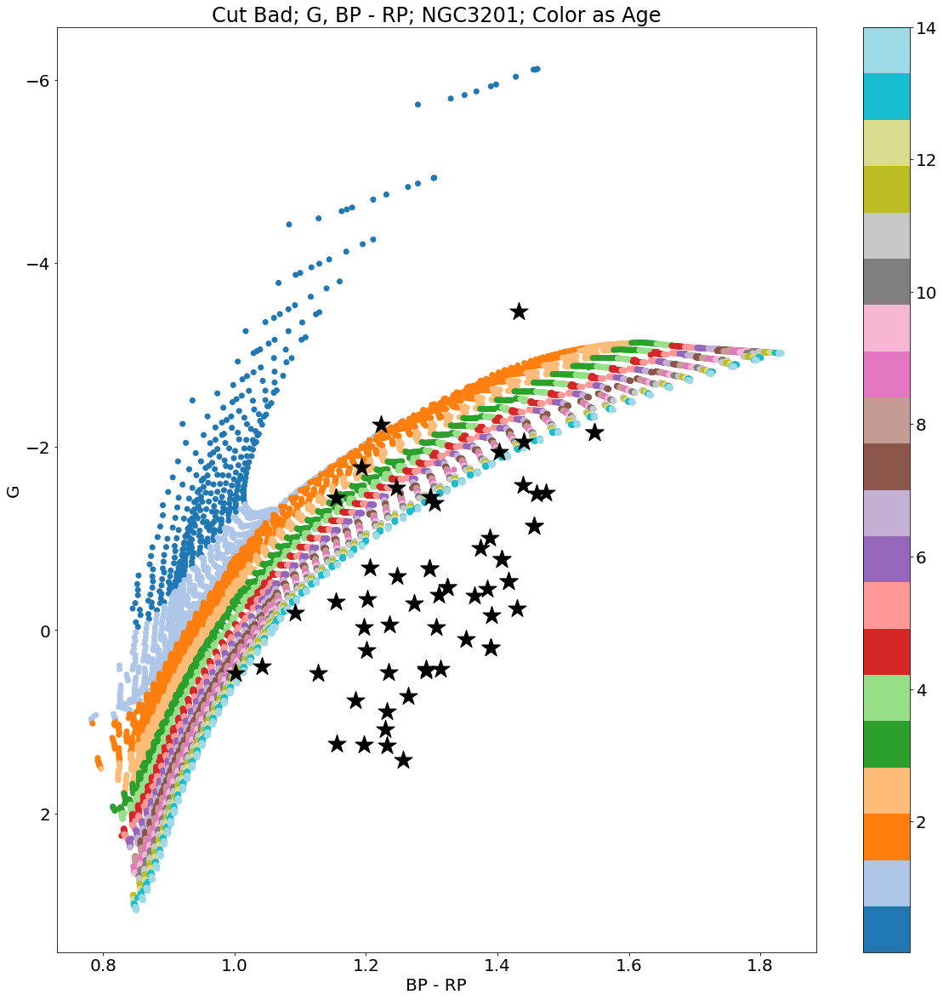

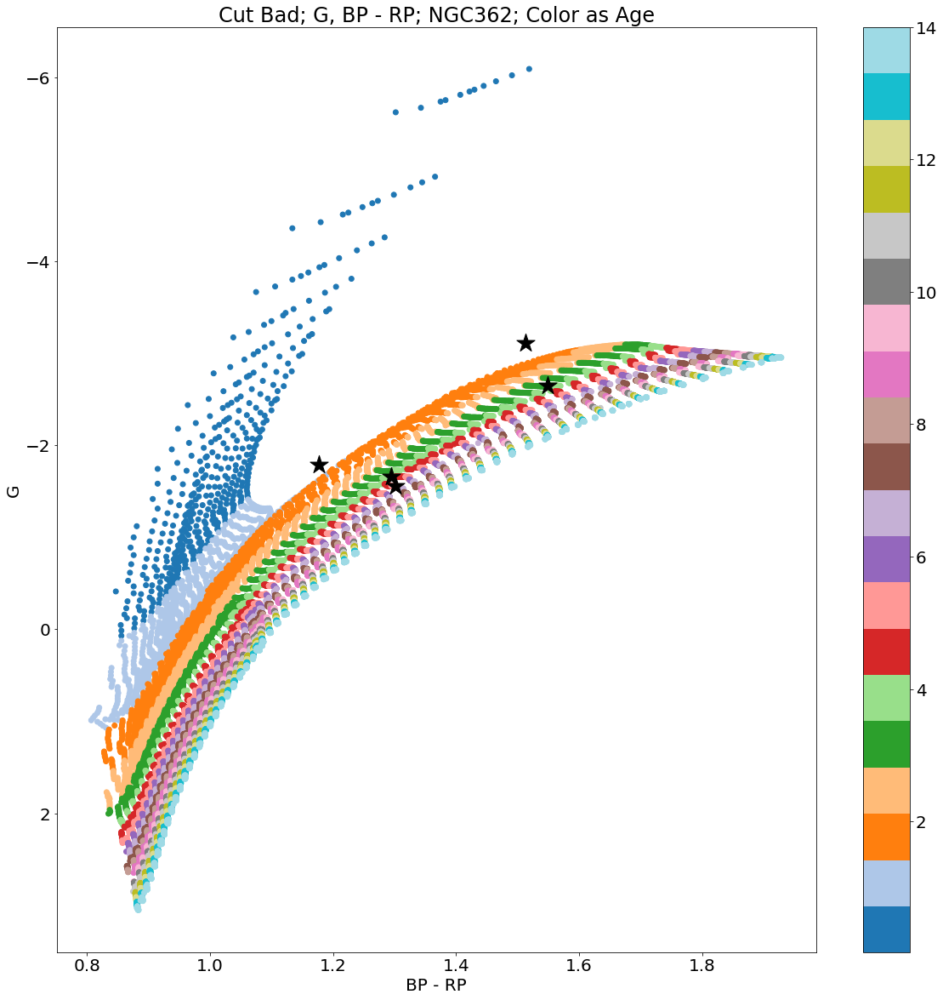

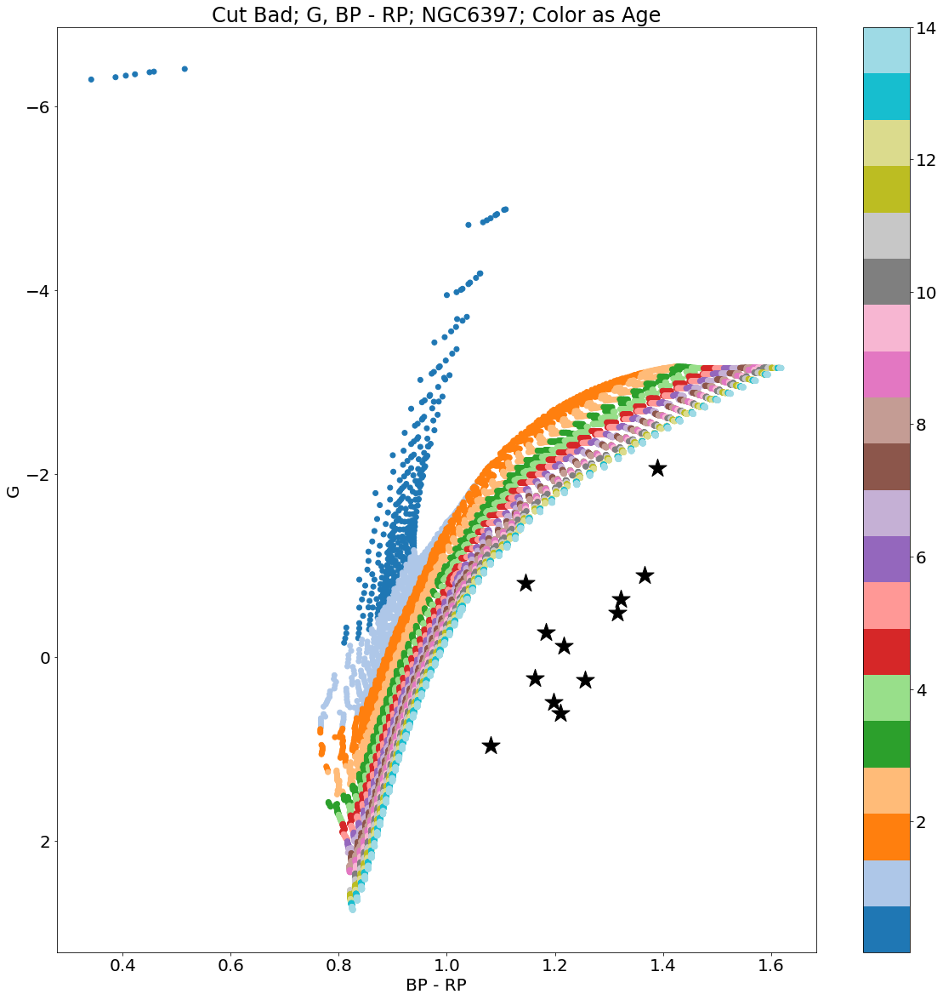

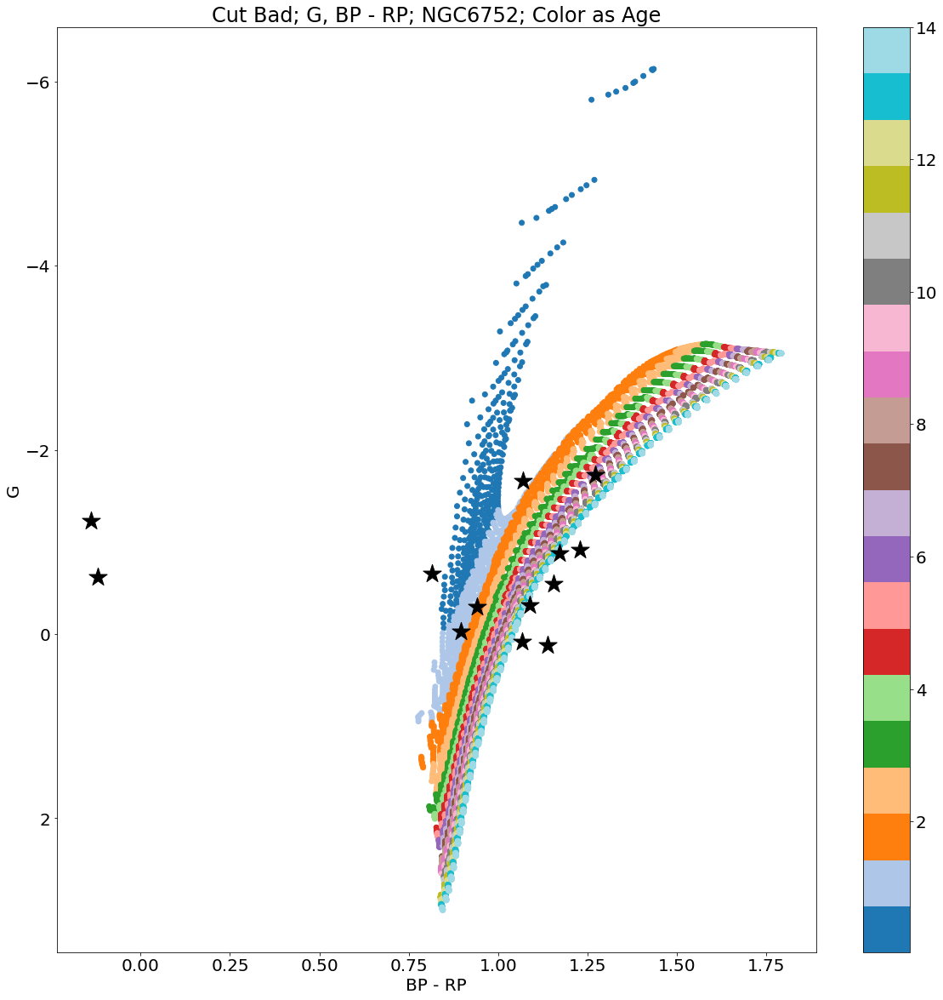

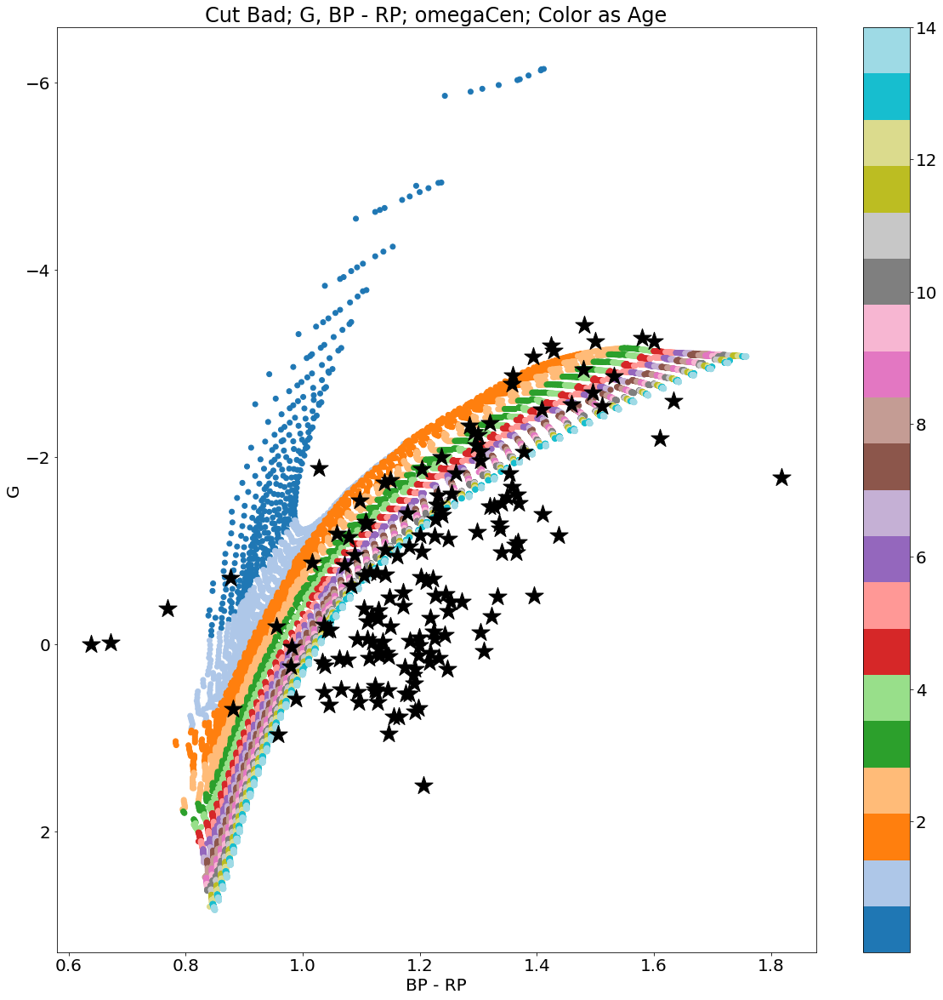

In [28]:
for i in range(len(gcs_clus)):
    clus = np.where((gcs['CLUSTER']==gcs_clus[i])&(gcs['GAIA_A_G_VAL']!=-9999.0))
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['G_BPmag']-massive['G_RPmag'])[isopick],massive['Gmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    plt.scatter((gcs['GAIA_PHOT_BP_MEAN_MAG']-gcs['GAIA_PHOT_RP_MEAN_MAG']-gcs['GAIA_E_BP_MIN_RP_VAL'])[clus],
                (gcs['GAIA_PHOT_G_MEAN_MAG']-gcs['GAIA_A_G_VAL']-5*np.log10(harris[i]*1000)+5)[clus],c='k',
                marker='*',s=500,zorder=2)
    plt.gca().invert_yaxis()
    plt.xlabel(r'BP - RP')
    plt.ylabel(r'G')
    plt.title(r'Cut Bad; G, BP - RP; {}; Color as Age'.format(gcs_clus[i]))
    plt.show()

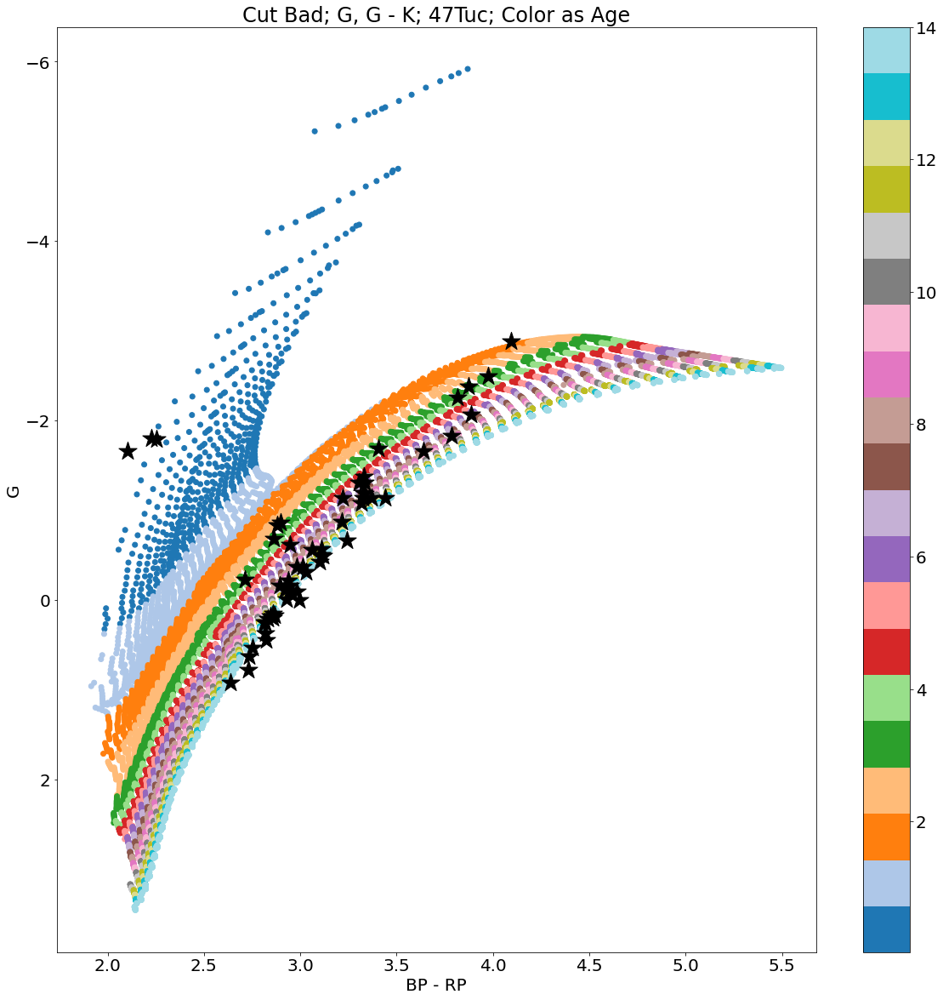

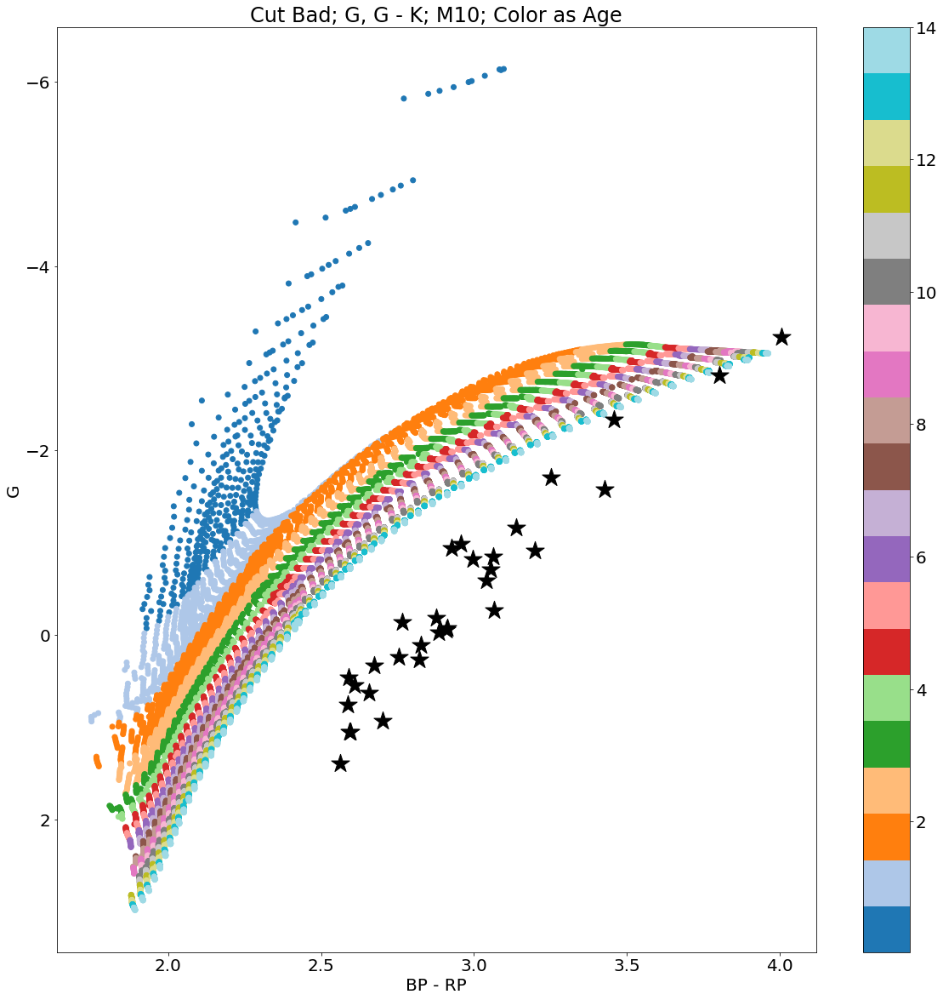

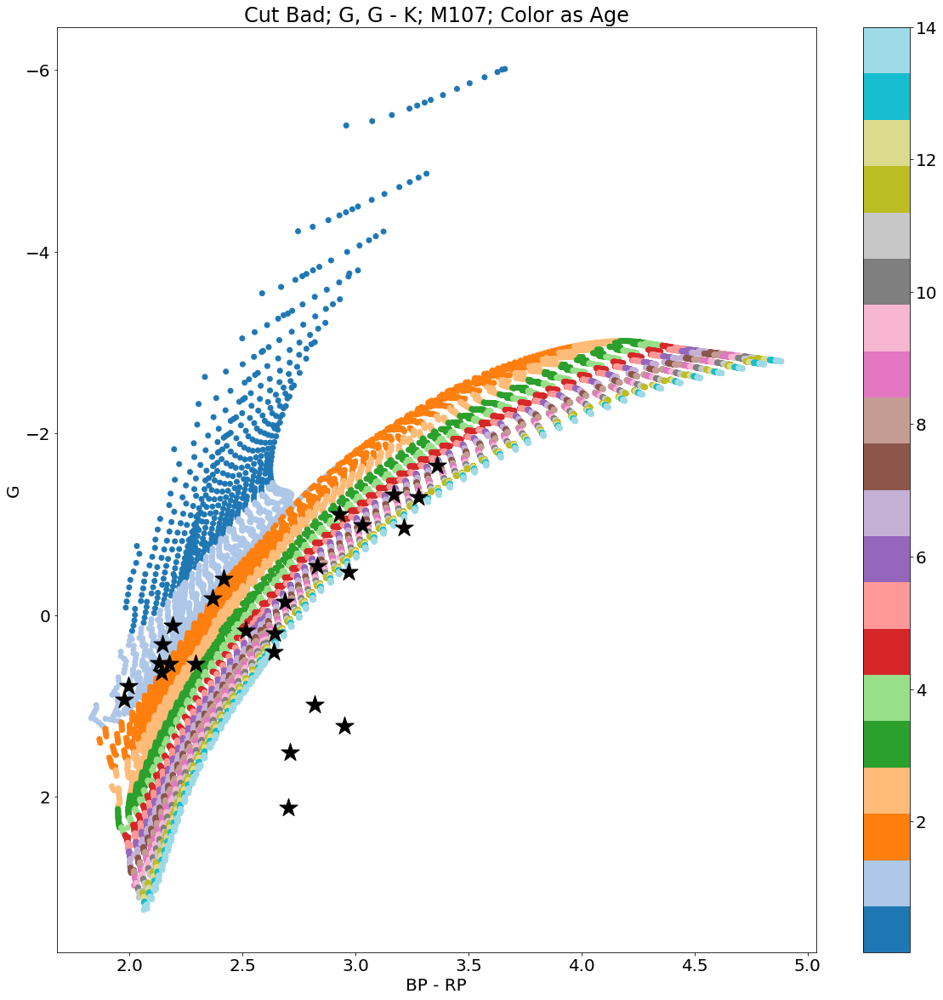

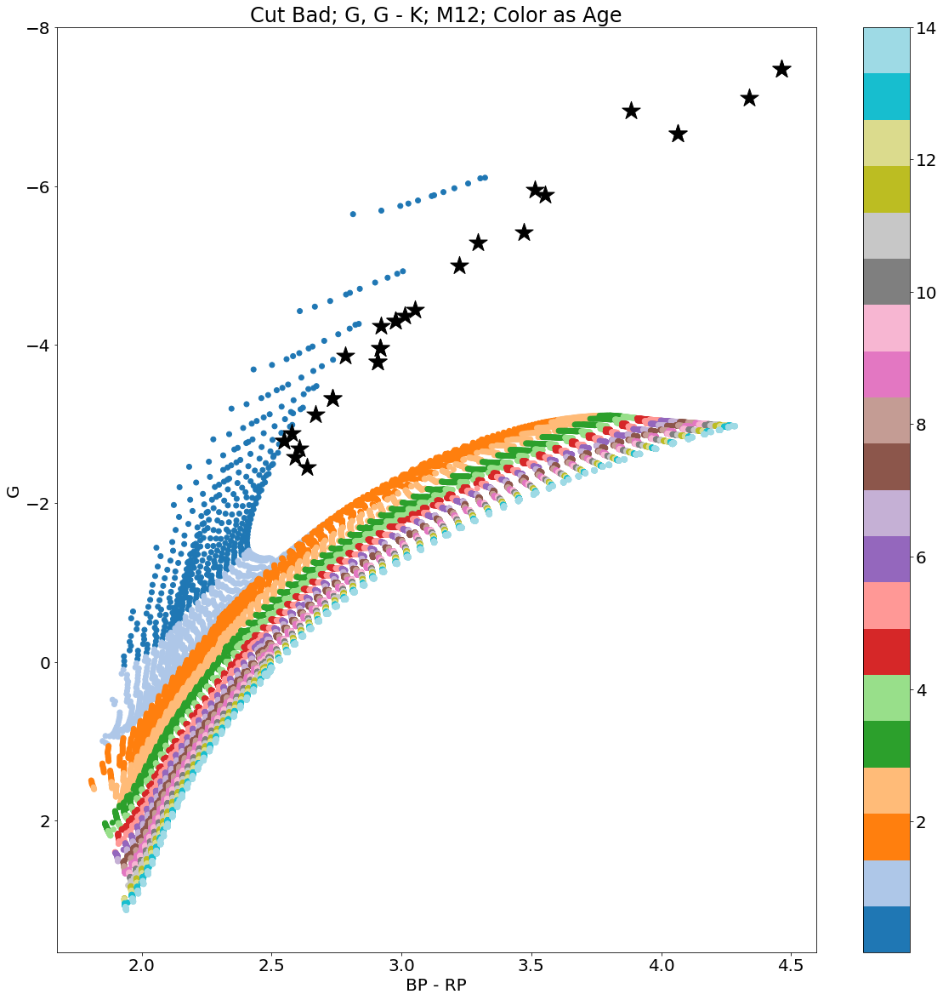

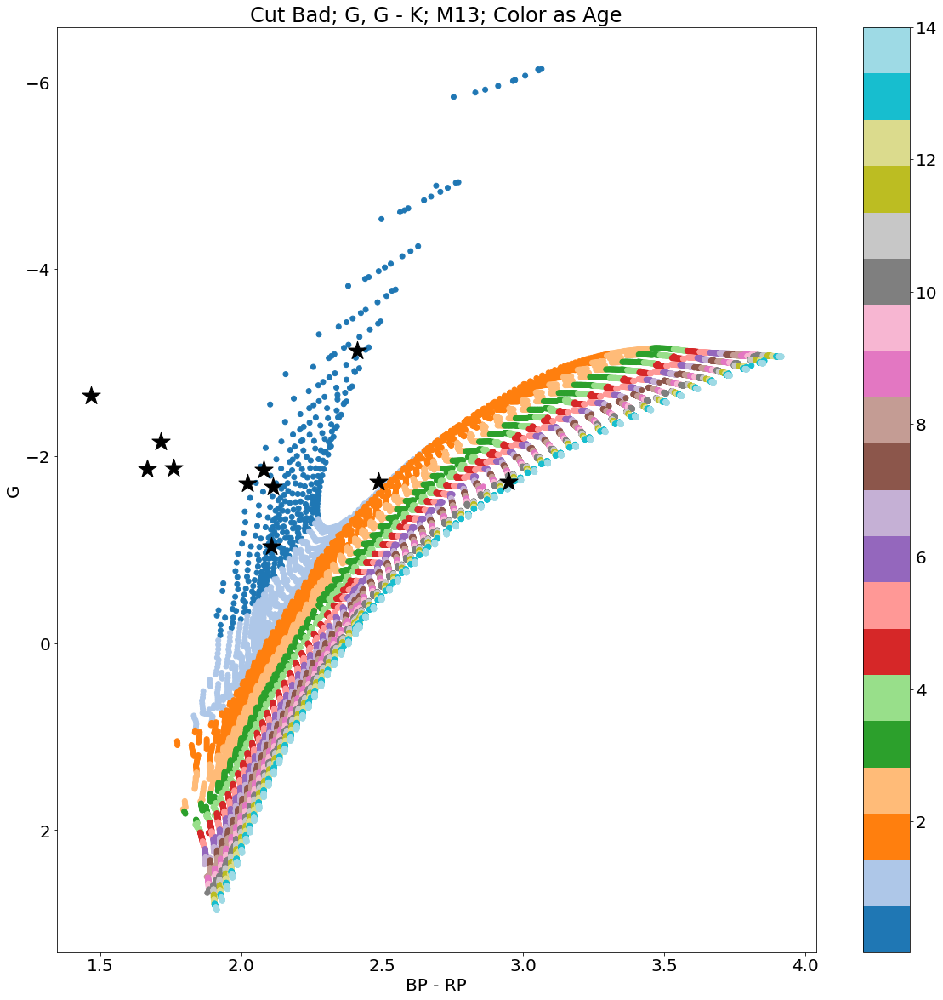

...

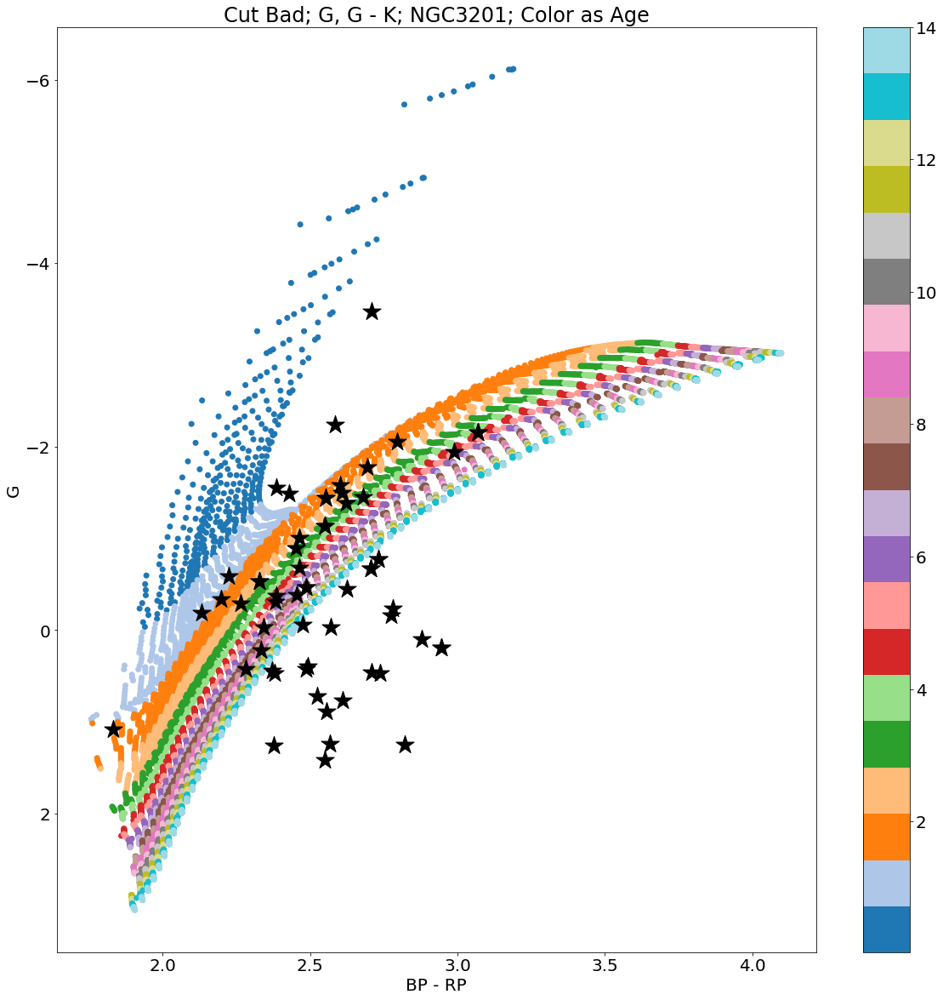

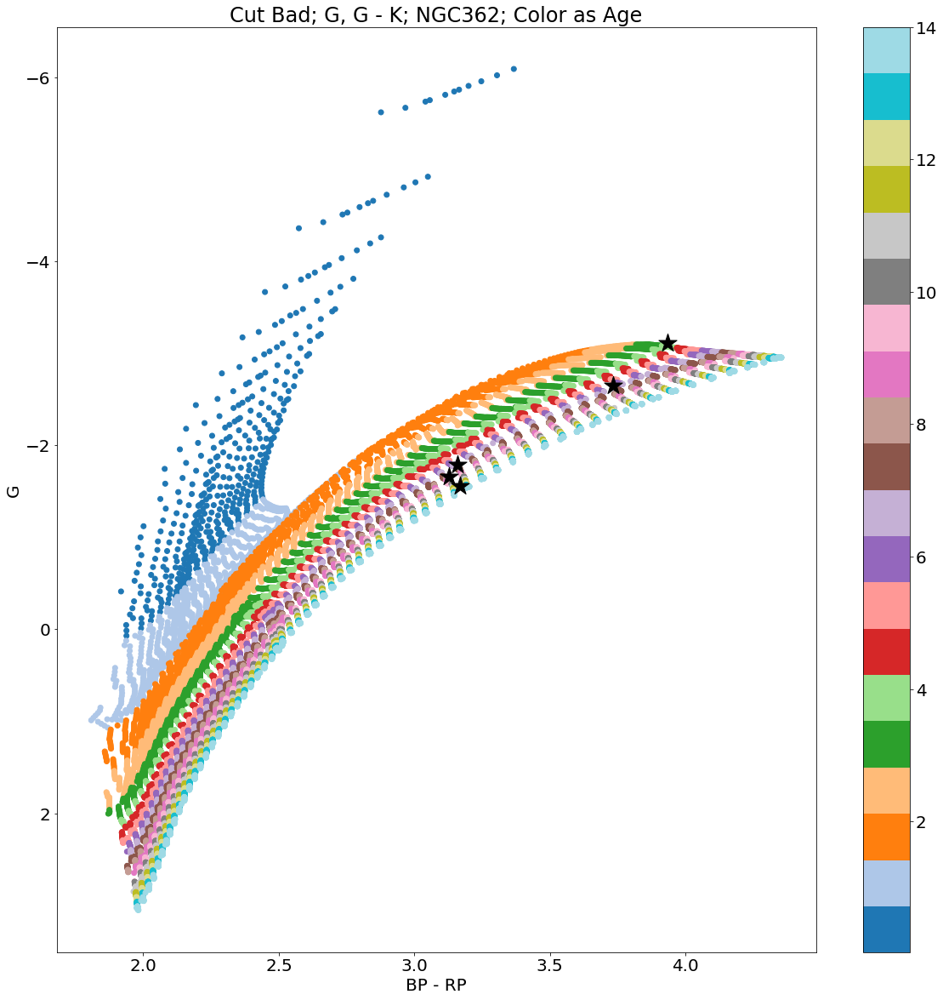

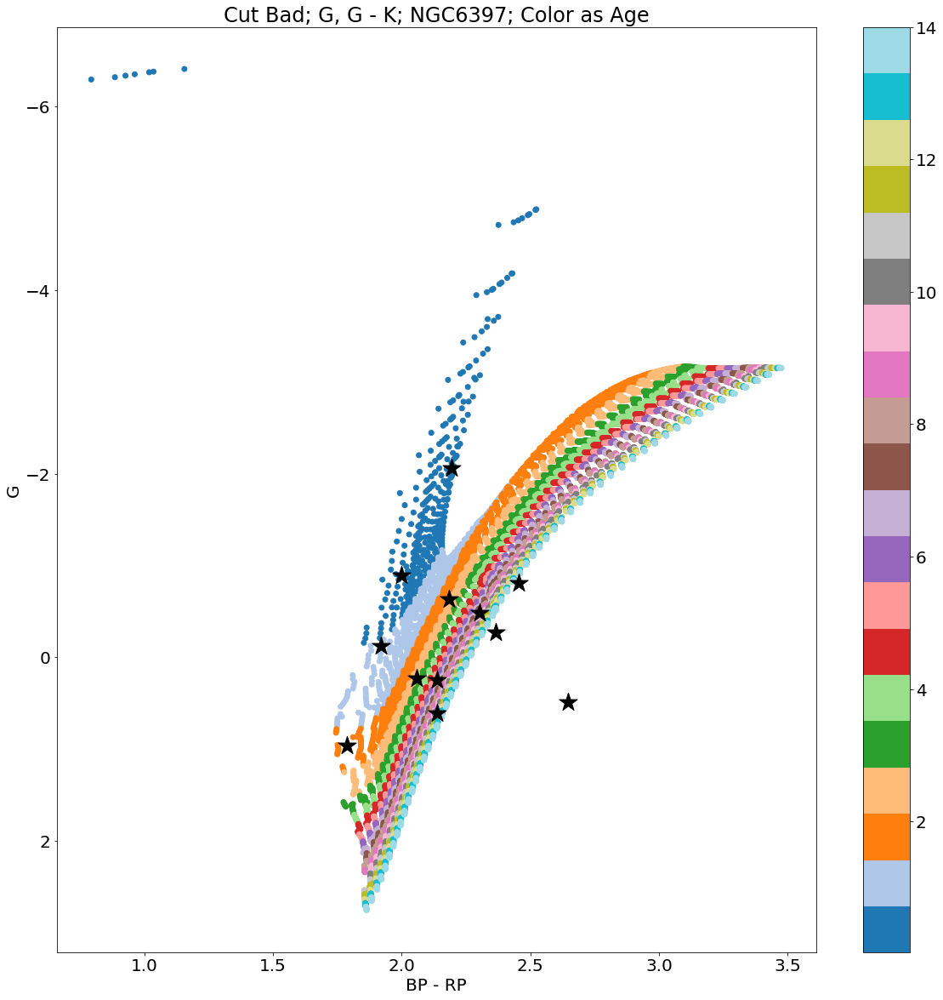

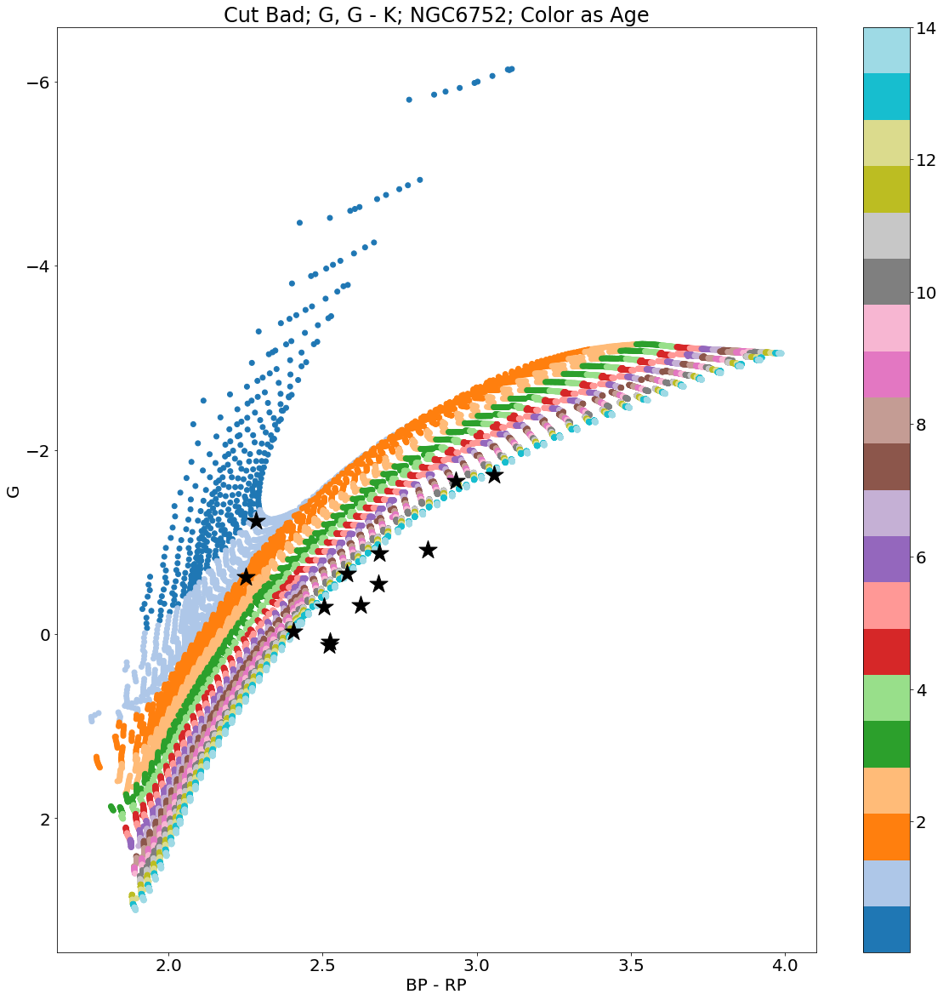

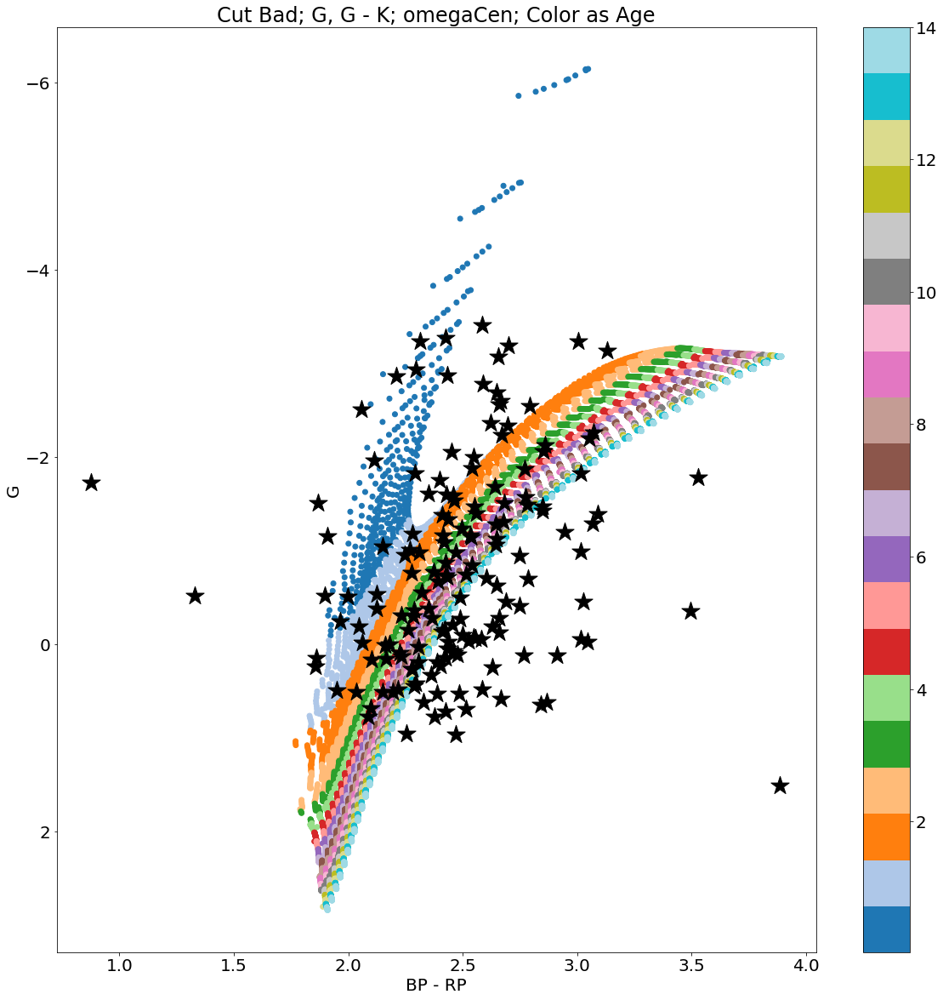

In [29]:
for i in range(len(gcs_clus)):
    clus = np.where((gcs['CLUSTER']==gcs_clus[i])&(gcs['GAIA_A_G_VAL']!=-9999.0))
    isopick = np.where(massive['MH']==closest(massive['MH'],np.nanmedian(gcs['M_H'][clus])+
                                              np.log10(0.638*(10**np.nanmedian(gcs['ALPHA_M'][clus]))+0.362)))
    
    plt.figure(figsize=[20,20])
    plt.scatter((massive['G_BPmag']-massive['Ksmag'])[isopick],massive['Gmag'][isopick],
                c=10**massive['logAge'][isopick]/10**9,cmap='tab20',zorder=0)
    plt.colorbar()
    plt.scatter((gcs['GAIA_PHOT_BP_MEAN_MAG']-gcs['K']-egk_ak*gcs['AK_TARG'])[clus],
                (gcs['GAIA_PHOT_G_MEAN_MAG']-gcs['GAIA_A_G_VAL']-5*np.log10(harris[i]*1000)+5)[clus],c='k',
                marker='*',s=500,zorder=2)
    plt.gca().invert_yaxis()
    plt.xlabel(r'BP - RP')
    plt.ylabel(r'G')
    plt.title(r'Cut Bad; G, G - K; {}; Color as Age'.format(gcs_clus[i]))
    plt.show()